In [1]:
%matplotlib widget

import sys
import os

sys.path.insert(1, os.path.join(sys.path[0], '..'))

from datetime import datetime, timedelta
from pathlib import Path

import copy
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

import json

import warnings

from loader import Loader
lo = Loader()

from analyzer import Analyzer

from utils import _parse_template, save_figures

# Load Files 

In [2]:
json_timestamp_fnct = lambda x: datetime.strptime(x, '%Y%m%dT%H%M%S')
#json_timestamp_fnct = lambda x: datetime.strptime(x, '%Y%m%d_%H%M%S')
#csv_timestamp_fnct = lambda x: datetime.strptime(x, '%d.%m.%Y %H_%M_%S')
csv_timestamp_fnct = lambda x: datetime.strptime(x, '%m_%d_%Y %I_%M_%S %p')
h5_timestamp_fnct = lambda x: datetime.strptime(x, '%Y%m%d_%H%M%S')

parse_timestamp = True

attr_pattern_specs = {}
if parse_timestamp:
    attr_pattern_specs = {'timestamp':{'start':['^', '; ', '^'],
                                       'end':['_[^0-9]', ']', '_[^0-9]'],
                                       'trans_fnct': [json_timestamp_fnct, csv_timestamp_fnct, h5_timestamp_fnct],
                                       'must_contain': ['.json', '.csv', '.h5']
                                       }
                         }


In [3]:
# ============================= User input =============================
# Directory containing the measurement files

root = Path(r'/baltic/users/optolabdata/Experiments/ChristophWeilenmann')
#root = Path(r'Z:/Experiments/ChristophWeilenmann')
directory = root / Path(r'2024-04-23_cleansweep_5_before_anneal/')
directory = root / Path(r'2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/')

#directory = root / Path(r'2023-07-13_tests')


print(directory)

# Specify a pattern that the filename must contain. Only filenames containing the pattern will be loaded
must_contain = None
#must_contain = '(d1x1|d7x1|d8x1|d2x2|d7x2|d2x3|d2x4|d4x4|d10x4)'
#must_contain = ['P=\w{1,3}_']
#must_contain = '.json'
escape = False                           # must be False if pattern is a regex

# Specify metadata attributes to be read out of filename. 
# The attribute name will be set to the dictionary key (e.g. meas_name)
# The attribute value will be set to the string between the two patterns
user_attr_patterns = {'meas_name': {'start': '_', 'end': '\.'},
                      'chip': {'start': '(cleansweep_\d)', 'end': ''},
                     'cluster': {'start': '(c\d+x\d+)', 'end': '_'},
                     'device': {'start': '(d\d+x\d+)', 'end': '\.'},
                      'ambient':{'start': '(dark|light)', 'end': '_'},
                      'T':{'start': 'T=(\d+)', 'end': ''},
                      'P365':{'start': 'P365=(\d+)', 'end': ''}
                    }


# Example Regex: 'P=\w{1,3}_' (matches patterns: 'P=on_', 'P=0_', 'P=off_', 'P=170')
# Example Regex: 'd\d+x\d+_' (matches pattern: 'd10023x2346_')
# Example Regex: '_(?!(no|UV))' (matches patterns: '_lksjdflj' but not '_no' or '_UV')
# =====================================================================

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement


In [4]:
attr_pattern_specs.update(user_attr_patterns)

lo.load_files(directory, must_contain=must_contain, attr_pattern_specs=attr_pattern_specs, escape=escape)

lo.print_files();

,filename,timestamp,meas_name,chip,cluster,device,ambient,T,P365
0,20240425_165550_AWG_Test_cleansweep_5_c3x4_d4x1_dark_T=25_P365=0.2_no_50Ohm_terminator.h5,2024-04-25 16:55:50,165550_AWG_Test_cleansweep_5_c3x4_d4x1_dark_T=25_P365=0,cleansweep_5,c3x4,d4x1,dark,25,0
1,20240502_181117_AWG_Test_cleansweep_5_c3x4_d9x3_dark_T=25_P365=0.2_no_50Ohm_terminator.h5,2024-05-02 18:11:17,181117_AWG_Test_cleansweep_5_c3x4_d9x3_dark_T=25_P365=0,cleansweep_5,c3x4,d9x3,dark,25,0


## Rename 

In [5]:
# rename_selection_generated = {}
# for i in range(0,47):
#     filename = lo.files[i]['filename']
#     new_filename = filename.replace('d14x4', 'd11x4')
#     #new_filename = new_filename.replace('c1x1', 'c1x4')
#     rename_selection_generated[i] = new_filename
    
# display(rename_selection_generated)


In [6]:
# # ============================= User input ============================= 
# rename_selection = \
# {
#     42: '20220923T150602_cleansweep_4_dark_T=25_c2x1_d4x2.json',
#     43: '20220923T150654_cleansweep_4_dark_T=25_c2x1_d4x2.json',
# }

# rename_selection = rename_selection_generated

# # ====================================================================== 

# lo.rename_files(rename_selection)
# lo.load_files(directory, must_contain=must_contain, attr_pattern_specs=attr_pattern_specs, escape=escape)

# Load Data

In [7]:
lo.load_raw_data()
an = Analyzer(lo, None)

default_meas_type_dict = {'IV': {'x':'Source', 'y':'Current'}, 'RV': {'x':'Source', 'y':'Resistance'},
                          'GV': {'x':'Source', 'y':'Conductance'}, 'JV': {'x':'Source', 'y':'Current Density'}, 
                          'G-t': {'x':'Time', 'y':'Conductance'}, 'J-t': {'x':'Time', 'y':'Current Density'},
                          'V-t': {'x':'Time', 'y':'Voltage'}, 'Source-t': {'x':'Time', 'y':'Source'}, 
                          'I-t': {'x':'Time', 'y':'Current'}, 'R-t': {'x':'Time', 'y':'Resistance'},
                          'P-t': {'x':'Time', 'y':['Power', 'P_avg_rolling', 'P_avg']}, 'ctml': {'x':'S', 'y': ['Resistance', 'R_corr']},
                          'gap_sweep':{'x':'Gap', 'y':'Resistance'}, 'E-t': {'x':'Time', 'y':'Energy'}, 'V_max-G': {'x':'V_max', 'y':'Conductance'}}

an.set_meas_type_dict(default_meas_type_dict)

default_axs_labels = {'Voltage': 'Applied Voltage [V]', 'Source': 'Measured Voltage [V]', 'Time': 'Time [s]', 
                      'Resistance': 'Resistance [ohm]', 'Conductance': 'Conductance [S]', 'Current': 'Current [A]', 
                      'Current Density': 'Current Density [A/cm^2]', 'S': 'gap [um]',
                      'Power': 'Power [W]', 'Gap': 'Gap [um]', 'Energy': 'Energy [J]', 'V_max': 'Pulse Voltage [V]'}

an.set_axs_labels(default_axs_labels)


default_title_template = '{meas_type}: {meas_name}, ({timestamp:%Y-%m-%d %H:%M:%S})'
default_legend_template = '{y_axis}'

default_plot_parameters = {\
                           'plot_type': '',
                           'x_scale':'linear',
                           'y_scale':'linear',
                           'x_lim': (),
                           'y_lim': (),
                           'title_template':default_title_template,
                           'legend_template':default_legend_template,
                           'x_scale_fn': None,
                           'y_scale_fn': None,
                           'plot_settings': {'linewidth': 2},
                           'grid': True,
                          }

# RESET Data 

In [8]:
# selection = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144]

# selection_to_remove = [k for k in an.measurements.keys() if k not in selection]


In [9]:
# for k in selection_to_remove:
#     an.measurements.pop(k, None)

# Clean All Data 

## Remove 0

In [10]:
# Can remove a measurement if no data left
# an.rm_zero(thr=5e-2)

## Set Start Time to 0

In [11]:
all_measurements = list(an.measurements.keys())
selection = an.set_selection(all_measurements) 
value = 0
an.set_start_time_to_value_selection(value)

True

## Calc conductance 

In [12]:
all_measurements = list(an.measurements.keys())
selection = an.set_selection(all_measurements) 
an.calc_conductance(calc_resistance=False, v_app=0, two_channels=False)

True

# Add custom Attributes 

In [13]:
all_measurements = list(an.measurements.keys())
selection = an.set_selection(all_measurements) 
#an.print_measurements(selection=selection)

In [14]:
# ============= Add Voltage at beginning of measurement as attribute ============

attr_map = {}
attr_map['V0'] = []
attr_map['V'] = []
attr_map['V_read'] = []
attr_map['idx'] = []

for idx in selection:
    attr_map['idx'].append(idx)

    data = an.measurements[idx]['data']
    
    try:
        metadata = an.measurements[idx]['metadata']
        attr_map['V'].append(metadata['source_parameters']['AWG-5064']['CH1']['V'])
    except KeyError:
        attr_map['V'].append(None)

    try:
        metadata = an.measurements[idx]['metadata']
        attr_map['V_read'].append(metadata['source_parameters']['AWG-5064']['CH1']['read_V'])
    except KeyError:
        attr_map['V_read'].append(None)
        
    try:
        attr_map['V0'].append(np.round(data['Voltage'].iloc[1], decimals=1)) 
    except IndexError :
        attr_map['V0'].append(None)

        
an.add_attributes_to_selection(attr_map)


[array([-0.8,  0.8,  3. , -0.8,  0.8,  4. , -0.8,  0.8,  5. , -0.8,  0.8,
        0.8, -0.8, -0.8,  0.8,  3. , -0.8,  0.8,  4. , -0.8,  0.8,  5. ,
       -0.8,  0.8,  0.8, -0.8, -0.8,  0.8,  3. , -0.8,  0.8,  4. , -0.8,
        0.8,  5. , -0.8,  0.8,  0.8, -0.8,  0.8,  0.8,  3. ,  0.8,  0.8,
        4. ,  0.8,  0.8,  5. ,  0.8,  0.8,  0.8,  0.8,  0.8,  0.8,  3. ,
        0.8,  0.8,  4. ,  0.8,  0.8,  5. ,  0.8,  0.8,  0.8,  0.8,  0.8,
        0.8,  3. ,  0.8,  0.8,  4. ,  0.8,  0.8,  5. ,  0.8,  0.8,  0.8,
        0.8, -0.4,  0.8,  3. , -0.4,  0.8,  4. , -0.4,  0.8,  5. , -0.4,
        0.8,  0.8, -0.4, -0.4,  0.8,  3. , -0.4,  0.8,  4. , -0.4,  0.8,
        5. , -0.4,  0.8,  0.8, -0.4, -0.4,  0.8,  3. , -0.4,  0.8,  4. ,
       -0.4,  0.8,  5. , -0.4,  0.8,  0.8, -0.4,  0.4,  0.8,  3. ,  0.4,
        0.8,  4. ,  0.4,  0.8,  5. ,  0.4,  0.8,  0.8,  0.4,  0.4,  0.8,
        3. ,  0.4,  0.8,  4. ,  0.4,  0.8,  5. ,  0.4,  0.8,  0.8,  0.4,
        0.4,  0.8,  3. ,  0.4,  0.8,  4. ,  0.4,  

# Show All Measurements

In [15]:
only_ch2 = [m for m in all_measurements if type(m) is int]
sel = all_measurements
#sel = only_ch2

printed_measurements = an.print_measurements(selection=sel, exclude_keys=['data', 'metadata', 'V', 'V_read'])

,timestamp,meas_name,chip,cluster,device,ambient,T,P365,V0,idx
0,2024-04-25 16:55:50,165550_AWG_Test_cleansweep_5_c3x4_d4x1_dark_T=25_P365=0,cleansweep_5,c3x4,d4x1,dark,25,0,-0.0,0
1,2024-05-02 18:11:17,181117_AWG_Test_cleansweep_5_c3x4_d9x3_dark_T=25_P365=0,cleansweep_5,c3x4,d9x3,dark,25,0,-0.0,1


# Manipulate Selection

In [16]:
selection_to_manipulate = [0,1]
print(selection_to_manipulate)

[0, 1]


In [17]:
if not hasattr(an, 'manipulated_selections'):
    an.manipulated_selections = {}
an.manipulated_selections['normal'] = {k:[k] for k in selection_to_manipulate}

### Pick Points Trigger

In [18]:
sel = selection_to_manipulate
act_on_selections = 'normal'

In [19]:
if not 'triggered_normal_selections' in an.manipulated_selections:
    an.manipulated_selections['triggered_normal_selections'] = {}
    
skip_known = False

In [20]:
tr_level = {0:0.78, 1:1.18}

n_points_per_pulse = 1
n_points_before_pulse_end = 2
active_edge = 'falling'
fill_above_trigger_level_points = 100

In [21]:
triggered_selections = {}
for s in sel:
    if skip_known and (s in an.manipulated_selections['triggered_normal_selections']):
        continue
    
    act_sel = an.manipulated_selections[act_on_selections][s]
    try:
        trigger_level = tr_level[s]
    except Exception:
        an.manipulated_selections['triggered_normal_selections'][s] = act_sel
        continue

    an.set_selection(act_sel)
    an.manipulated_selections['triggered_normal_selections'][s] = an.pick_points_trigger(trigger_level, n_points_per_pulse=n_points_per_pulse, n_points_before_pulse_end=n_points_before_pulse_end, 
                                                                                  active_edge=active_edge, fill_above_trigger_level_points=fill_above_trigger_level_points, appendix='trig_norm')
    #an.manipulated_selections['triggered_selections'][s], mask, mask_above_trigger_level = pick_points_trigger_new(trigger_level, n_points_per_pulse=n_points_per_pulse, n_points_before_pulse_end=n_points_before_pulse_end, 
    #                                                                                                               active_edge=active_edge, fill_above_trigger_level_points=fill_above_trigger_level_points)
    
#print(an.manipulated_selections['triggered_selections'])

# Plot Selection

In [22]:
selection = selection_to_manipulate

chosen_sel = 'normal'
#chosen_sel = 'triggered_normal_selections'

In [23]:
plot_selection = []

for idx in selection:
    man_sel = an.manipulated_selections[chosen_sel][idx]
    plot_selection += man_sel

In [24]:
print(plot_selection)

[0, 1]


### Plot Setup 

In [25]:
# Data Range
interleave = 100

xlim=[250, 260]
xlim = []

y_factor = 1e9

In [26]:
# Plot Design
figsize = (8,6)

figsize_factor = 0.5

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,4,0,1,2,4,0,1,2,4]
    #mapping = None
    if mapping is None or int(i) not in mapping:
        return cmap(int(i)%10)
    elif type(mapping[int(i)]) is int:     
        return cmap(mapping[int(i)])
    else:
        return mapping[int(i)]

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

In [27]:
# Labels
no_labels = False

title_template = '{cluster} {device}'
#title_template = 'DC'

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}


legend_template = '{idx}: {cluster} {device} ({timestamp:%H:%M})'

legend_labels = []

max_legend_entries = None

#legend_pos = 'outside'
legend_pos = 'best'
#legend_pos = 'upper right'


In [28]:
# Figure specification
figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array(xlim),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    
]   

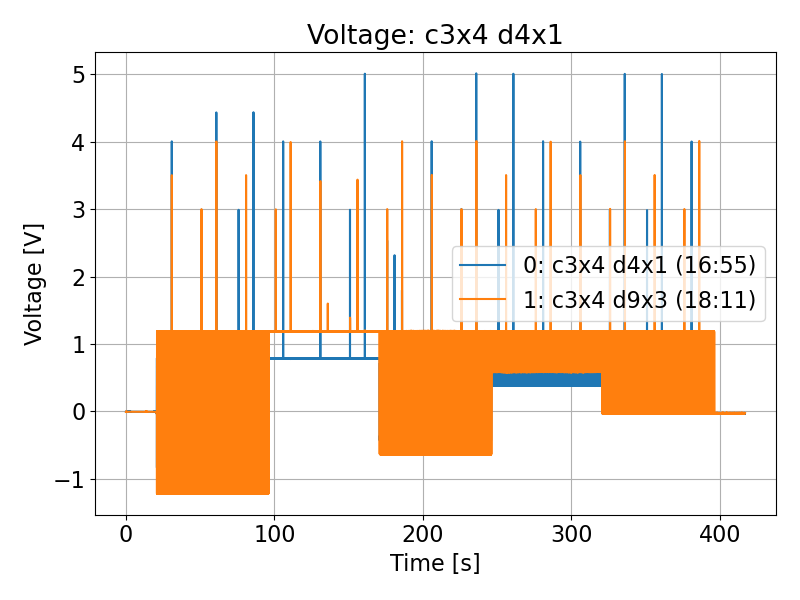

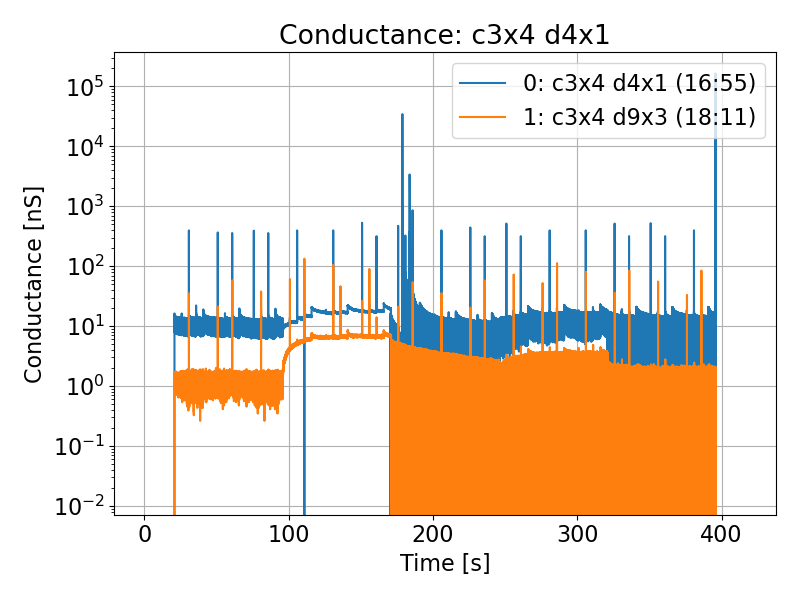

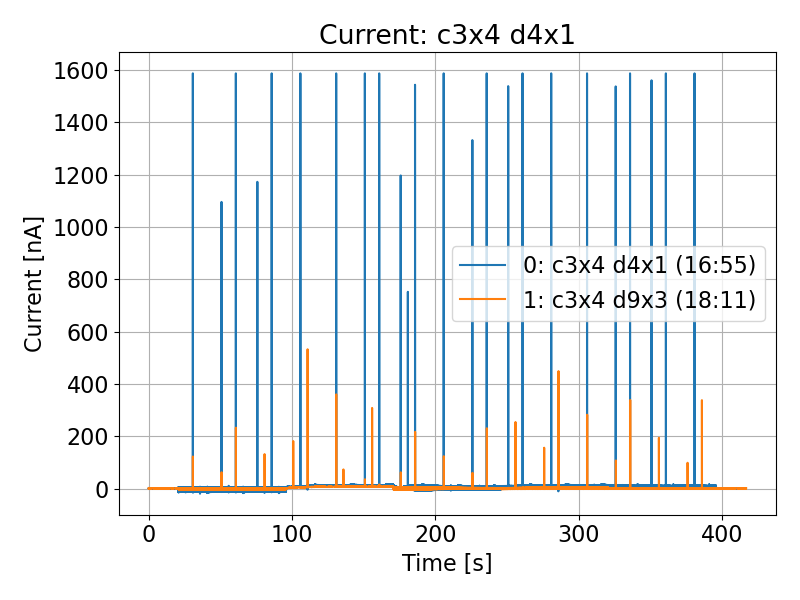

In [29]:
plt.close('all')

figures = []
figure_names = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        if spec['no_labels']:
            fig, axs = plt.subplots(1,1, figsize=figsize)
        else:
            fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data'].iloc[::interleave]      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            if max_legend_entries is None or i < max_legend_entries:
                label = _parse_template(m, spec['legend_template'])
            else:
                label = '_no_label_'
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);


        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])

        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))


        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        figure_names.append(name)
        if not spec['no_labels']:
            legend_kwargs = {}
            if legend_pos == 'outside':
                legend_kwargs['bbox_to_anchor'] = (1,1)
                legend_kwargs['loc'] = 'upper left'
            else:
                legend_kwargs['loc'] = legend_pos
            
            if legend_labels:
                axs.legend(legend_labels, **legend_kwargs)
            else:
                axs.legend(**legend_kwargs)
                
            axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
            axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
            axs.set_title(name)
            axs.grid()

        
       
        
        fig.tight_layout()
        figures.append(fig)

### Save figures 

In [38]:
savenames = figure_names
subdirectory = 'clean'
save_figures(figures, figure_specs, savenames, directory, subdirectory=subdirectory, filetype='pdf')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_c3x4_d4x1
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r] / rename all [rr]:
Not saving any measurements
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_c3x4_d4x1_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Current_c3x4_d4x1


# Split Selection 

In [192]:
# Get timestamps at the falling edge of the voltage pulses > 1.2V
selection = selection_to_manipulate
an.set_selection(selection)

split_timestamps = an.pick_timestamps_trigger('Voltage', 1.2, timestamp_offset=-4e-3, n_points_before_pulse_end=0, n_points_per_pulse=1, active_edge='falling')
#print(split_timestamps)


In [193]:
# Add timestamps manually (for example the time of the falling edge of the UV pulse)

idces_to_mod = selection_to_manipulate
t_stamps = {k:v for k,v in split_timestamps.items() if k in idces_to_mod}

t_stamps_mod = {k:[] for k in idces_to_mod}

for idx, stamps in t_stamps.items():
    for i, stamp in enumerate(stamps):
        t_stamps_mod[idx].append(stamp)
        if (i+1)%3 == 0:
            t_stamps_mod[idx].append(stamp+5.001)
   
# display(t_stamps_mod)



In [194]:
# Split selection

if not 'split_selections' in an.manipulated_selections:
    an.manipulated_selections['split_selections'] = {}
    
skip_known = False

In [195]:
split_points = split_timestamps
split_points = t_stamps_mod

col = 'Time'

add_labels = {}

overlap = 0
split_on_change = False
start_value = 0

if split_on_change:
    assert col != 'Time'

for sel,s in split_points.items():
    if skip_known and (sel in an.manipulated_selections['split_selections']):
        continue
    an.set_selection([sel])
    selection_split = an.split_selection(col, split_points, overlap=overlap, start_value=start_value, add_labels=add_labels)
    an.manipulated_selections['split_selections'][sel] = selection_split
    
#display(selection_split)

In [215]:
len(an.measurements['0_split_1']['V_read'])

195

In [278]:
# Add custom attributes
attributes = {}

V_biases = [-0.8]*13 + [0.8]*12 + [-0.4]*12 + [0.4]*12 + [0]*12
V_pulses = [0.8] + [3, 4, 5, 'UV']*3*5

attributes[0] = {
    'V_bias': V_biases,
    'V_pulse': V_pulses
}

V_biases = [-1.2]*13 + [1.2]*12 + [-0.6]*12 + [0.6]*12 + [0]*12
V_pulses = [1.2] + [3, 4, 5, 'UV']*3*5

attributes[1] = {
    'V_bias': V_biases,
    'V_pulse': V_pulses
}

        
    

In [279]:
print(len(V_biases))
print(len(V_pulses))

61
61


In [280]:
for idx in selection:
    split_sel = an.manipulated_selections['split_selections'][idx]
    for i, split_idx in enumerate(split_sel):
        m = an.measurements[split_idx]
        m['V_bias'] = attributes[idx]['V_bias'][i]
        m['V_pulse'] = attributes[idx]['V_pulse'][i]
        m['idx'] = split_idx

# Plot Split Measurement

In [281]:
selection = [0]

chosen_sel = 'normal'
chosen_sel = 'split_selections'

In [282]:
split_idces = list(range(1, 13)) # All pulses bias -0.8
# split_idces = list(range(13, 25)) # All pulses bias 0.8
# split_idces = list(range(25, 37)) # All pulses bias -0.4
#split_idces = list(range(37, 49)) # All pulses bias 0.4
#split_idces = list(range(49, 61)) # All pulses bias 0

plot_selection = []

for idx in selection:
    man_sel = an.manipulated_selections[chosen_sel][idx]
    if chosen_sel != 'normal':
        man_sel = [s for i,s in enumerate(man_sel) if i in split_idces]
        
    plot_selection += man_sel

In [283]:
print(plot_selection)

['0_split_1', '0_split_2', '0_split_3', '0_split_4', '0_split_5', '0_split_6', '0_split_7', '0_split_8', '0_split_9', '0_split_10', '0_split_11', '0_split_12']


### Plot Setup 

In [284]:
# Data Range
interleave = 1

xlim = [0, 0.04]

y_factor = 1e9

In [285]:
# Plot Design
figsize = (8,6)

figsize_factor = 0.5

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,4,0,1,2,4,0,1,2,4]
    #mapping = None
    if mapping is None or int(i) >= len(mapping):
        return cmap(int(i)%10)
    elif type(mapping[int(i)]) is int:     
        return cmap(mapping[int(i)])
    else:
        return mapping[int(i)]

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

In [286]:
# Labels
no_labels = False

title_template = 'Split {cluster} {device} (V_bias = {V_bias}V)'
#title_template = 'DC'

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}


legend_template = 'V_pulse = {V_pulse} ({timestamp:%H:%M})'

max_legend_entries = 4

legend_labels = []

legend_pos = 'outside'
#legend_pos = 'best'
#legend_pos = 'upper right'

In [287]:
# Figure specification
figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
    {
        'title': 'Voltage Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array(xlim),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
]   

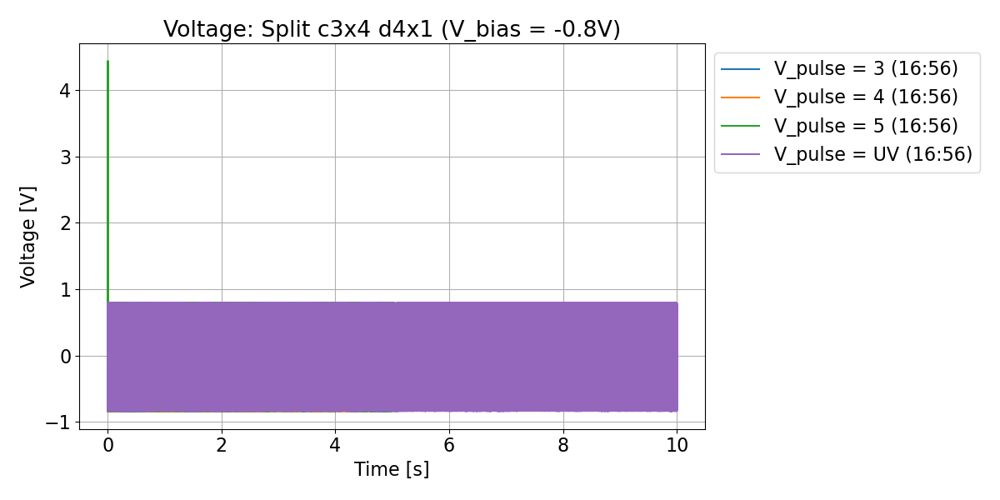

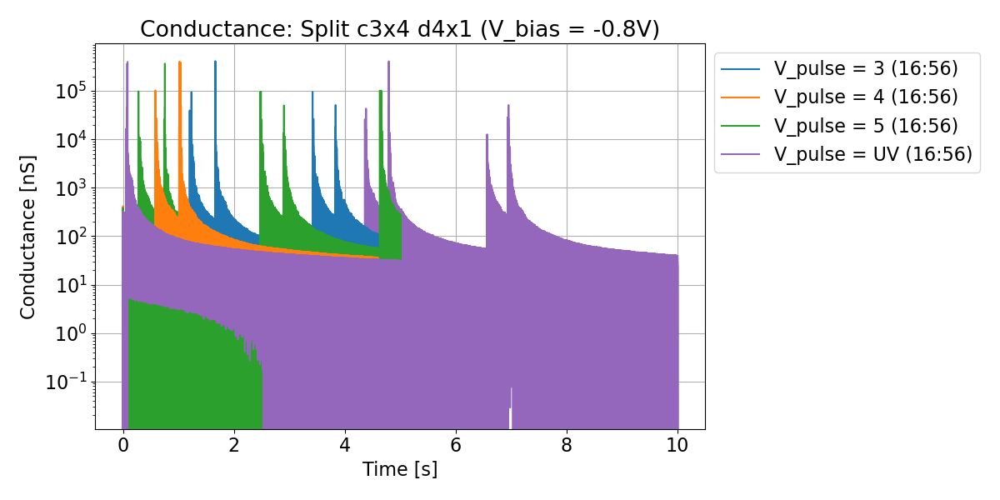

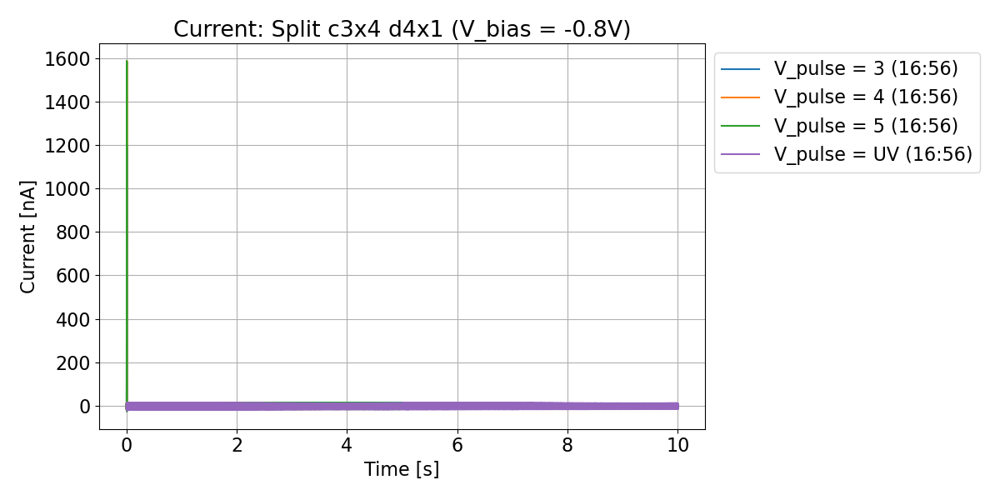

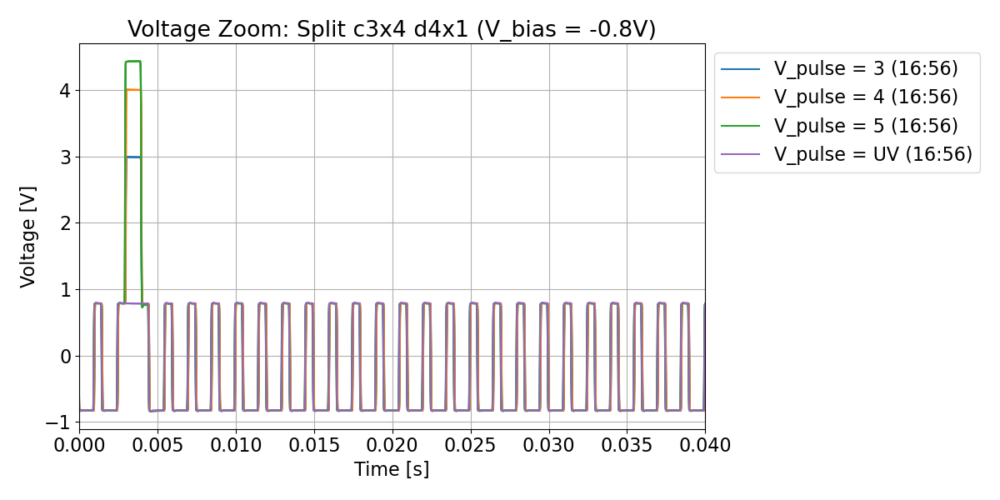

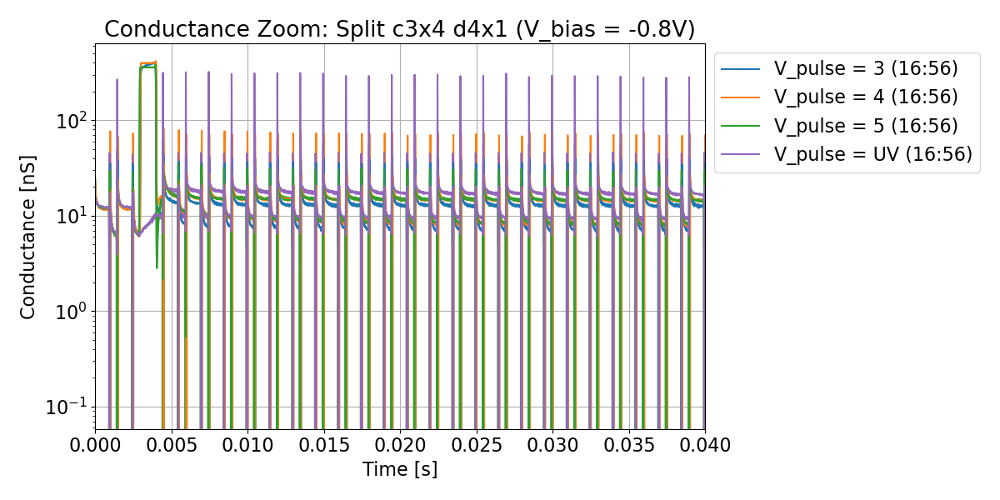

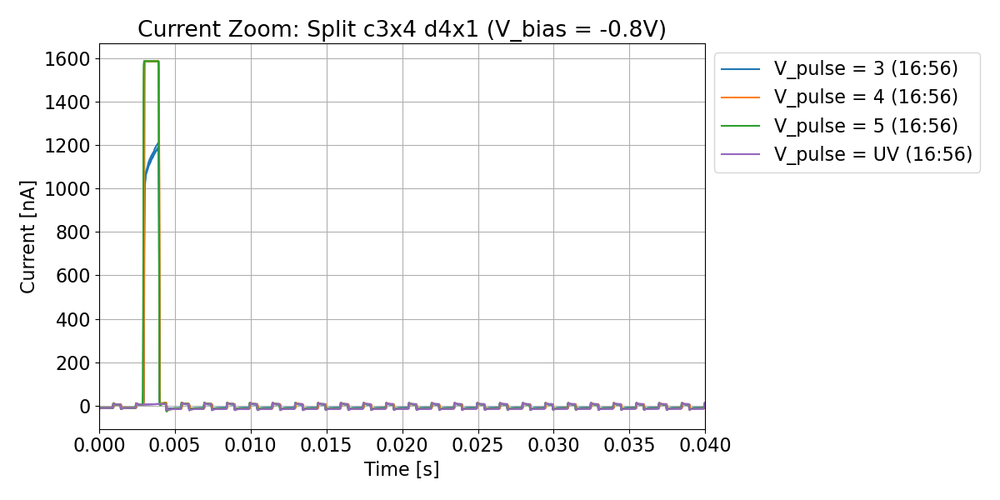

In [288]:
plt.close('all')

figures = []
figure_names = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        if spec['no_labels']:
            fig, axs = plt.subplots(1,1, figsize=figsize)
        else:
            fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data'].iloc[::interleave]      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            if max_legend_entries is None or i < max_legend_entries:
                label = _parse_template(m, spec['legend_template'])
            else:
                label = '_no_label_'
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);


        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])

        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))


        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        figure_names.append(name)
        if not spec['no_labels']:
            legend_kwargs = {}
            if legend_pos == 'outside':
                legend_kwargs['bbox_to_anchor'] = (1,1)
                legend_kwargs['loc'] = 'upper left'
            else:
                legend_kwargs['loc'] = legend_pos
            
            if legend_labels:
                axs.legend(legend_labels, **legend_kwargs)
            else:
                axs.legend(**legend_kwargs)
                
            axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
            axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
            axs.set_title(name)
            axs.grid()

        
       
        
        fig.tight_layout()
        figures.append(fig)

### Save figures 

In [94]:
savenames = figure_names
subdirectory = 'clean'
save_figures(figures, figure_specs, savenames, directory, subdirectory=subdirectory, filetype='pdf')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Split_c3x4_d4x1_V_bias_=_-0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Split_c3x4_d4x1_V_bias_=_-0_8V_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Current_Split_c3x4_d4x1_V_bias_=_-0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Zoom_Split_c3x4_d4x1_V_bias_=_-0_8V_x=0E+00_to_4E-02
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Zoom_Split_c3x4_d4x1_V_bias_=_-0_8V_ylog_x=0E+00_to_4E-02
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short

# Manipulate Split Selection

In [289]:
selection = selection_to_manipulate
#selection = [42]


### Pick Points Trigger

In [290]:
sel = selection
act_on_selections = 'split_selections'
#act_on_selections = 'normal'

In [291]:
if not 'triggered_selections' in an.manipulated_selections:
    an.manipulated_selections['triggered_selections'] = {}
    
skip_known = False

In [292]:
#tr_level = 0.78
tr_level = {0:0.78, 1:1.18}

n_points_per_pulse = 1
n_points_before_pulse_end = 2
active_edge = 'falling'
fill_above_trigger_level_points = 100

In [293]:
triggered_selections = {}
for s in sel:
    if skip_known and (s in an.manipulated_selections['triggered_selections']):
        continue
    
    act_sel = an.manipulated_selections[act_on_selections][s]
    try:
        trigger_level = tr_level[s]
    except Exception:
        an.manipulated_selections['triggered_selections'][s] = act_sel
        continue

    an.set_selection(act_sel)
    an.manipulated_selections['triggered_selections'][s] = an.pick_points_trigger(trigger_level, n_points_per_pulse=n_points_per_pulse, n_points_before_pulse_end=n_points_before_pulse_end, 
                                                                                  active_edge=active_edge, fill_above_trigger_level_points=fill_above_trigger_level_points)
    


In [294]:
print(an.manipulated_selections['triggered_selections'])

{0: ['0_split_0_trig', '0_split_1_trig', '0_split_2_trig', '0_split_3_trig', '0_split_4_trig', '0_split_5_trig', '0_split_6_trig', '0_split_7_trig', '0_split_8_trig', '0_split_9_trig', '0_split_10_trig', '0_split_11_trig', '0_split_12_trig', '0_split_13_trig', '0_split_14_trig', '0_split_15_trig', '0_split_16_trig', '0_split_17_trig', '0_split_18_trig', '0_split_19_trig', '0_split_20_trig', '0_split_21_trig', '0_split_22_trig', '0_split_23_trig', '0_split_24_trig', '0_split_25_trig', '0_split_26_trig', '0_split_27_trig', '0_split_28_trig', '0_split_29_trig', '0_split_30_trig', '0_split_31_trig', '0_split_32_trig', '0_split_33_trig', '0_split_34_trig', '0_split_35_trig', '0_split_36_trig', '0_split_37_trig', '0_split_38_trig', '0_split_39_trig', '0_split_40_trig', '0_split_41_trig', '0_split_42_trig', '0_split_43_trig', '0_split_44_trig', '0_split_45_trig', '0_split_46_trig', '0_split_47_trig', '0_split_48_trig', '0_split_49_trig', '0_split_50_trig', '0_split_51_trig', '0_split_52_trig'

### Pick Points 0.6V

In [295]:
# act_on_selections = 'split_selections'

In [296]:
# if not 'triggered_selections' in an.manipulated_selections:
#     an.manipulated_selections['triggered_selections'] = {}
    
# skip_known = False

In [297]:
# chosen_triggered_sel = 0
# appendix = 'pick_t'

# selection_pick_t = []
# for i, sel in enumerate(an.manipulated_selections['triggered_selections'][chosen_triggered_sel]):
#     if i == 0:
#         continue
#     timestamps = an.measurements[sel]['data']['Time']
#     idx_0_6 = an.manipulated_selections[act_on_selections][6][i]
#     m = copy.deepcopy(an.measurements[idx_0_6])
#     data_0_6 = m['data']
#     merged_df = pd.merge_asof(timestamps, data_0_6, on='Time', direction='nearest')
#     m['data'] = merged_df
#     new_idx_0_6 = f'{idx_0_6}_{appendix}'
#     print(new_idx_0_6)
#     an.measurements[new_idx_0_6] = m
#     selection_pick_t.append(new_idx_0_6)
    
# an.manipulated_selections['triggered_selections'][6] = selection_pick_t

### Moving Average

In [298]:
sel = selection
act_on_selections = 'triggered_selections'

In [299]:
if not 'mov_avg_selections' in an.manipulated_selections:
    an.manipulated_selections['mov_avg_selections'] = {}
    
skip_known = False

In [300]:
window = 10

mov_avg_selections = {}
for s in sel:
    if skip_known and (s in an.manipulated_selections['mov_avg_selections']):
        continue
     
    act_sel = an.manipulated_selections[act_on_selections][s]

    an.set_selection(act_sel)
    an.manipulated_selections['mov_avg_selections'][s] = an.moving_avg(['Conductance', 'Current'], window=window)

#print(mov_avg_selections)


### Scale Selection 

In [350]:
sel = selection
act_on_selections = 'triggered_selections'
#act_on_selections = 'mov_avg_selections'
#act_on_selections = 'cut_selections'

In [351]:
if not 'scaled_selections' in an.manipulated_selections:
    an.manipulated_selections['scaled_selections'] = {}
    
skip_known = False
scale_method = 'add'
set_G = 10e-9

In [352]:
scaled_selections = {}
for s in sel:
    if skip_known and (s in an.manipulated_selections['scaled_selections']):
        continue
        
    act_sel = an.manipulated_selections[act_on_selections][s]

    an.set_selection(act_sel)
    an.manipulated_selections['scaled_selections'][s] = an.scale_selection('Time', 'Conductance', [0, 1.5e-3], scale_method=scale_method, set_G=set_G)

#print(scaled_selections)


# Inspect Read Extraction

In [304]:
selection = selection
selection = [0]

chosen_sel_1 = 'split_selections'
chosen_sel_2 = 'triggered_selections'

In [305]:
choose_split = True
split_idces = [1]

# split_idces = list(range(1, 13)) # All pulses bias -0.8
# split_idces = list(range(13, 25)) # All pulses bias 0.8
# split_idces = list(range(25, 37)) # All pulses bias -0.4
# split_idces = list(range(37, 49)) # All pulses bias 0.4
# split_idces = list(range(49, 61)) # All pulses bias 0

plot_selection = []

for idx in selection:
    man_sel = an.manipulated_selections[chosen_sel_1][idx]
    if choose_split:
        man_sel = [s for i,s in enumerate(man_sel) if i in split_idces]
        
    plot_selection += man_sel

for idx in selection:
    man_sel = an.manipulated_selections[chosen_sel_2][idx]
    if choose_split:
        man_sel = [s for i,s in enumerate(man_sel) if i in split_idces]
        
    plot_selection += man_sel

In [306]:
print(plot_selection)

['0_split_1', '0_split_1_trig']


### Plot Setup 

In [307]:
# Data Range
interleave = 1

xlim = [0, 0.04]

y_factor = 1e9

In [308]:
# Plot Design
figsize = (8,6)

figsize_factor = 0.5

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,4,0,1,2,4,0,1,2,4]
    #mapping = None
    if mapping is None or int(i) >= len(mapping):
        return cmap(int(i)%10)
    elif type(mapping[int(i)]) is int:     
        return cmap(mapping[int(i)])
    else:
        return mapping[int(i)]

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

In [312]:
# Labels
no_labels = False

title_template = 'Split only Read {cluster} {device} (V_bias = {V_bias}V)'
#title_template = 'DC'

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}


legend_template = '{idx}'

legend_labels = []

max_legend_entries = 4

legend_pos = 'outside'
#legend_pos = 'best'
legend_pos = 'upper right'


In [313]:
# Figure specification
figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
    {
        'title': 'Voltage Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels,
        'plt_kwargs': {'marker':'o', 'markersize':4}
    },
    {
        'title': 'Conductance Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array(xlim),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels,
        'markers': True,
        'plt_kwargs': {'marker':'o', 'markersize':4}
    },
    {
        'title': 'Current Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels,
        'markers': True,
        'plt_kwargs': {'marker':'o', 'markersize':4}
    },    
]   

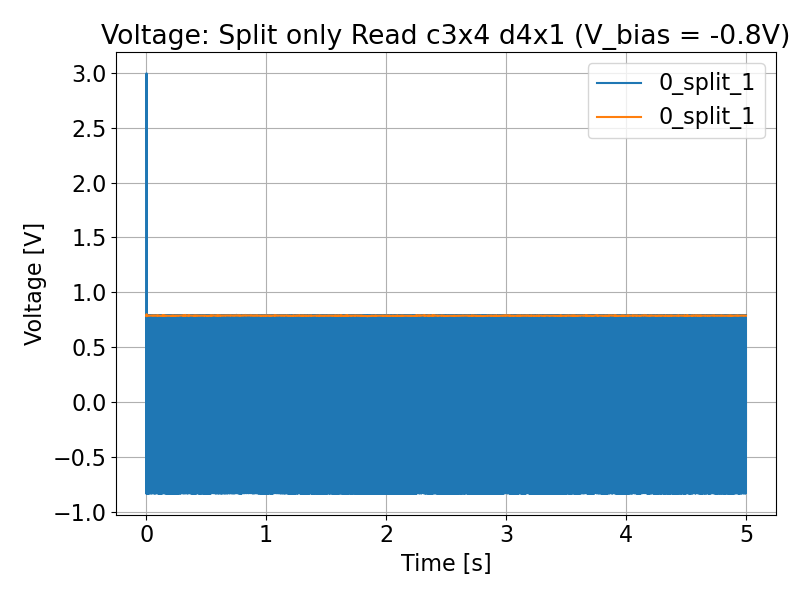

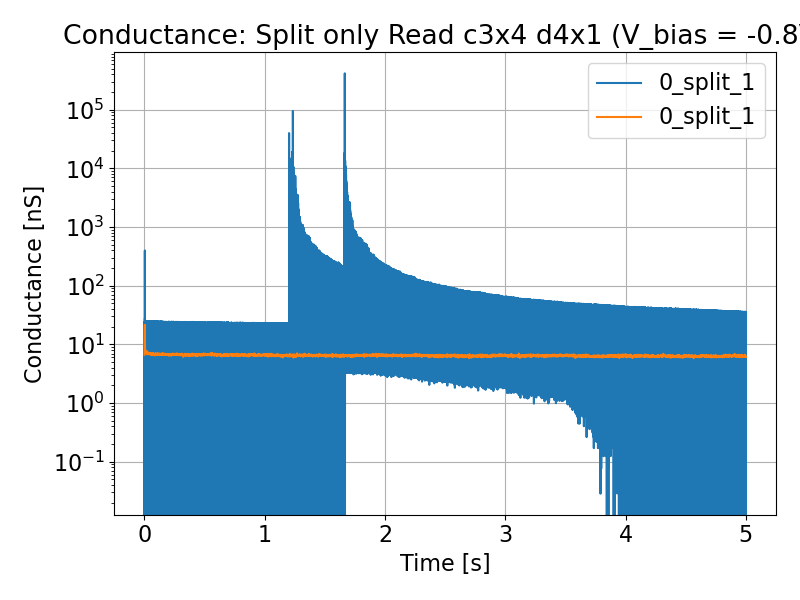

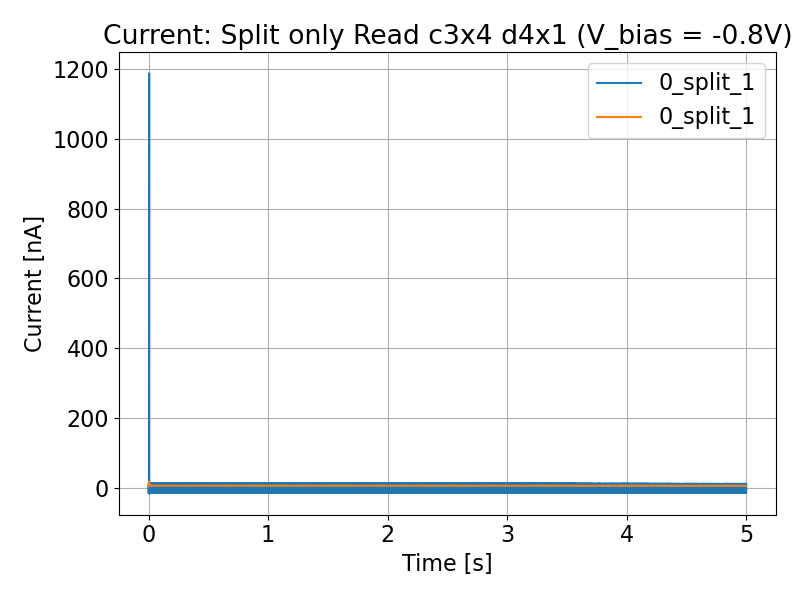

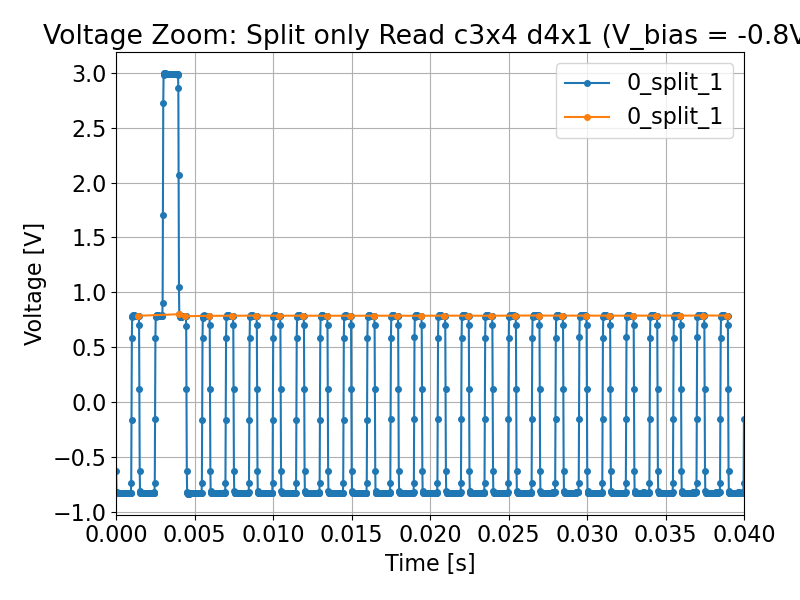

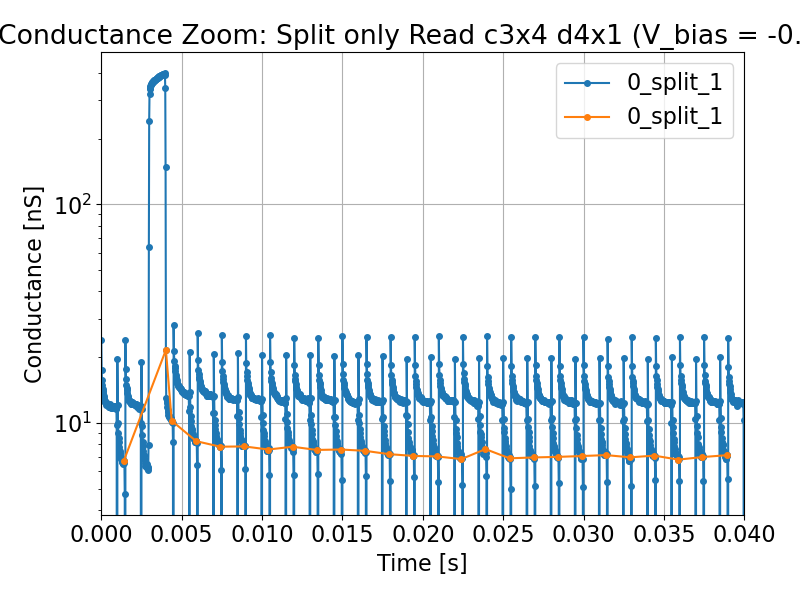

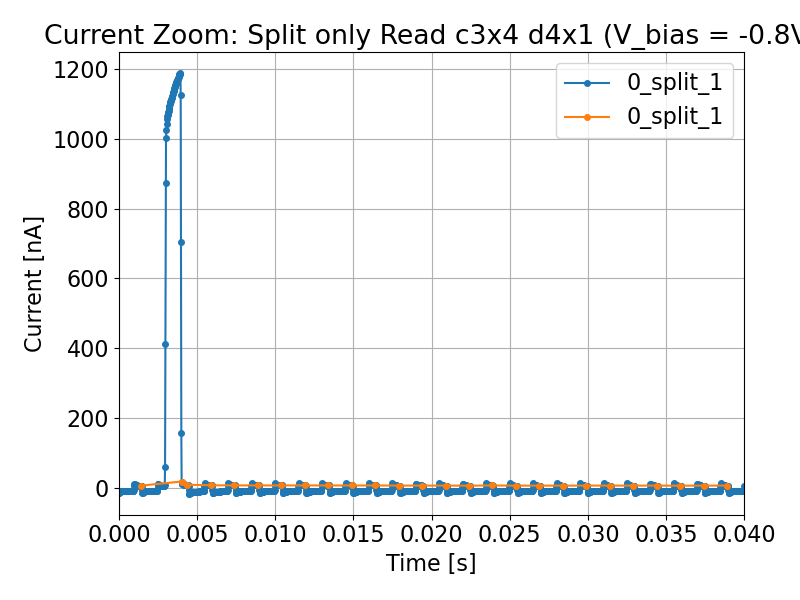

In [314]:
plt.close('all')

figures = []
figure_names = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        if spec['no_labels']:
            fig, axs = plt.subplots(1,1, figsize=figsize)
        else:
            fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data'].iloc[::interleave]      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]

            y_factor = spec['yfactor']

            color = color_map(cmap, i)

            if max_legend_entries is None or i < max_legend_entries:
                label = _parse_template(m, spec['legend_template'])
            else:
                label = '_no_label_'

            if 'plt_kwargs' in spec and spec['plt_kwargs']:
                plt_kwargs = spec['plt_kwargs']
            else:
                plt_kwargs = {}
            
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label, **plt_kwargs);


        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])

        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))


        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        figure_names.append(name)
        if not spec['no_labels']:
            legend_kwargs = {}
            if legend_pos == 'outside':
                legend_kwargs['bbox_to_anchor'] = (1,1)
                legend_kwargs['loc'] = 'upper left'
            else:
                legend_kwargs['loc'] = legend_pos
            
            if legend_labels:
                axs.legend(legend_labels, **legend_kwargs)
            else:
                axs.legend(**legend_kwargs)
                
            axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
            axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
            axs.set_title(name)
            axs.grid()

        
       
        
        fig.tight_layout()
        figures.append(fig)

### Save figures 

In [ ]:
savenames = figure_names
subdirectory = 'clean'
save_figures(figures, figure_specs, savenames, directory, subdirectory=subdirectory, filetype='pdf')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Split_only_Read_c3x4_d4x1_V_bias_=_0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Split_only_Read_c3x4_d4x1_V_bias_=_0_8V_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Current_Split_only_Read_c3x4_d4x1_V_bias_=_0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Zoom_Split_only_Read_c3x4_d4x1_V_bias_=_0_8V_x=0E+00_to_4E-02
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Zoom_Split_only_Read_c3x4_d4x1_V_bias_=_0_8V_ylog_x=0E+00_to_4E-02
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-

# Plot same bias only during Read

In [315]:
selection = selection
selection = [0]

chosen_sel = 'normal'
chosen_sel = 'split_selections'
chosen_sel = 'triggered_selections'
#chosen_sel = 'scaled_selections'
#chosen_sel = 'mov_avg_selections'

In [316]:
choose_split = True
split_idces = list(range(1, 13)) # All pulses bias -0.8
# split_idces = list(range(13, 25)) # All pulses bias 0.8
# split_idces = list(range(25, 37)) # All pulses bias -0.4
# split_idces = list(range(37, 49)) # All pulses bias 0.4
# split_idces = list(range(49, 61)) # All pulses bias 0

plot_selection = []

for idx in selection:
    man_sel = an.manipulated_selections[chosen_sel][idx]
    if choose_split:
        man_sel = [s for i,s in enumerate(man_sel) if i in split_idces]
        
    plot_selection += man_sel

In [317]:
print(plot_selection)

['0_split_1_trig', '0_split_2_trig', '0_split_3_trig', '0_split_4_trig', '0_split_5_trig', '0_split_6_trig', '0_split_7_trig', '0_split_8_trig', '0_split_9_trig', '0_split_10_trig', '0_split_11_trig', '0_split_12_trig']


### Plot Setup 

In [318]:
# Data Range
interleave = 1

xlim = [0, 0.04]

y_factor = 1e9

In [319]:
# Plot Design
figsize = (8,6)

figsize_factor = 0.5

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,4,0,1,2,4,0,1,2,4]
    #mapping = None
    if mapping is None or int(i) >= len(mapping):
        return cmap(int(i)%10)
    elif type(mapping[int(i)]) is int:     
        return cmap(mapping[int(i)])
    else:
        return mapping[int(i)]

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

In [320]:
# Labels
no_labels = False

title_template = 'Split only Read {cluster} {device} (V_bias = {V_bias}V)'
#title_template = 'DC'

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}


legend_template = 'V_pulse = {V_pulse}V ({timestamp:%H:%M})'

legend_labels = []

max_legend_entries = 4

legend_pos = 'outside'
#legend_pos = 'best'
#legend_pos = 'upper right'


In [321]:
# Figure specification
figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
    {
        'title': 'Voltage Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array(xlim),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
]   

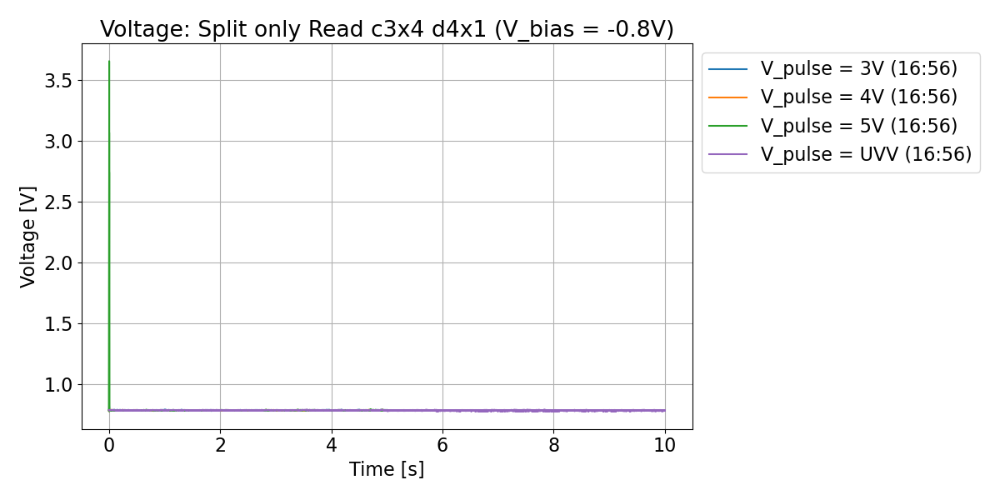

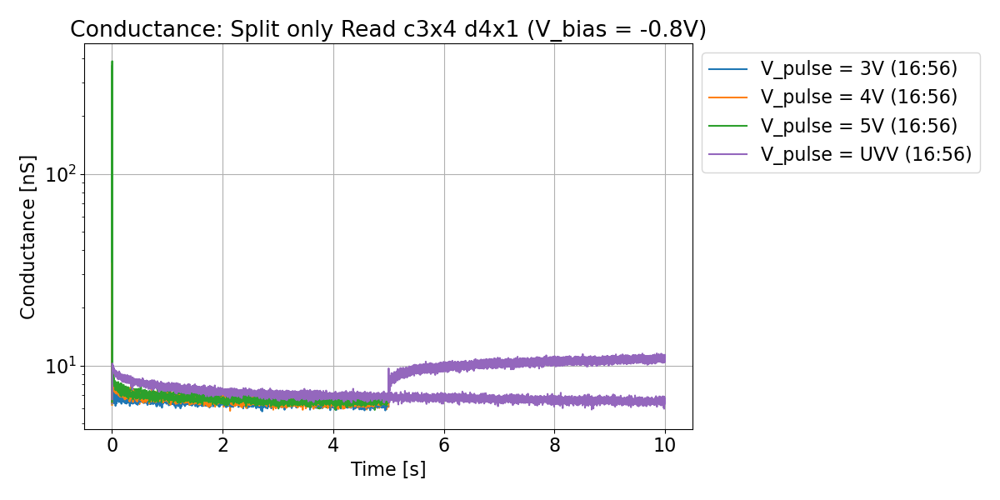

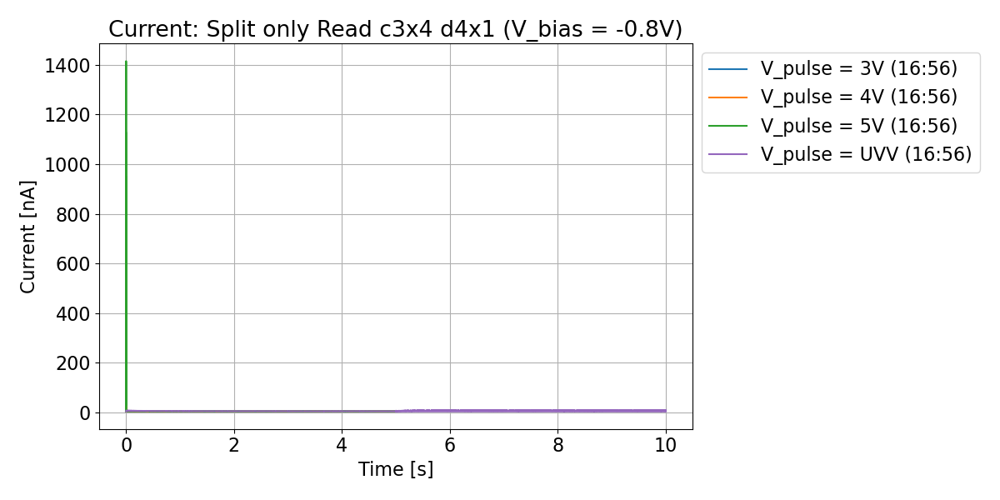

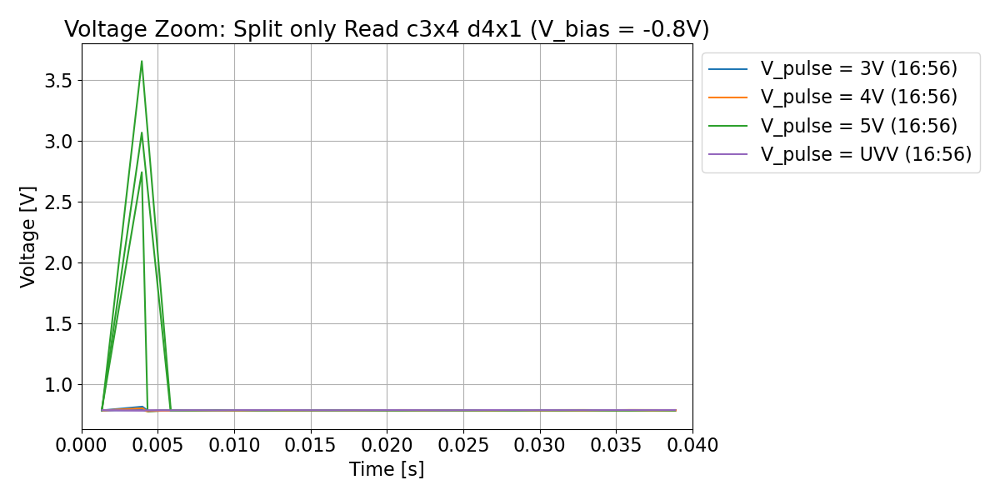

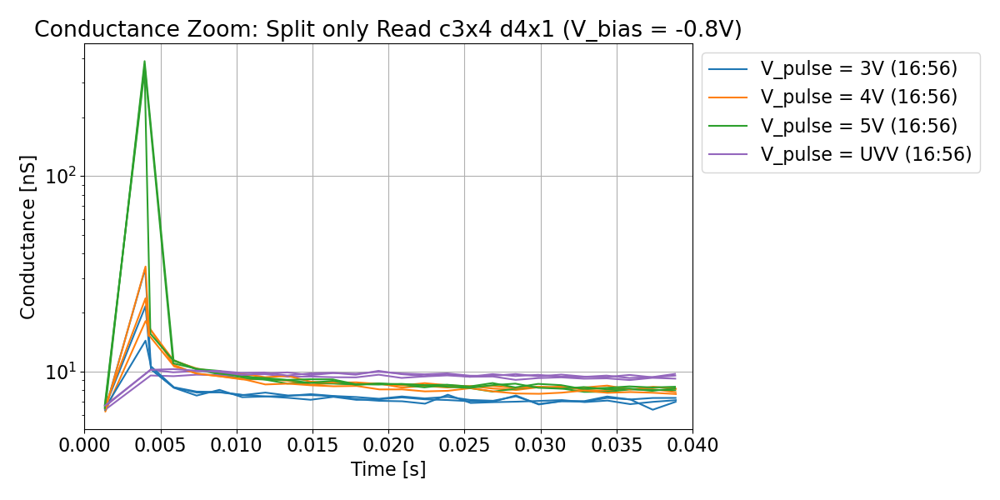

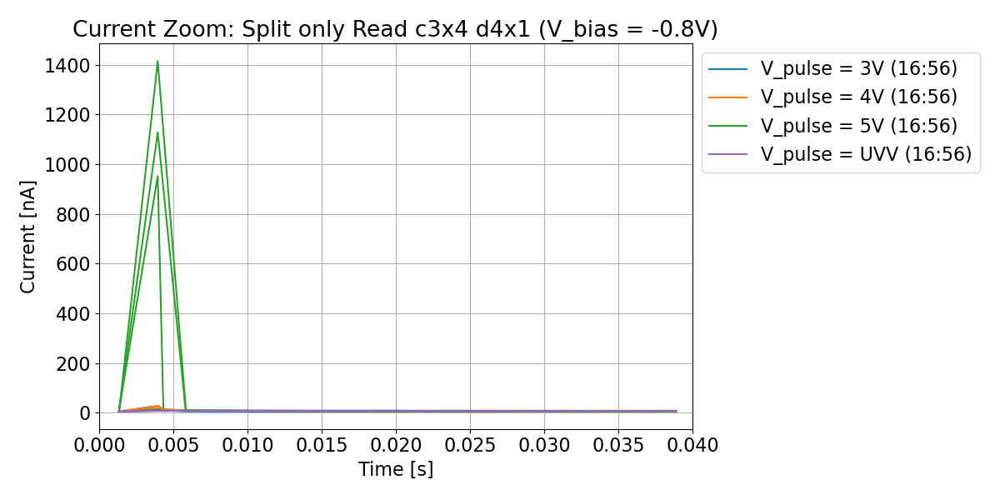

In [322]:
plt.close('all')

figures = []
figure_names = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        if spec['no_labels']:
            fig, axs = plt.subplots(1,1, figsize=figsize)
        else:
            fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data'].iloc[::interleave]      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            if max_legend_entries is None or i < max_legend_entries:
                label = _parse_template(m, spec['legend_template'])
            else:
                label = '_no_label_'
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);


        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])

        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))


        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        figure_names.append(name)
        if not spec['no_labels']:
            legend_kwargs = {}
            if legend_pos == 'outside':
                legend_kwargs['bbox_to_anchor'] = (1,1)
                legend_kwargs['loc'] = 'upper left'
            else:
                legend_kwargs['loc'] = legend_pos
            
            if legend_labels:
                axs.legend(legend_labels, **legend_kwargs)
            else:
                axs.legend(**legend_kwargs)
                
            axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
            axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
            axs.set_title(name)
            axs.grid()

        
       
        
        fig.tight_layout()
        figures.append(fig)

### Save figures 

In [182]:
savenames = figure_names
subdirectory = 'clean'
save_figures(figures, figure_specs, savenames, directory, subdirectory=subdirectory, filetype='pdf')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Split_only_Read_c3x4_d4x1_V_bias_=_0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Split_only_Read_c3x4_d4x1_V_bias_=_0_8V_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Current_Split_only_Read_c3x4_d4x1_V_bias_=_0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Zoom_Split_only_Read_c3x4_d4x1_V_bias_=_0_8V_x=0E+00_to_4E-02
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Zoom_Split_only_Read_c3x4_d4x1_V_bias_=_0_8V_ylog_x=0E+00_to_4E-02
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-

# Plot same bias only during Read and scaled

In [323]:
selection = selection
selection = [0]

chosen_sel = 'normal'
chosen_sel = 'split_selections'
chosen_sel = 'triggered_selections'
chosen_sel = 'scaled_selections'
#chosen_sel = 'mov_avg_selections'

In [324]:
choose_split = True
split_idces = list(range(1, 13)) # All pulses bias -0.8
# split_idces = list(range(13, 25)) # All pulses bias 0.8
# split_idces = list(range(25, 37)) # All pulses bias -0.4
# split_idces = list(range(37, 49)) # All pulses bias 0.4
# split_idces = list(range(49, 61)) # All pulses bias 0

plot_selection = []

for idx in selection:
    man_sel = an.manipulated_selections[chosen_sel][idx]
    if choose_split:
        man_sel = [s for i,s in enumerate(man_sel) if i in split_idces]
        
    plot_selection += man_sel

In [325]:
print(plot_selection)

['0_split_1_trig_scaled', '0_split_2_trig_scaled', '0_split_3_trig_scaled', '0_split_4_trig_scaled', '0_split_5_trig_scaled', '0_split_6_trig_scaled', '0_split_7_trig_scaled', '0_split_8_trig_scaled', '0_split_9_trig_scaled', '0_split_10_trig_scaled', '0_split_11_trig_scaled', '0_split_12_trig_scaled']


### Plot Setup 

In [326]:
# Data Range
interleave = 1

xlim = [0, 0.04]

y_factor = 1e9

In [327]:
# Plot Design
figsize = (8,6)

figsize_factor = 0.5

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,4,0,1,2,4,0,1,2,4]
    #mapping = None
    if mapping is None or int(i) >= len(mapping):
        return cmap(int(i)%10)
    elif type(mapping[int(i)]) is int:     
        return cmap(mapping[int(i)])
    else:
        return mapping[int(i)]

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

In [128]:
# Labels
no_labels = False

title_template = 'Split only Read, scaled {cluster} {device} (V_bias = {V_bias}V)'
#title_template = 'DC'

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}


legend_template = 'V_pulse = {V_pulse}V ({timestamp:%H:%M})'

legend_labels = []

max_legend_entries = 4

legend_pos = 'outside'
#legend_pos = 'best'
#legend_pos = 'upper right'



In [129]:
# Figure specification
figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
    {
        'title': 'Voltage Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array(xlim),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
]   

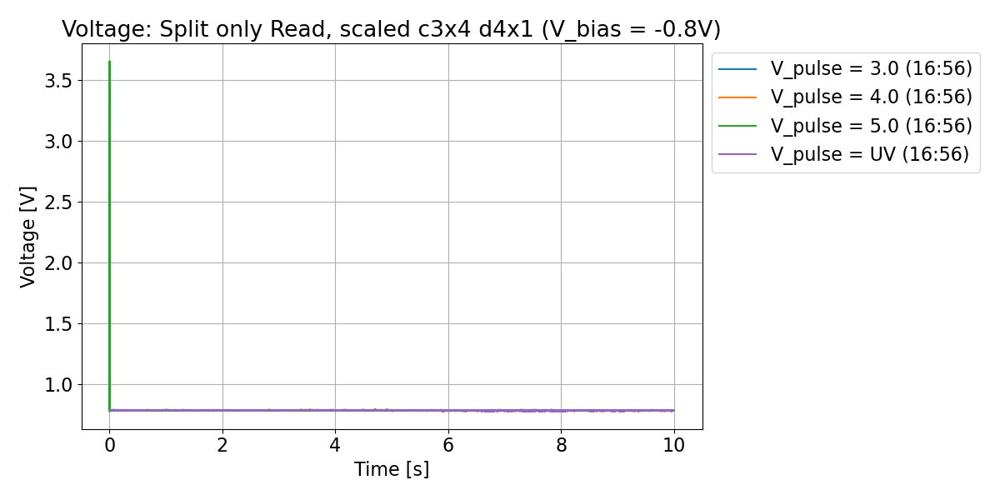

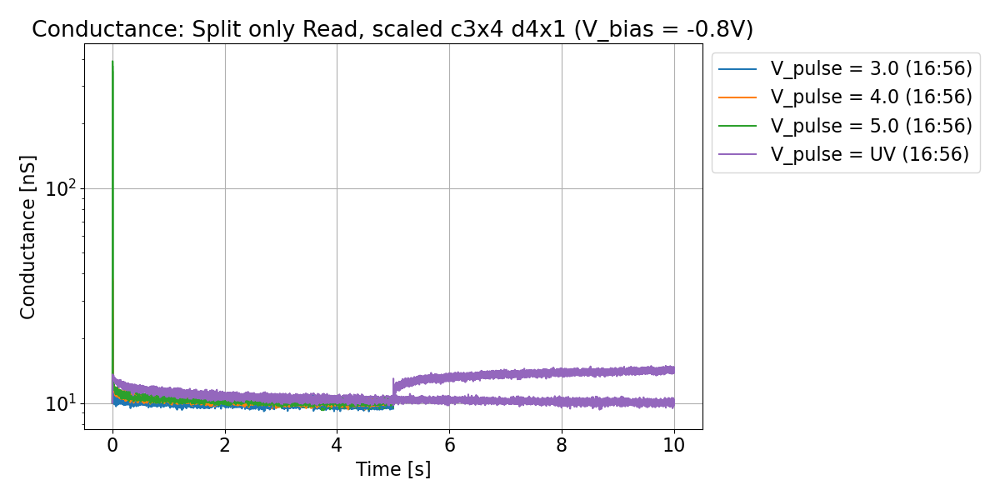

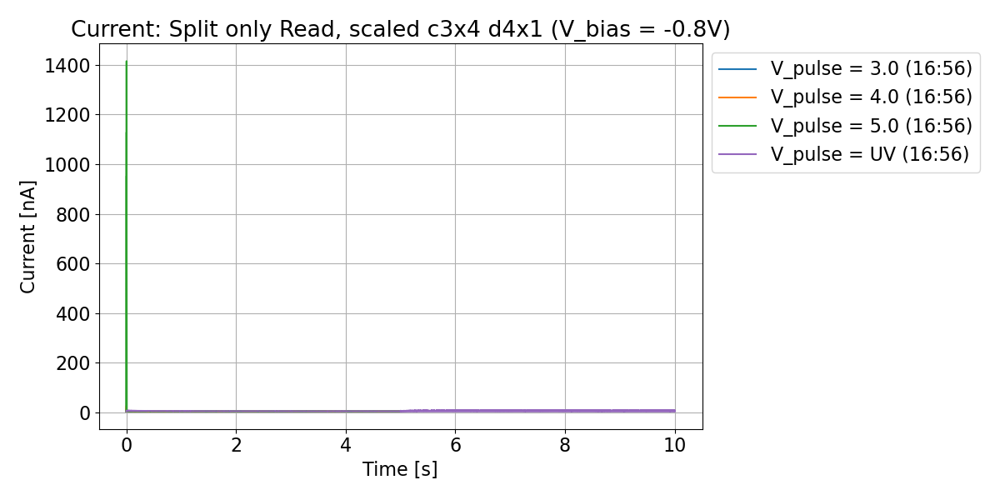

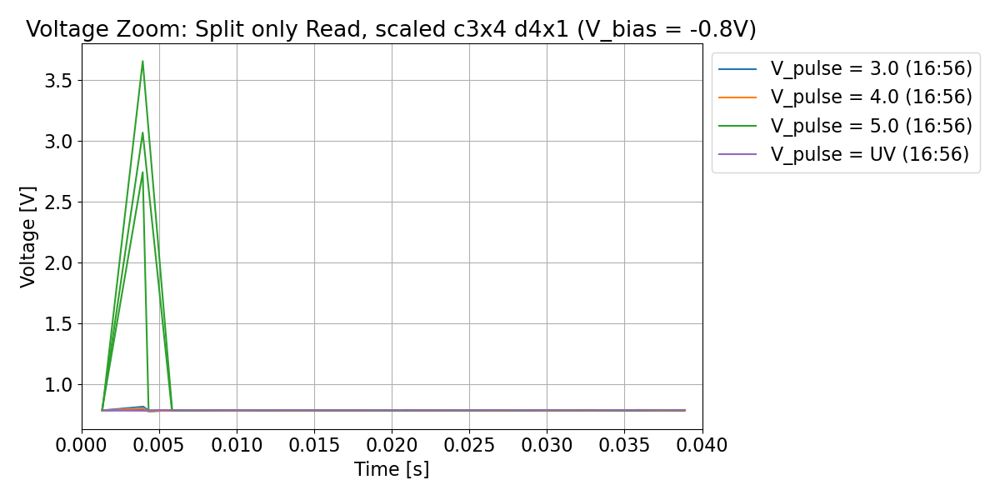

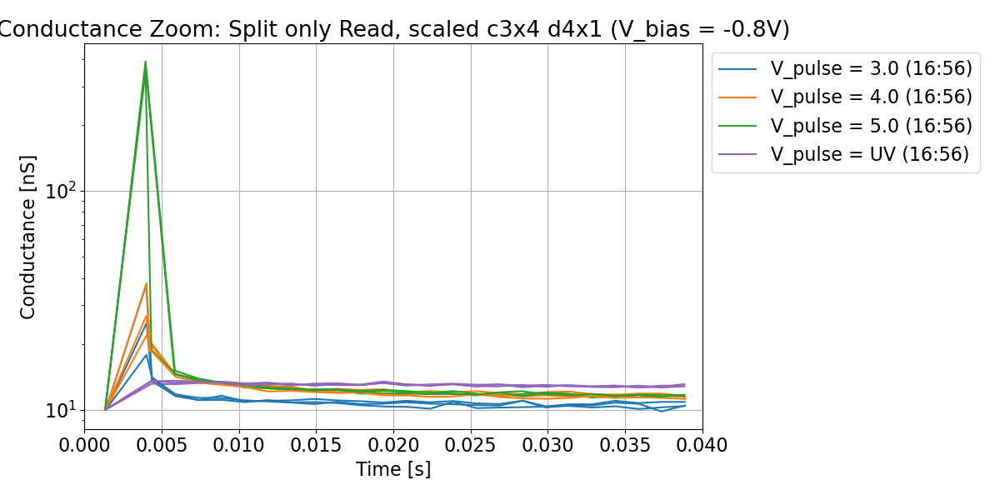

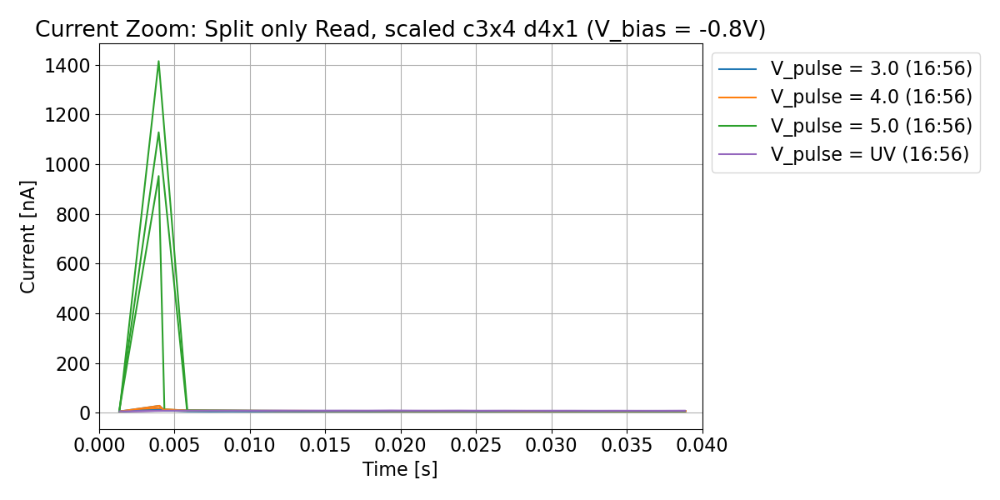

In [131]:
plt.close('all')

figures = []
figure_names = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        if spec['no_labels']:
            fig, axs = plt.subplots(1,1, figsize=figsize)
        else:
            fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data'].iloc[::interleave]      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            if max_legend_entries is None or i < max_legend_entries:
                label = _parse_template(m, spec['legend_template'])
            else:
                label = '_no_label_'
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);


        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])

        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))


        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        figure_names.append(name)
        if not spec['no_labels']:
            legend_kwargs = {}
            if legend_pos == 'outside':
                legend_kwargs['bbox_to_anchor'] = (1,1)
                legend_kwargs['loc'] = 'upper left'
            else:
                legend_kwargs['loc'] = legend_pos
            
            if legend_labels:
                axs.legend(legend_labels, **legend_kwargs)
            else:
                axs.legend(**legend_kwargs)
                
            axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
            axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
            axs.set_title(name)
            axs.grid()

        
       
        
        fig.tight_layout()
        figures.append(fig)

### Save figures 

In [194]:
savenames = figure_names
subdirectory = 'clean'
save_figures(figures, figure_specs, savenames, directory, subdirectory=subdirectory, filetype='pdf')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Current_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Zoom_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V_x=0E+00_to_4E-02
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Zoom_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V_ylog_x=0E+00_to_4E-02
/baltic/users/optolabda

# Plot different biases 

In [328]:
selection = selection
selection = [0]

chosen_sel = 'normal'
chosen_sel = 'split_selections'
chosen_sel = 'triggered_selections'
chosen_sel = 'scaled_selections'
#chosen_sel = 'mov_avg_selections'

In [357]:
choose_split = True
#split_idces = list(range(1, 58, 4)) # V_pulse = 3V
# split_idces = list(range(2, 59, 4)) # V_pulse = 4V
split_idces = list(range(3, 60, 4)) # V_pulse = 5V
#split_idces = list(range(4, 61, 4)) # UV pulse


plot_selection = []

for idx in selection:
    man_sel = an.manipulated_selections[chosen_sel][idx]
    if choose_split:
        man_sel = [s for i,s in enumerate(man_sel) if i in split_idces]
        
    plot_selection += man_sel

In [358]:
print(plot_selection)

['0_split_4_trig_scaled', '0_split_8_trig_scaled', '0_split_12_trig_scaled', '0_split_16_trig_scaled', '0_split_20_trig_scaled', '0_split_24_trig_scaled', '0_split_28_trig_scaled', '0_split_32_trig_scaled', '0_split_36_trig_scaled', '0_split_40_trig_scaled', '0_split_44_trig_scaled', '0_split_48_trig_scaled', '0_split_52_trig_scaled', '0_split_56_trig_scaled', '0_split_60_trig_scaled']


### Plot Setup 

In [359]:
# Data Range
interleave = 1

xlim = [0, 0.04]

y_factor = 1e9

In [360]:
# Plot Design
figsize = (8,6)

figsize_factor = 0.5

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,0,0,1,1,1,2,2,2,3,3,3,4,4,4]
    #mapping = None
    if mapping is None or int(i) >= len(mapping):
        return cmap(int(i)%10)
    elif type(mapping[int(i)]) is int:     
        return cmap(mapping[int(i)])
    else:
        return mapping[int(i)]

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

In [361]:
# Labels
no_labels = False

title_template = 'Split only Read, scaled {cluster} {device} (V_pulse = {V_pulse}V)'
#title_template = 'DC'

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}


legend_template = 'V_bias = {V_bias}V ({timestamp:%H:%M})'

legend_labels = []

max_legend_entries = None

legend_pos = 'outside'
#legend_pos = 'best'
#legend_pos = 'upper right'



In [362]:
# Figure specification
figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'log',
        'yscale': 'log',
        'xlim': np.array([1e-3, 5.5]),
        'ylim': np.array([9e-9, 22e-9]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
    {
        'title': 'Voltage Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array(xlim),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
]   

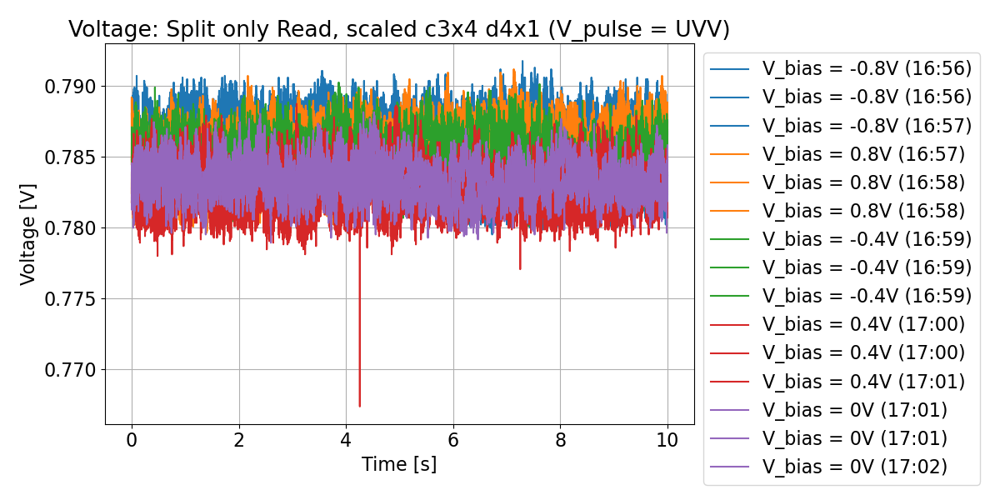

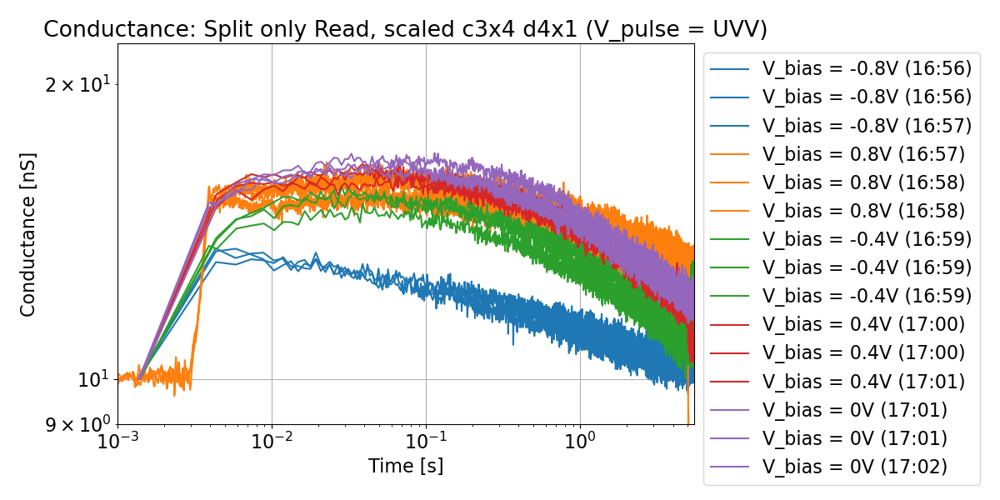

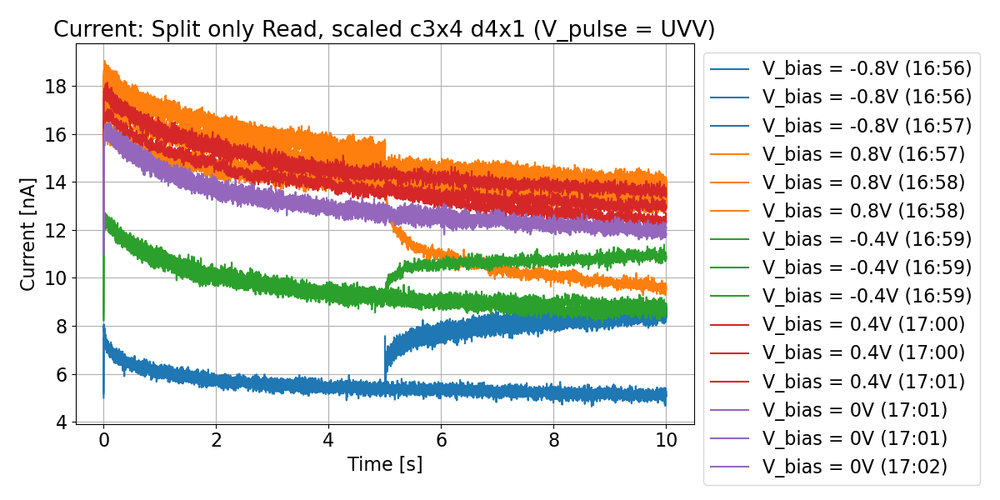

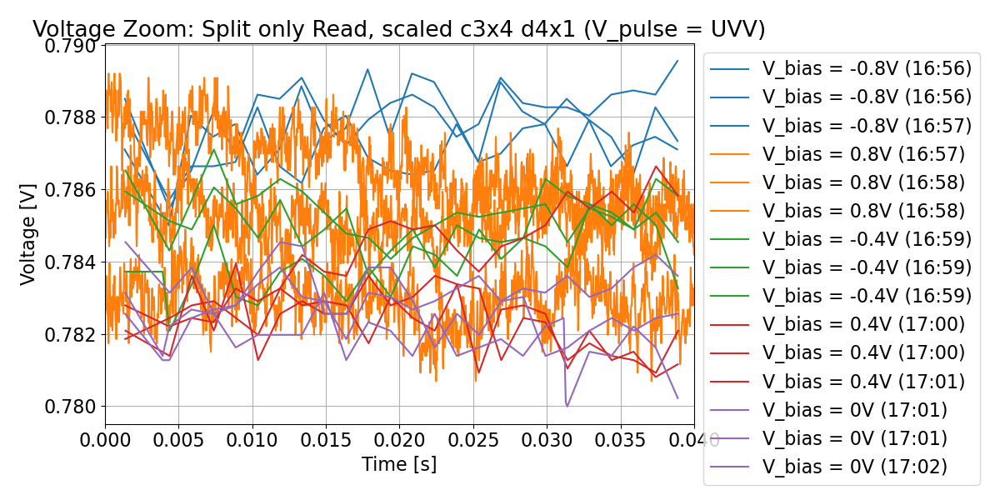

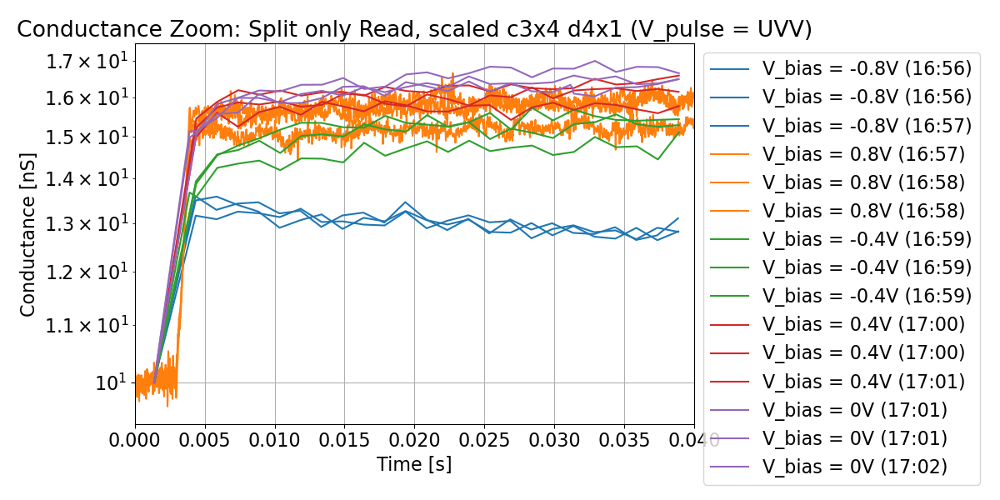

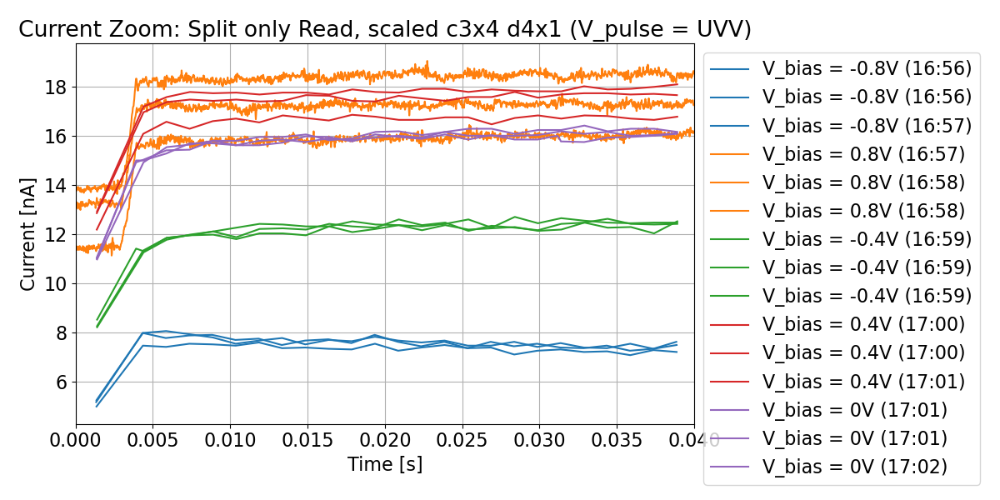

In [363]:
plt.close('all')

figures = []
figure_names = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        if spec['no_labels']:
            fig, axs = plt.subplots(1,1, figsize=figsize)
        else:
            fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data'].iloc[::interleave]      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            if max_legend_entries is None or i < max_legend_entries:
                label = _parse_template(m, spec['legend_template'])
            else:
                label = '_no_label_'
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);


        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])

        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))


        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        figure_names.append(name)
        if not spec['no_labels']:
            legend_kwargs = {}
            if legend_pos == 'outside':
                legend_kwargs['bbox_to_anchor'] = (1,1)
                legend_kwargs['loc'] = 'upper left'
            else:
                legend_kwargs['loc'] = legend_pos
            
            if legend_labels:
                axs.legend(legend_labels, **legend_kwargs)
            else:
                axs.legend(**legend_kwargs)
                
            axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
            axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
            axs.set_title(name)
            axs.grid()

        
       
        
        fig.tight_layout()
        figures.append(fig)

### Save figures 

In [ ]:
savenames = figure_names
subdirectory = 'clean'
save_figures(figures, figure_specs, savenames, directory, subdirectory=subdirectory, filetype='pdf')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Current_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Zoom_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V_x=0E+00_to_4E-02
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Zoom_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V_ylog_x=0E+00_to_4E-02
/baltic/users/optolabda

In [367]:
# ToDo

# Plot different biases: mean and standard deviation

In [364]:
selection = selection
selection = [0]

chosen_sel = 'normal'
chosen_sel = 'split_selections'
chosen_sel = 'triggered_selections'
chosen_sel = 'scaled_selections'
#chosen_sel = 'mov_avg_selections'

In [365]:
choose_split = True
#split_idces = list(range(1, 58, 4)) # V_pulse = 3V
# split_idces = list(range(2, 59, 4)) # V_pulse = 4V
split_idces = list(range(3, 60, 4)) # V_pulse = 5V
#split_idces = list(range(4, 61, 4)) # UV pulse


plot_selection = []

for idx in selection:
    man_sel = an.manipulated_selections[chosen_sel][idx]
    if choose_split:
        man_sel = [s for i,s in enumerate(man_sel) if i in split_idces]
        
    plot_selection += man_sel

In [366]:
print(plot_selection)

['0_split_3_trig_scaled', '0_split_7_trig_scaled', '0_split_11_trig_scaled', '0_split_15_trig_scaled', '0_split_19_trig_scaled', '0_split_23_trig_scaled', '0_split_27_trig_scaled', '0_split_31_trig_scaled', '0_split_35_trig_scaled', '0_split_39_trig_scaled', '0_split_43_trig_scaled', '0_split_47_trig_scaled', '0_split_51_trig_scaled', '0_split_55_trig_scaled', '0_split_59_trig_scaled']


## Calculate Mean and Std Deviation

In [ ]:
selection_err = []
for idx in plot_selection:
    selection_err.append(an.manipulated_selections[chosen_sel][idx][split_start:split_end])
    
#print(selection_err)
print(selection_raw)
selection_labels = [all_labels[l] for l in selection]

['6_split_2', '9_split_2', '8_split_2', '10_split_2', '7_split_2']


In [ ]:
selection_means, selection_stds = calc_errorbars(selection_err)

### Plot Setup 

In [ ]:
# Data Range
interleave = 1

xlim = [0, 0.04]

y_factor = 1e9

In [ ]:
# Plot Design
figsize = (8,6)

figsize_factor = 0.5

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,0,0,1,1,1,2,2,2,3,3,3,4,4,4]
    #mapping = None
    if mapping is None or int(i) >= len(mapping):
        return cmap(int(i)%10)
    elif type(mapping[int(i)]) is int:     
        return cmap(mapping[int(i)])
    else:
        return mapping[int(i)]

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

In [ ]:
# Labels
no_labels = False

title_template = 'Split only Read, scaled {cluster} {device} (V_pulse = {V_pulse}V)'
#title_template = 'DC'

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}


legend_template = 'V_bias = {V_bias}V ({timestamp:%H:%M})'

legend_labels = []

max_legend_entries = None

legend_pos = 'outside'
#legend_pos = 'best'
#legend_pos = 'upper right'



In [ ]:
# Figure specification
figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'log',
        'yscale': 'log',
        'xlim': np.array([1e-3, 5.5]),
        'ylim': np.array([9e-9, 22e-9]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
    {
        'title': 'Voltage Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Conductance Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array(xlim),
        'ylim': np.array([]), #[9e-9, 30e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },
    {
        'title': 'Current Zoom: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlim),
        'ylim': np.array([]), # [4e-9, 20e-9]
        'yfactor': y_factor,
        'legend_template': legend_template,
        'no_labels': no_labels
    },    
]   

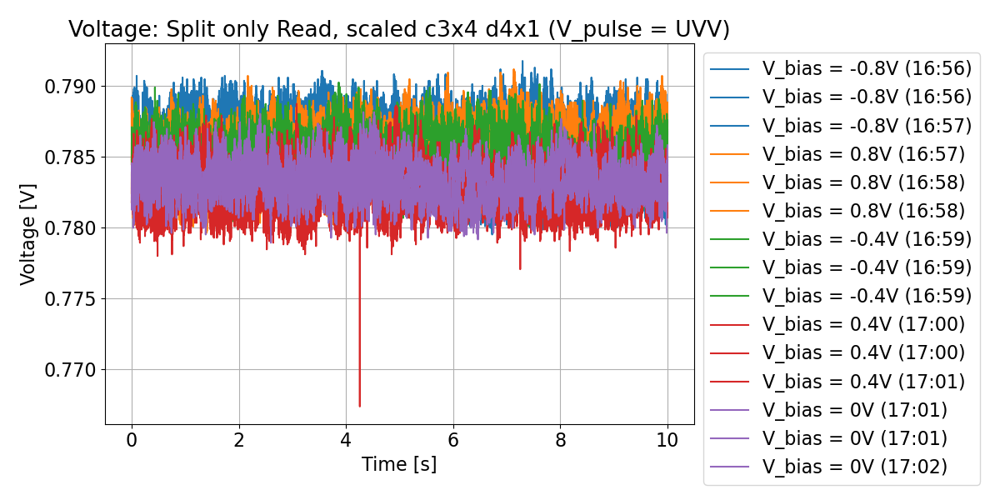

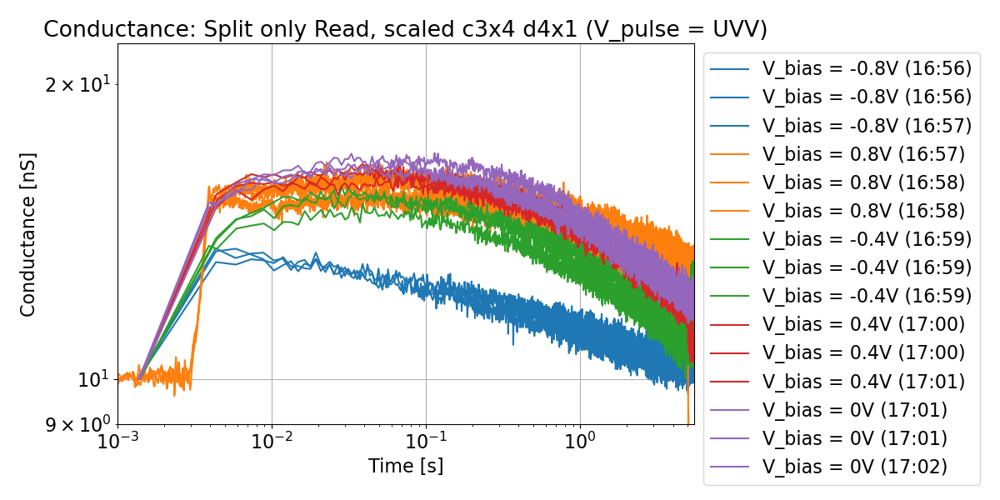

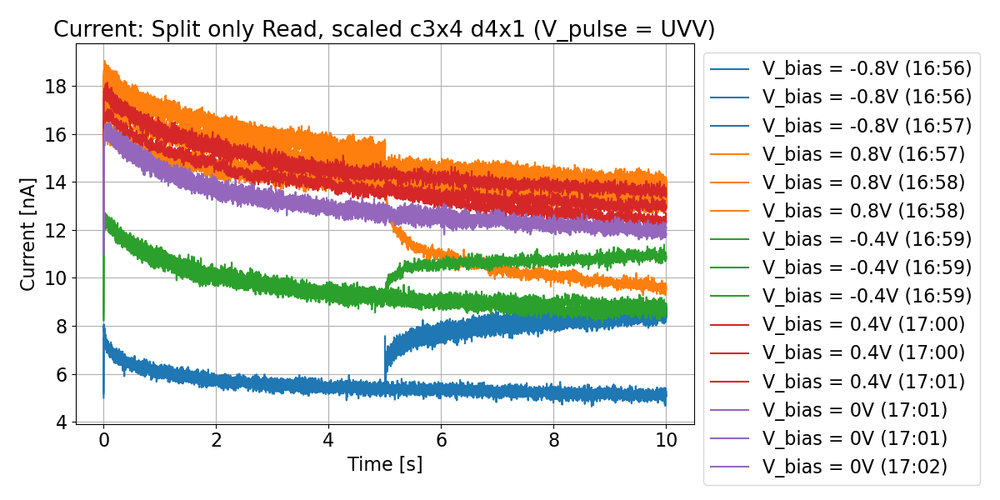

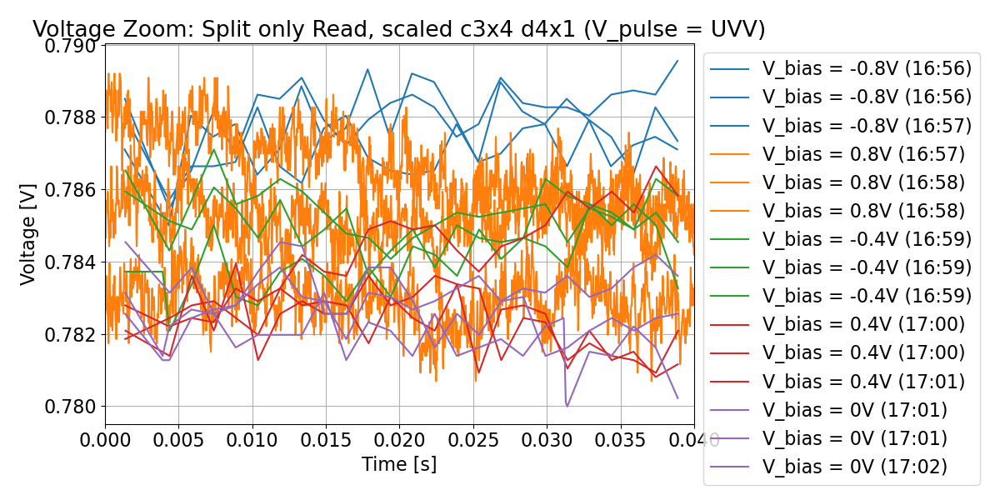

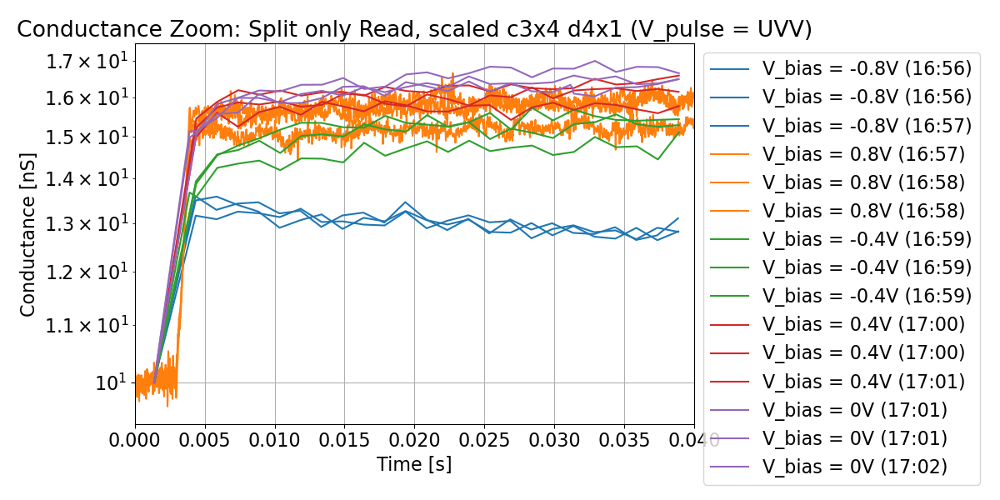

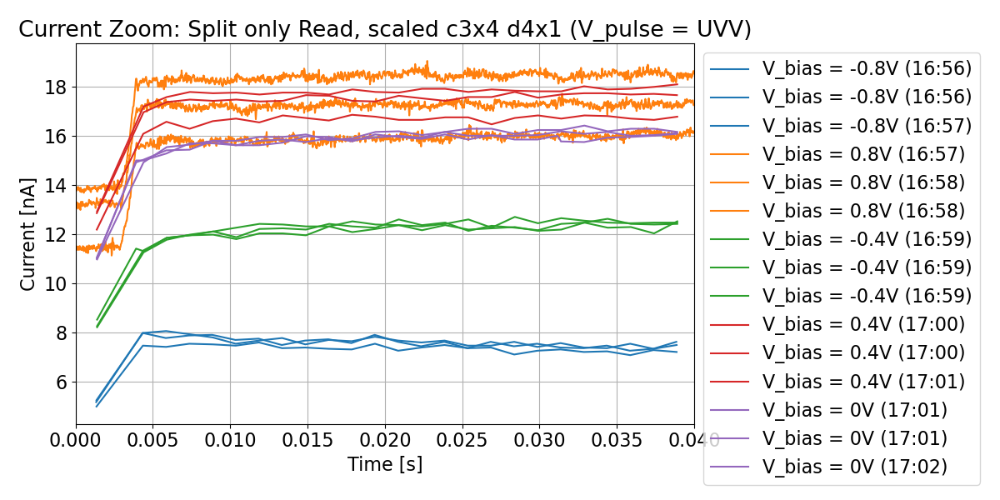

In [ ]:
plt.close('all')

figures = []
figure_names = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        if spec['no_labels']:
            fig, axs = plt.subplots(1,1, figsize=figsize)
        else:
            fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data'].iloc[::interleave]      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            if max_legend_entries is None or i < max_legend_entries:
                label = _parse_template(m, spec['legend_template'])
            else:
                label = '_no_label_'
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);


        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])

        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))


        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        figure_names.append(name)
        if not spec['no_labels']:
            legend_kwargs = {}
            if legend_pos == 'outside':
                legend_kwargs['bbox_to_anchor'] = (1,1)
                legend_kwargs['loc'] = 'upper left'
            else:
                legend_kwargs['loc'] = legend_pos
            
            if legend_labels:
                axs.legend(legend_labels, **legend_kwargs)
            else:
                axs.legend(**legend_kwargs)
                
            axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
            axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
            axs.set_title(name)
            axs.grid()

        
       
        
        fig.tight_layout()
        figures.append(fig)

### Save figures 

In [ ]:
savenames = figure_names
subdirectory = 'clean'
save_figures(figures, figure_specs, savenames, directory, subdirectory=subdirectory, filetype='pdf')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Current_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Voltage_Zoom_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V_x=0E+00_to_4E-02
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-05-02_cleansweep_5_before_anneal_pulses_short_measurement/clean/Conductance_Zoom_Split_only_Read__scaled_c3x4_d4x1_V_bias_=_0_8V_ylog_x=0E+00_to_4E-02
/baltic/users/optolabda

# Appendix

## Clean Bias Plot 

In [335]:
selection = selections['50e-5s']['3.5V']['0.6V'] + selections['50e-5s']['3.5V']['0.3V'] + selections['50e-5s']['3.5V']['0V'] + selections['50e-5s']['3.5V']['-0.3V'] + selections['50e-5s']['3.5V']['-0.6V']
#selection = selections['50e-5s']['3.5V']['0.6V'] + selections['50e-5s']['3.5V']['0.3V'] + selections['50e-5s']['3.5V']['0V'] + selections['50e-5s']['3.5V']['-0.3V']
#selection = selections['10e-5s']['3.5V']['0.6V'] + selections['10e-5s']['3.5V']['0.3V'] + selections['10e-5s']['3.5V']['0V'] + selections['10e-5s']['3.5V']['-0.3V'] + selections['10e-5s']['3.5V']['-0.6V']
#selection = selections['2e-5s']['3.5V']['0.3V']
#chosen_sel = 'split_selections'
#chosen_sel = 'triggered_selections'
chosen_sel = 'scaled_selections'
#chosen_sel = 'cut_selections'

In [336]:
print(selection)

[6, 9, 8, 10, 7]


### Scale Selection 

In [337]:
sel = selection
act_on_selections = 'triggered_selections'
#act_on_selections = 'mov_avg_selections'
#act_on_selections = 'cut_selections'

In [338]:
if not 'scaled_selections' in an.manipulated_selections:
    an.manipulated_selections['scaled_selections'] = {}
    
skip_known = False
scale_method = 'add'
set_G = 1e-9

In [339]:
scaled_selections = {}
for s in sel:
    if skip_known and (s in an.manipulated_selections['scaled_selections']):
        continue
        
    act_sel = an.manipulated_selections[act_on_selections][s]

    an.set_selection(act_sel)
    an.manipulated_selections['scaled_selections'][s] = scale_selection('Time', 'Conductance', [0, 0.8e-3], scale_method=scale_method, set_G=set_G)

#print(scaled_selections)


### Plot Setup 

In [340]:

split_start = 2
split_end = 7

selection_err = []
selection_raw = []
for idx in selection:
    selection_raw += [an.manipulated_selections['split_selections'][idx][split_start]]
    selection_err.append(an.manipulated_selections[chosen_sel][idx][split_start:split_end])
    
#print(selection_err)
print(selection_raw)
selection_labels = [all_labels[l] for l in selection]

['6_split_2', '9_split_2', '8_split_2', '10_split_2', '7_split_2']


In [341]:
selection_means, selection_stds = calc_errorbars(selection_err)

In [342]:
figsize = (8,6)

height_ratios = [4, 1]
h_space = 0.2

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i))
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]'}

legend_labels = selection_labels
legend_labels = ['0.6V', '0.3V', '0V', '-0.3V', '-0.6V']


cycles = int(len(selection_err[0]))

title_appendix = f', {cycles} Cycles'

figure_specs = [
    {
        'title': 'STP (V=3.5V, W=500us)',
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([0.065, 0.09]),
        'ylim': np.array([]),
        'ylim_raw': np.array([]),
        'sub_selection': None,
        'show_voltage': True,
        'errorbar': False
    },
    {
        'title': 'STP (V=3.5V, W=500us)',
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([0, 0.0054]),
        'ylim': np.array([]),
        'ylim_raw': np.array([-0.7, 3.6]),
        'sub_selection': None,
        'show_voltage': True,
        'errorbar': False
    },
    {
        'title': 'STP (V=3.5V, W=500us)',
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([0.067, 0.0724]),
        'ylim': np.array([]),
        'ylim_raw': np.array([-0.7, 3.6]),
        'sub_selection': None,
        'show_voltage': True,
        'errorbar': False
    },
    {
        'title': 'STP (V=3.5V, W=500us)',
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([0.065, 0.4]),
        'ylim': np.array([6e-9, 30e-9]),
        'ylim_raw': np.array([]),
        'sub_selection': None,
        'show_voltage': False,
        'errorbar': False
    },
    {
        'title': 'STP (V=3.5V, W=500us)',
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'log',
        'yscale': 'log',
        'xlim': np.array([0.01, 82]),
        'ylim': np.array([1e-10, 45e-9]),
        'ylim_raw': np.array([]),
        'sub_selection': None,
        'show_voltage': False,
        'errorbar': False
    },
    {
        'title': 'STP (V=3.5V, W=500us)',
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'log',
        'yscale': 'linear',
        'xlim': np.array([0.01, 82]),
        'ylim': np.array([-1e-9, 25e-9]),
        'ylim_raw': np.array([]),
        'sub_selection': None,
        'show_voltage': False,
        'errorbar': False
    },
    
]   

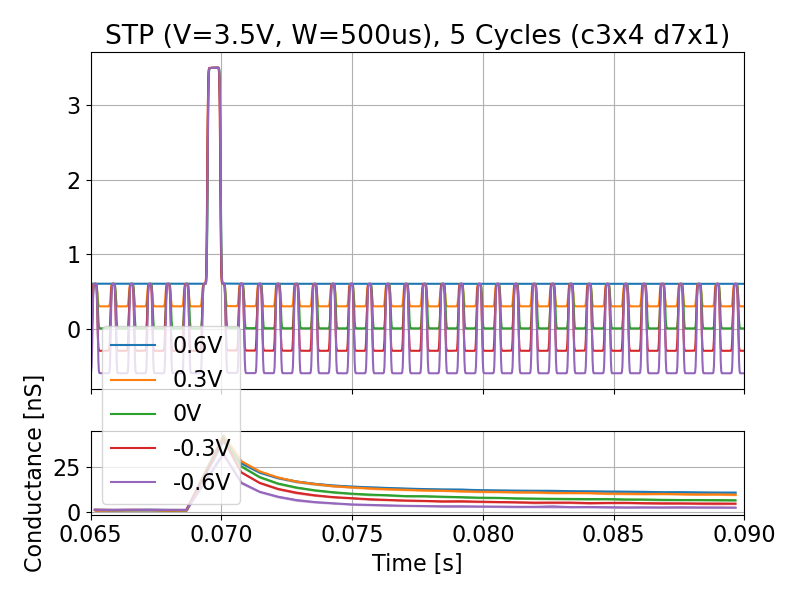

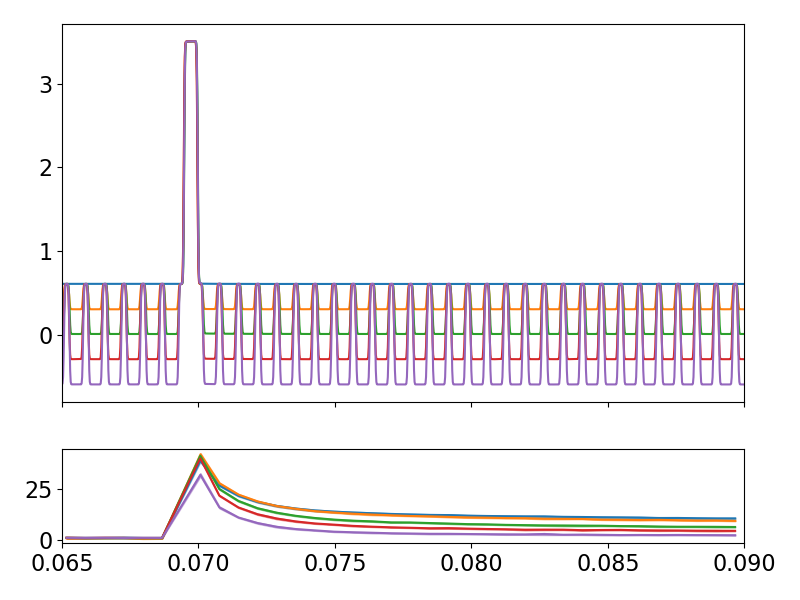

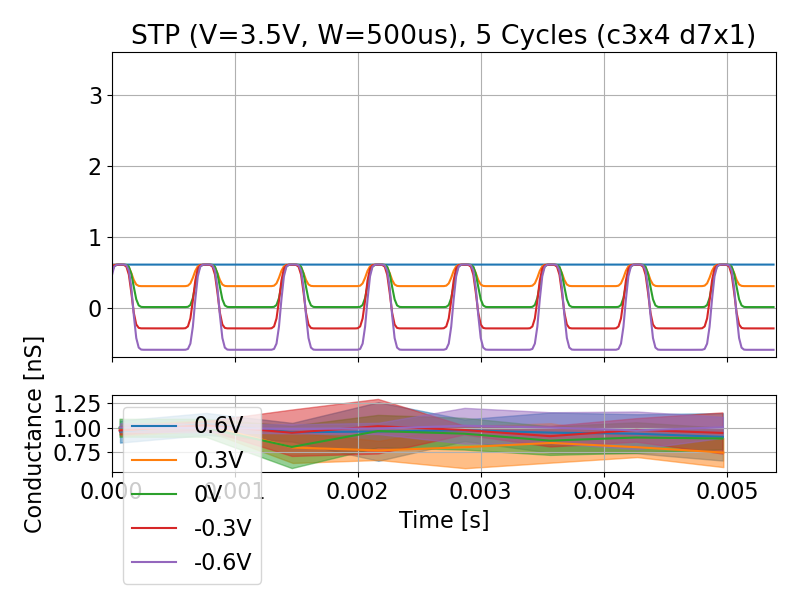

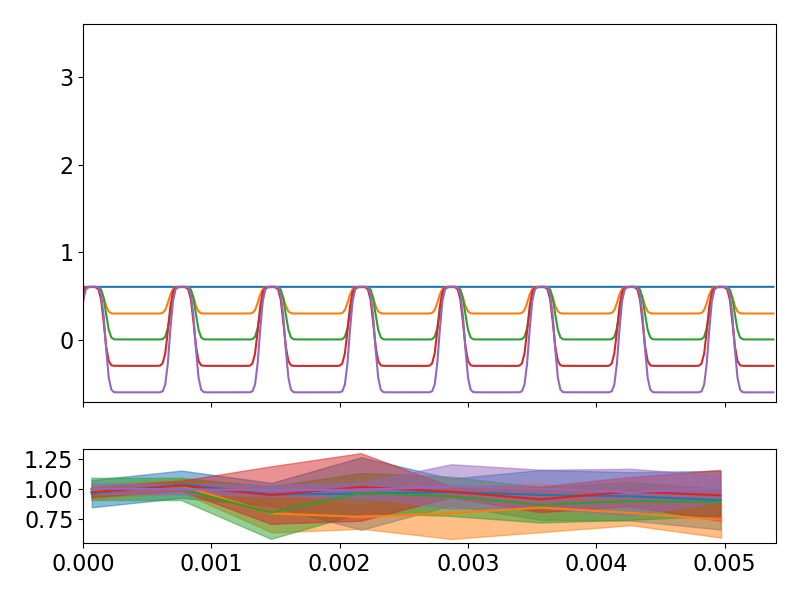

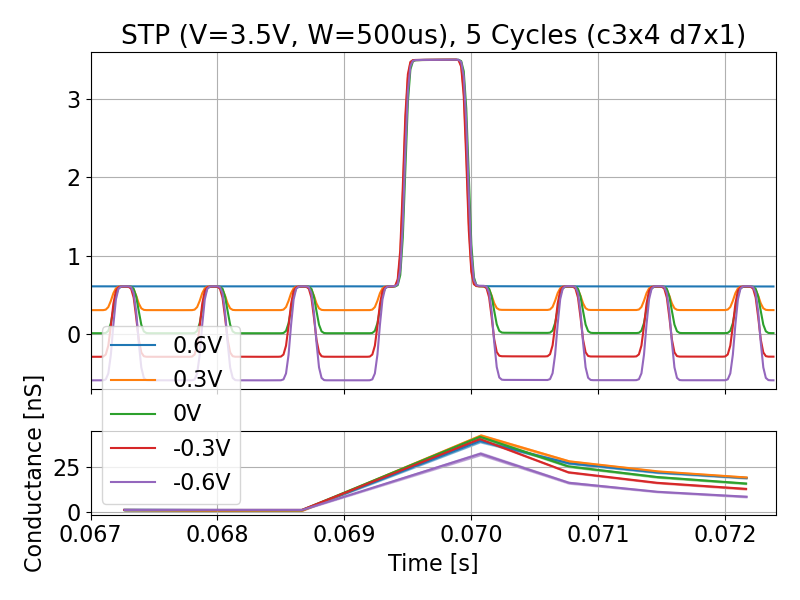

...

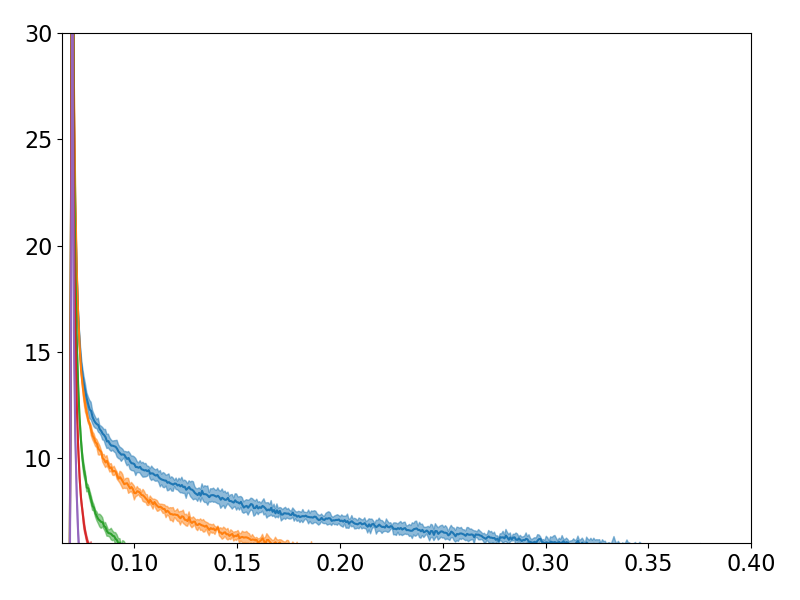

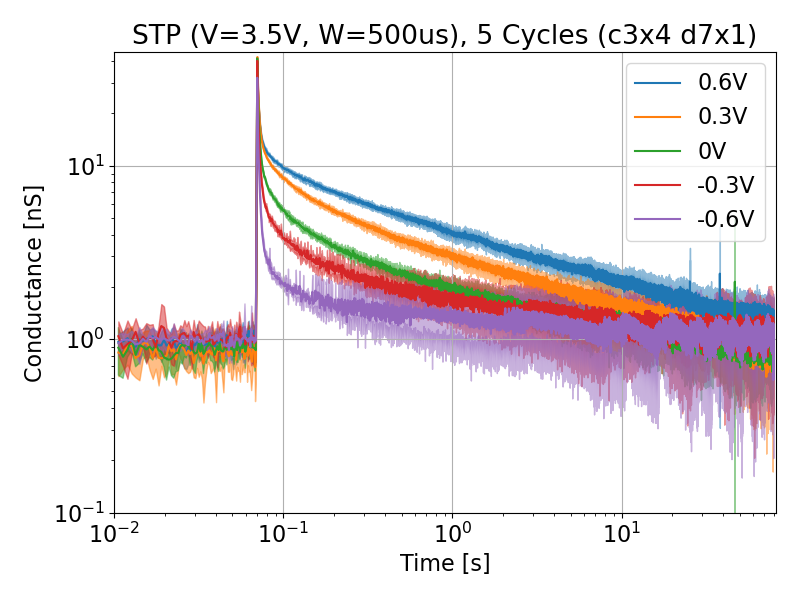

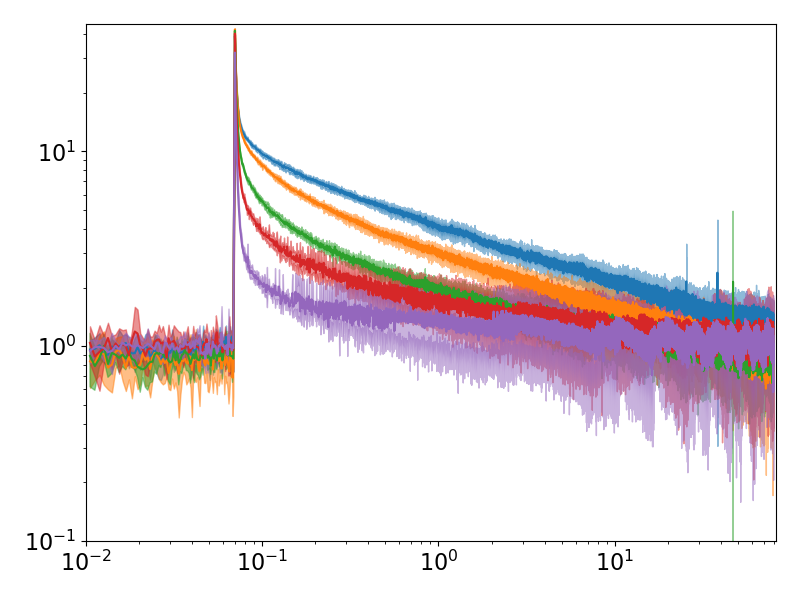

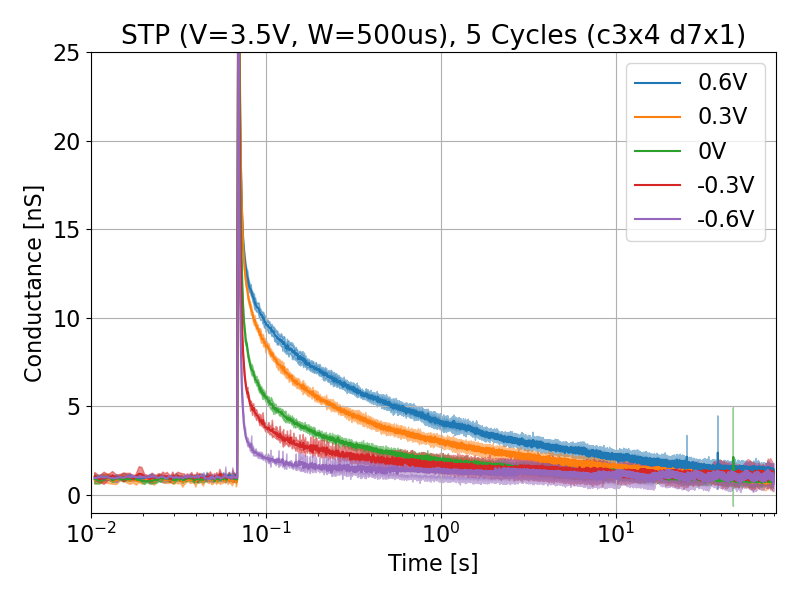

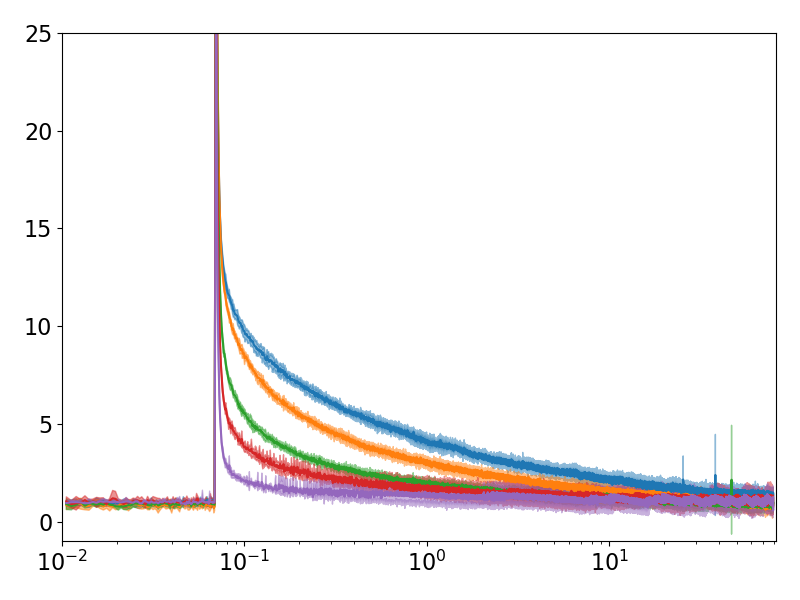

In [343]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        if spec['show_voltage']:
            fig, axs = plt.subplots(len(height_ratios),1, figsize=figsize, sharex=True, gridspec_kw={'height_ratios': height_ratios})
            fig_no_labels, axs_no_labels = plt.subplots(len(height_ratios),1, figsize=figsize, sharex=True, gridspec_kw={'height_ratios': height_ratios})
        else:
            fig, axs = plt.subplots(1,1, figsize=figsize)
            fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
            axs = [None, axs]
            axs_no_labels = [None, axs_no_labels]
        if spec['sub_selection'] is None:
            spec['sub_selection'] = list(range(len(selection_means)))
        sel_means = [selection_means[i] for i in spec['sub_selection']]
        sel_stds = [selection_stds[i] for i in spec['sub_selection']]
        sel_raw = [selection_raw[i] for i in spec['sub_selection']]
        for i, (id_mean, id_std, id_raw) in enumerate(zip(sel_means, sel_stds, sel_raw)):
            data_mean = an.measurements[id_mean]['data']
            data_std = an.measurements[id_std]['data']  
            data_raw = an.measurements[id_raw]['data'] 
            x = data_mean[spec['x_axis']]
            y = data_mean[spec['y_axis']]
            y_err = data_std[spec['y_axis']]
            x_raw = data_raw[spec['x_axis']]
            y_raw = data_raw['Voltage']
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                mask_raw = (x_raw >= spec['xlim'][0]) & (x_raw <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
                y_err = y_err[mask]
                x_raw = x_raw[mask_raw]
                y_raw = y_raw[mask_raw]
            #axs.errorbar(x, y, y_err, linestyle='None', marker='o', markersize=2, capsize=2)
            idx = spec['sub_selection'][i]
            color = color_map(cmap, idx)
            if spec['errorbar']:
                axs[1].errorbar(x, y*y_factor, yerr=y_err*y_factor, color=color)
                axs_no_labels[1].errorbar(x, y*y_factor, yerr=y_err*y_factor, color=color)
            else:
                axs[1].plot(x, y*y_factor, color=color, linestyle=linestyle_map[i])
                axs[1].fill_between(x, (y-y_err)*y_factor, (y+y_err)*y_factor, color=color, alpha=0.5)
                axs_no_labels[1].plot(x, y*y_factor, color=color, linestyle=linestyle_map[i]);
                axs_no_labels[1].fill_between(x, (y-y_err)*y_factor, (y+y_err)*y_factor, color=color, alpha=0.5);
            if spec['show_voltage']:
                axs[0].plot(x_raw, y_raw, color=color, linestyle=linestyle_map[i])
                axs_no_labels[0].plot(x_raw, y_raw, color=color, linestyle=linestyle_map[i])
        
        if legend_labels:
            if spec['errorbar']:
                labels = legend_labels
            else:
                labels = sum([[legend_labels[i], '_no_label_'] for i in spec['sub_selection']], [])
            axs[1].legend(labels)
        axs[1].set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs[1].set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        
        name = _parse_template(an.measurements[sel_means[0]], spec['title'] + title_appendix + ' ({cluster} {device})')
        if spec['show_voltage']:
            axs[0].set_title(name)
            axs[0].grid()
            axs[0].set_xscale(spec['xscale'])
            axs[0].set_yscale(spec['yscale'])
            axs_no_labels[0].set_xscale(spec['xscale'])
            axs_no_labels[0].set_yscale(spec['yscale'])
            if spec['xlim'].size:
                axs[0].set_xlim(tuple(spec['xlim']))
                axs_no_labels[0].set_xlim(tuple(spec['xlim']))
            if spec['ylim_raw'].size:
                axs[0].set_ylim(tuple(spec['ylim_raw']))
                axs_no_labels[0].set_ylim(tuple(spec['ylim_raw']))
        else:
            axs[1].set_title(name)
        
        
        axs[1].grid()

        axs[1].set_xscale(spec['xscale'])
        axs[1].set_yscale(spec['yscale'])
        axs_no_labels[1].set_xscale(spec['xscale'])
        axs_no_labels[1].set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs[1].set_xlim(tuple(spec['xlim']))
            axs_no_labels[1].set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs[1].set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels[1].set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        if spec['show_voltage']:
            fig.subplots_adjust(hspace=h_space)
            fig_no_labels.subplots_adjust(hspace=h_space)
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [94]:
save_figures(figures, figures_no_labels, figure_specs, selection_means, directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2023-08-16_cleansweep_3_clean_bias_measurement/clean/c3x4_d7x1/2023-08-16_123354_c3x4_d7x1_STP_V=3_5V__W=500us_x=7E-02_to_9E-02
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 n
Not saving...
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2023-08-16_cleansweep_3_clean_bias_measurement/clean/c3x4_d7x1/2023-08-16_123354_c3x4_d7x1_STP_V=3_5V__W=500us_x=0E+00_to_5E-03
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 n
Not saving...
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2023-08-16_cleansweep_3_clean_bias_measurement/clean/c3x4_d7x1/2023-08-16_123354_c3x4_d7x1_STP_V=3_5V__W=500us_x=7E-02_to_7E-02
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 n
Not saving...
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2023-08-16_cleansweep_3_clean_bias_measurement/clean/c

## Clean Measurements

In [28]:
if not hasattr(an, 'manipulated_selections'):
    an.manipulated_selections = {}

In [32]:
def remove_outliers_from_selection(axis, low_limit=1e-14, high_limit=1e0, appendix='cleaned', calc_abs=True):
    cleaned_selection = []
    for idx in an.selection:
        m = copy.deepcopy(an.measurements[idx])
        data = m['data']
        if calc_abs:
            mask = (data[axis].abs() >= low_limit) & (data[axis].abs() <= high_limit)
        else:
            mask = (data[axis] >= low_limit) & (data[axis] <= high_limit)
        data = data[mask]
        m['data'] = data
        
        new_idx = f'{idx}_{appendix}'
        cleaned_selection.append(new_idx)
        an.measurements[new_idx] = m
        
    return cleaned_selection
    

In [33]:
sel = selection_to_manipulate
an.set_selection(sel)
selection_cleaned = remove_outliers_from_selection('Current')

sel = selection_cleaned
an.set_selection(sel)
selection_cleaned = remove_outliers_from_selection('Resistance', low_limit=1e2, high_limit=1e13, calc_abs=False)

sel = selection_cleaned
an.set_selection(sel)
selection_cleaned = remove_outliers_from_selection('Voltage', low_limit=1e-1, high_limit=1e13)

an.manipulated_selections['cleaned_selection'] = {}
for idx_old, idx_new in zip(selection_to_manipulate, selection_cleaned):
    an.manipulated_selections['cleaned_selection'][idx_old] = [idx_new]

## Calc Mean Curve

In [399]:
selection = selection_cleaned

start_from_cycle = 1
default_selected_cycles = [1,2,3]
selected_cycles = {0: [], 1: [], 2: [], 3: [1,2,3,4], 4: []}
selected_cycles = {}

mean_selection = []
for idx in selection:
    m = an.measurements[idx]
    data = m['data']
    # zero_v = data['Time'][data['Source'] == 0]
    # #display(zero_v)
    # idx_selected_zero_v = 3*(start_from_cycle-1)
    # t_selected_zero_v = zero_v.iloc[idx_selected_zero_v]
    selected_cycle_data = data[data['Repeat'] == start_from_cycle].reset_index(drop=True)
    max_num_cycles = data['Repeat'].iloc[-1]
    if idx in selected_cycles:
        sel_cycles = selected_cycles[idx]
    else:
        sel_cycles = []
    if not sel_cycles:
        sel_cycles = default_selected_cycles
    num_selected_cycles = len(sel_cycles) - start_from_cycle + 1
    #display(selected_cycle_data.head())
    for i in range(start_from_cycle+1, max_num_cycles+1):
        #print(i)
        if i not in sel_cycles:
            continue
        cycle_data = data[data['Repeat'] == i][['Voltage', 'Current', 'Resistance', 'Source']].reset_index(drop=True)
        add_df = selected_cycle_data[['Voltage', 'Current', 'Resistance', 'Source']].add(cycle_data, fill_value=0)
        
        selected_cycle_data[['Voltage', 'Current', 'Resistance', 'Source']] = add_df
        #display(cycle_data.head())
        #display(selected_cycle_data.head())
        
    selected_cycle_data[['Voltage', 'Current', 'Resistance', 'Source']] = selected_cycle_data[['Voltage', 'Current', 'Resistance', 'Source']] / num_selected_cycles
    new_idx = f'{idx}_mean'
    new_m = copy.deepcopy(m)
    new_m['data'] = selected_cycle_data
    an.measurements[new_idx] = new_m

    mean_selection.append(new_idx)

mean_selection

KeyError: 'Repeat'

In [ ]:
an.manipulated_selections['mean_selection'] = {}
for idx_old, idx_new in zip(selection_to_manipulate, mean_selection):
    an.manipulated_selections['mean_selection'][idx_old] = [idx_new]

## Split Measurement

In [13]:
selection = mean_selection

thr_pos = 0.1
thr_neg = -0.1

split_selection = []
split_selection_pos = []
split_selection_neg = []
split_selection_neg_1 = []
split_selection_neg_2 = []
for idx in selection:
    m = an.measurements[idx]
    data = m['data']
    new_data_pos = data[data['Source'] >= thr_pos]
    max_v_pos = data['Source'].max()
    #display(data['Time'][data['Source'] == max_v_pos])
    #display(data['Time'][data['Source'] == thr_pos]) 
    time_max_v_pos = data['Time'][data['Source'] == max_v_pos].tail(1).iloc[0]
    #time_max_v_pos = data['Time'].iloc[(data['Source']-max_v_pos).abs().argsort()[:1]]
    #print('time_max_v_pos', time_max_v_pos)
    
    #display(data['Time'][data['Source'] == thr_pos])
    #display(data['Time'].iloc[(data['Source']-thr_pos).abs().argsort()[:1]])
    #time_max_v_pos = data['Time'].iloc[(data['Source']-thr_pos).abs().argsort()[:1]]
    #time_min_v_pos = data['Time'][data['Source'] == thr_pos].iloc[-2]    

    new_data_pos_1 = new_data_pos[new_data_pos['Time'] <= time_max_v_pos]
    new_data_pos_2 = new_data_pos[new_data_pos['Time'] > time_max_v_pos]
    
    new_data_neg = data[data['Source'] <= thr_neg]
    max_v_neg = data['Source'].min()
    time_max_v_neg = data['Time'][data['Source'] == max_v_neg].tail(1).iloc[0]
    #time_max_v_neg = data['Time'].iloc[(data['Source']-max_v_neg).abs().argsort()[:1]]
    #time_min_v_neg = data['Time'][data['Source'] == thr_neg].iloc[-2]

    new_data_neg_1 = new_data_neg[new_data_neg['Time'] <= time_max_v_neg]
    new_data_neg_2 = new_data_neg[new_data_neg['Time'] > time_max_v_neg]
    
    new_idx_pos = f'{idx}_pos_1'
    new_m_pos = copy.deepcopy(m)
    new_m_pos['data'] = new_data_pos_1
    an.measurements[new_idx_pos] = new_m_pos

    new_idx_pos = f'{idx}_pos_2'
    new_m_pos = copy.deepcopy(m)
    new_m_pos['data'] = new_data_pos_2
    an.measurements[new_idx_pos] = new_m_pos

    new_idx_neg = f'{idx}_neg_1'
    new_m_neg = copy.deepcopy(m)
    new_m_neg['data'] = new_data_neg_1
    an.measurements[new_idx_neg] = new_m_neg

    new_idx_neg = f'{idx}_neg_2'
    new_m_neg = copy.deepcopy(m)
    new_m_neg['data'] = new_data_neg_2
    an.measurements[new_idx_neg] = new_m_neg
    

    split_selection += [f'{idx}_pos_1', f'{idx}_pos_2', f'{idx}_neg_1', f'{idx}_neg_2']
    split_selection_pos += [f'{idx}_pos_1', f'{idx}_pos_2']
    split_selection_neg += [f'{idx}_neg_1', f'{idx}_neg_2']
    split_selection_neg_1 += [f'{idx}_neg_1']
    split_selection_neg_2 += [f'{idx}_neg_2']

    
split_selection

['0_mean_pos_1',
 '0_mean_pos_2',
 '0_mean_neg_1',
 '0_mean_neg_2',
 '1_mean_pos_1',
 '1_mean_pos_2',
 '1_mean_neg_1',
 '1_mean_neg_2',
 '2_mean_pos_1',
 '2_mean_pos_2',
 '2_mean_neg_1',
 '2_mean_neg_2',
 '3_mean_pos_1',
 '3_mean_pos_2',
 '3_mean_neg_1',
 '3_mean_neg_2',
 '4_mean_pos_1',
 '4_mean_pos_2',
 '4_mean_neg_1',
 '4_mean_neg_2']

## Make Point Measurement

In [14]:
selection = split_selection_neg_2[0:4] # select branch
selection

['0_mean_neg_2', '1_mean_neg_2', '2_mean_neg_2', '3_mean_neg_2']

In [15]:
target_voltages = [-0.25, -0.5, -0.75, -1, -1.25, -1.5, -1.75, -2]

with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    point_selection = []
    for v in target_voltages:
        data_v_list = []
        for idx in selection:
            m = an.measurements[idx]
            data = m['data']
            data_v = data.iloc[(data['Source']-v).abs().argsort()[:1]]
            #data_v = data[data['Source'] == v]
            T = int(m['T'])
            data_v['T'] = T
            data_v_list.append(data_v)
        #display(data_v_list)
        data_new = pd.concat(data_v_list)
        #display(data_new.head())
        m_new = copy.deepcopy(an.measurements[selection[0]])
        m_new['data'] = data_new
        m_new['V'] = v
        idx_new = f'{selection[0][-5::]}_v{v}'
        an.measurements[idx_new] = m_new

        point_selection += [idx_new]

point_selection

['neg_2_v-0.25',
 'neg_2_v-0.5',
 'neg_2_v-0.75',
 'neg_2_v-1',
 'neg_2_v-1.25',
 'neg_2_v-1.5',
 'neg_2_v-1.75',
 'neg_2_v-2']

In [16]:
an.print_measurements()

,timestamp,meas_name,cluster,device,T,V
0,2024-01-04 16:15:58,cleansweep5_c3x4_d9x1_T25_gap20,c3x4,d9x1,25,NaN
1,2024-01-04 16:32:24,cleansweep5_c3x4_d9x1_T5_gap20,c3x4,d9x1,5,NaN
2,2024-01-04 16:40:26,cleansweep5_c3x4_d9x1_T55_gap20,c3x4,d9x1,55,NaN
3,2024-01-04 16:50:48,cleansweep5_c3x4_d9x1_T105_gap20,c3x4,d9x1,105,NaN
4,2024-01-04 17:00:51,cleansweep5_c3x4_d9x1_T25_gap20,c3x4,d9x1,25,NaN
0_mean,2024-01-04 16:15:58,cleansweep5_c3x4_d9x1_T25_gap20,c3x4,d9x1,25,NaN
1_mean,2024-01-04 16:32:24,cleansweep5_c3x4_d9x1_T5_gap20,c3x4,d9x1,5,NaN
2_mean,2024-01-04 16:40:26,cleansweep5_c3x4_d9x1_T55_gap20,c3x4,d9x1,55,NaN
3_mean,2024-01-04 16:50:48,cleansweep5_c3x4_d9x1_T105_gap20,c3x4,d9x1,105,NaN
4_mean,2024-01-04 17:00:51,cleansweep5_c3x4_d9x1_T25_gap20,c3x4,d9x1,25,NaN


# Manipulate DC Selection

In [34]:
selection_to_manipulate = list(printed_measurements[printed_measurements['V0'].abs() > 0.5].index)

In [35]:
#selection_to_manipulate = [1, 2, 4, 7, 8, 12, 13, 14, 16, 18]

print(selection_to_manipulate)

[1, 2, 4, 7, 8, 10, 12, 14, 16, 19, 23, 24, 25, 27, 29, 32, 37, 40, 46, 47, 50, 56, 63, 67, 68, 69, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 82, 95, 96, 97, 98, 101, 103, 104, 105, 106, 107, 108, 109, 112, 114, 119]


## Manipulate Selection 

In [36]:
if not hasattr(an, 'manipulated_selections'):
    an.manipulated_selections = {}

### Split selection 

In [37]:
sel = selection_to_manipulate
an.set_selection(sel)

#split_timestamps = _pick_timestamps_trigger('Voltage', 0.5, timestamp_offset=-1e-3, n_points_before_pulse_end=0, n_points_per_pulse=1, active_edge='rising')
split_timestamps = _pick_timestamps_trigger('Voltage', 0, timestamp_offset=0, n_points_before_pulse_end=0, n_points_per_pulse=1, active_edge='both')
print(split_timestamps)

{1: [499.0, 999.0, 1499.0, 1999.0], 2: [499.0, 999.0, 1499.0, 1999.0], 4: [499.0, 999.0, 1499.0, 1999.0], 7: [499.0, 999.0, 1499.0, 1999.0], 8: [499.0, 999.0, 1499.0, 1999.0], 10: [1499.0, 2999.0, 4499.0, 5999.0], 12: [499.0, 999.0, 1499.0, 1999.0], 14: [499.0, 999.0, 1499.0, 1999.0], 16: [499.0, 999.0, 1499.0, 1999.0], 19: [499.0, 999.0, 1499.0, 1999.0], 23: [20.0, 39.0], 24: [19.0, 39.0], 25: [2999.0, 5999.0, 8999.0, 11999.0], 27: [1999.0, 3999.0, 5999.0, 7999.0], 29: [3999.0, 7999.0], 32: [3999.0, 7999.0], 37: [3999.0, 7999.0], 40: [3999.0, 7999.0], 46: [9.0], 47: [499.0, 999.0, 1499.0, 1999.0], 50: [499.0, 999.0, 1499.0, 1999.0], 56: [199.0], 63: [499.0, 999.0, 1499.0, 1999.0], 67: [14.1865], 68: [9.21400000000006], 69: [125.473], 71: [19.933], 72: [63.654], 73: [7.554000000000087], 74: [27.80500000000029], 75: [27.80500000000029], 76: [166.2510000000002], 77: [74.33100000000013], 78: [14.445999999999913], 79: [24.07300000000032], 80: [3.5969999999997526], 82: [101.83400000000074],

In [38]:
if not 'split_selections' in an.manipulated_selections:
    an.manipulated_selections['split_selections'] = {}
    
skip_known = False

In [39]:
split_points = split_timestamps

col = 'Time'
add_labels = {}

overlap = 0
split_on_change = False
start_value = 0

if split_on_change:
    assert col != 'Time'

for sel,s in split_points.items():
    if skip_known and (sel in an.manipulated_selections['split_selections']):
        continue
    an.set_selection([sel])
    selection_split = _split_selection(col, split_points, overlap=overlap, start_value=start_value, add_labels=add_labels)
    an.manipulated_selections['split_selections'][sel] = selection_split
    

### Pick read points

In [40]:
split_selection_list = sum(list(an.manipulated_selections['split_selections'].values()), [])

In [41]:
sel = selection_to_manipulate + split_selection_list

if not 'triggered_selections' in an.manipulated_selections:
    an.manipulated_selections['triggered_selections'] = {}
    
skip_known = False

In [42]:
trigger_level = 0.6

n_points_per_pulse = 1
n_points_before_pulse_end = 0

In [43]:
triggered_selections = {}
for s in sel:
    if skip_known and (s in an.manipulated_selections['triggered_selections']):
        continue        
   
    an.set_selection([s])
    an.manipulated_selections['triggered_selections'][s] = an.pick_points_trigger(trigger_level, n_points_per_pulse=n_points_per_pulse, n_points_before_pulse_end=n_points_before_pulse_end)
    
#print(an.manipulated_selections['triggered_selections'])

# Plot c3x3_d5x4 T=50

## DC 

In [406]:
selection = [1, 2, 4, 7, 8, 16, 18]
selection = [2, 27, 29]

plot_selection = selection

plot_selection = ['2_split_2', '27_split_2', '29_split_1']
#plot_selection = ['2_split_1', '27_split_1', '29_split_0']

In [407]:
print(plot_selection)

['2_split_2', '27_split_2', '29_split_1']


### Plot Setup 

In [410]:
figsize = (8,6)

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i)%10)
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}

#legend_template = 'P365={P365}, V={V_end} ({timestamp:%H:%M})'
legend_template = 'T={T} ({timestamp:%H:%M})'
legend_labels = []

#legend_pos = 'outside'
legend_pos = 'best'
figsize_factor = 0.5

title_template = 'DC {cluster} {device}'
#title_template = 'DC'


figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'log',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'log',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]), # [0, 8e-9]
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    
]   

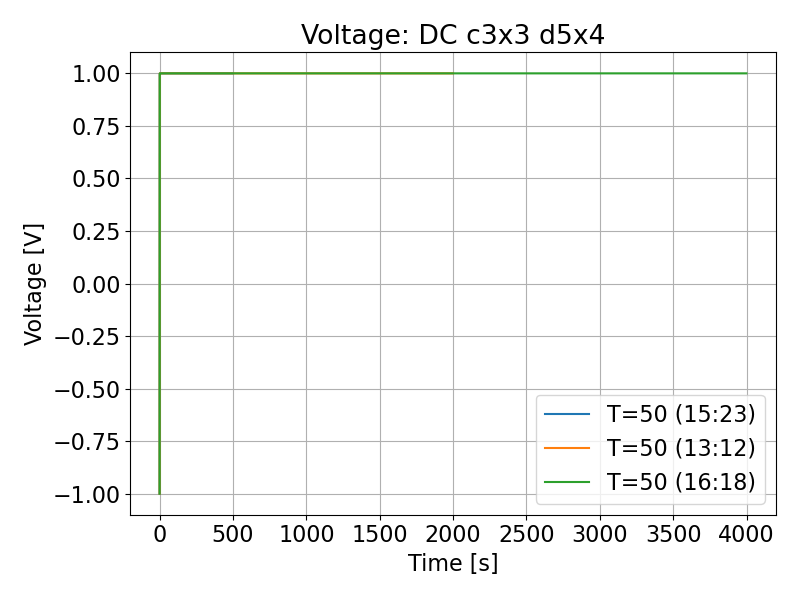

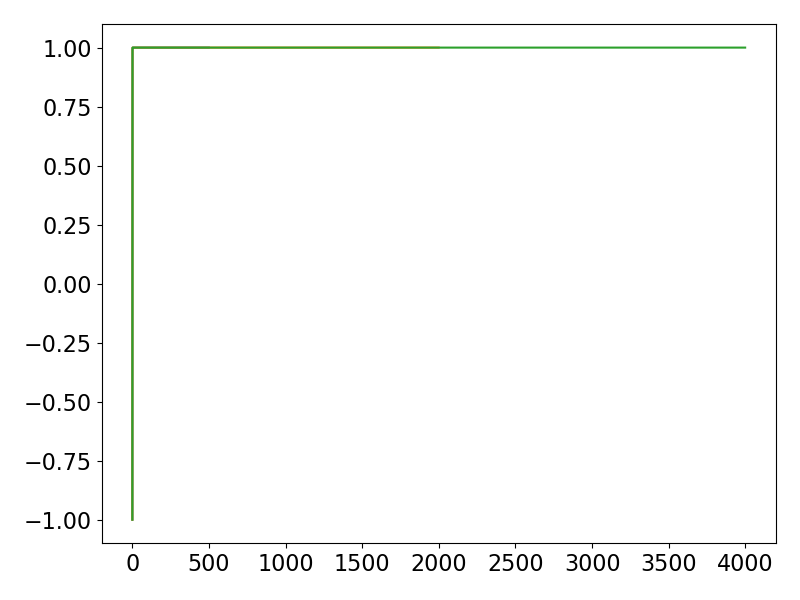

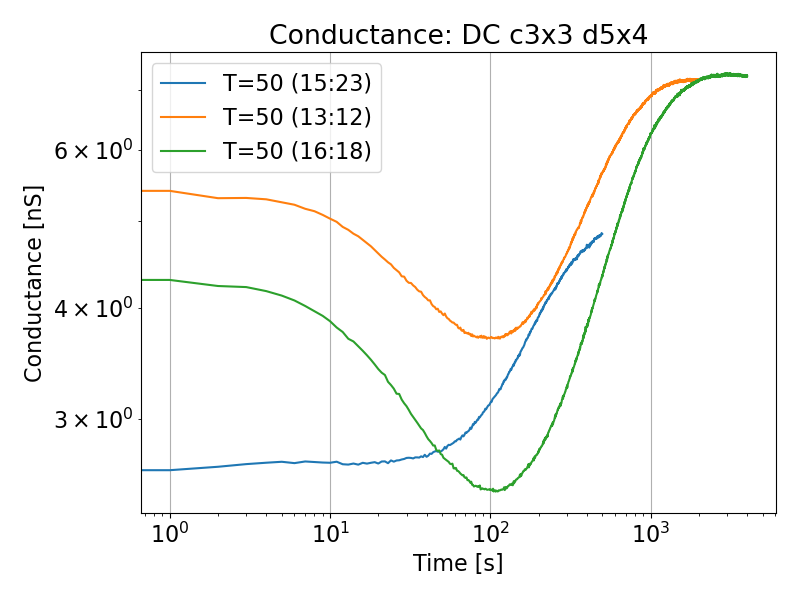

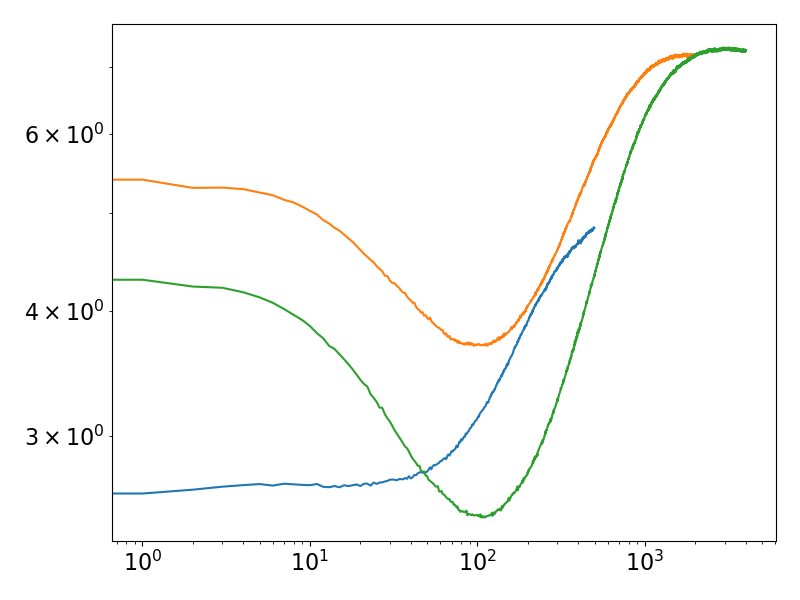

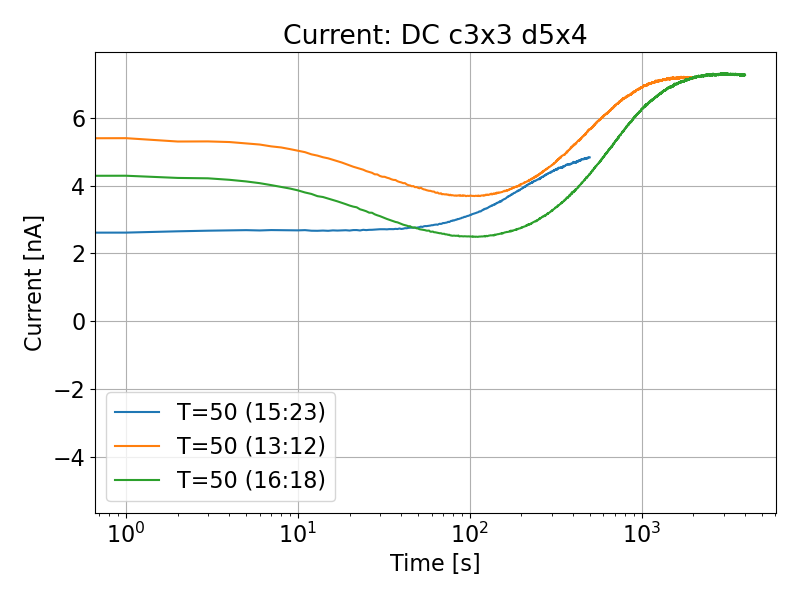

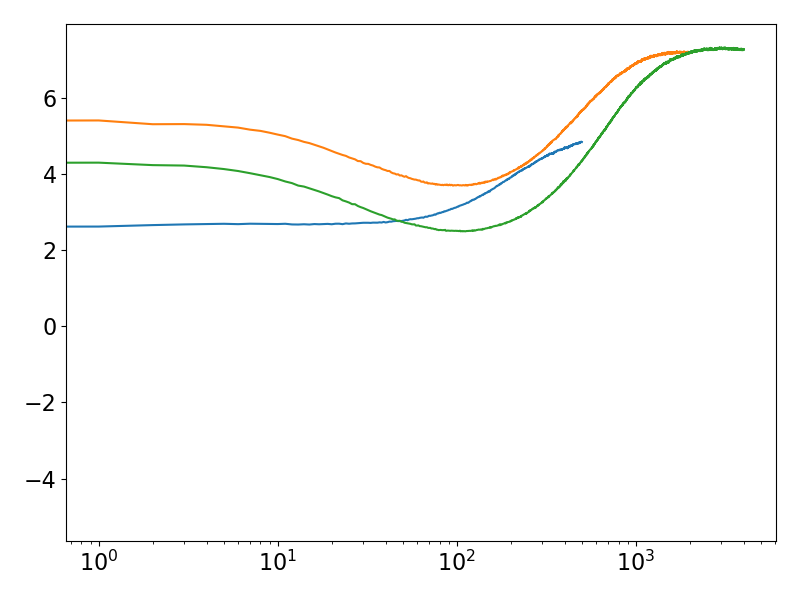

In [411]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data']      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            label = _parse_template(m, spec['legend_template'])
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label)
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);
            
        
        legend_kwargs = {}
        if legend_pos == 'outside':
            legend_kwargs['bbox_to_anchor'] = (1,1)
        else:
            legend_kwargs['loc'] = legend_pos
        
        if legend_labels:
            axs.legend(legend_labels, **legend_kwargs)
        else:
            axs.legend(**legend_kwargs)
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [ ]:
save_figures(figures, figures_no_labels, figure_specs, selection, directory, dpi=300, filetype='png')

## IV

In [39]:
selection = [2, 16, 18]
selection = [26, 28, 30]

chosen_sel = None
chosen_sel = 'cleaned_selection'


In [40]:
print(selection)

[26, 28, 30]


### Plot Setup 

In [41]:
plot_selection = []
if chosen_sel is not None:
    for idx in selection:
        plot_selection += an.manipulated_selections[chosen_sel][idx]
else:
    plot_selection = selection
    
#plot_selection = ['10_split_0', '10_split_1', '10_split_2', '10_split_3', '10_split_4']
    
plot_selection

['26_cleaned_cleaned_cleaned',
 '28_cleaned_cleaned_cleaned',
 '30_cleaned_cleaned_cleaned']

In [42]:
figsize = (8,6)

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i)%10)
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Source': '[V]', 'Current': '[nA]'}

#legend_template = 'P365={P365}, V={V_end} ({timestamp:%H:%M})'
legend_template = 'T={T}, ({timestamp:%H:%M})'
legend_labels = []

#legend_pos = 'outside'
legend_pos = 'best'
figsize_factor = 0.5

title_template = 'IV {cluster} {device}'
#title_template = 'DC'


figure_specs = [
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Source',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Source',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    
]   

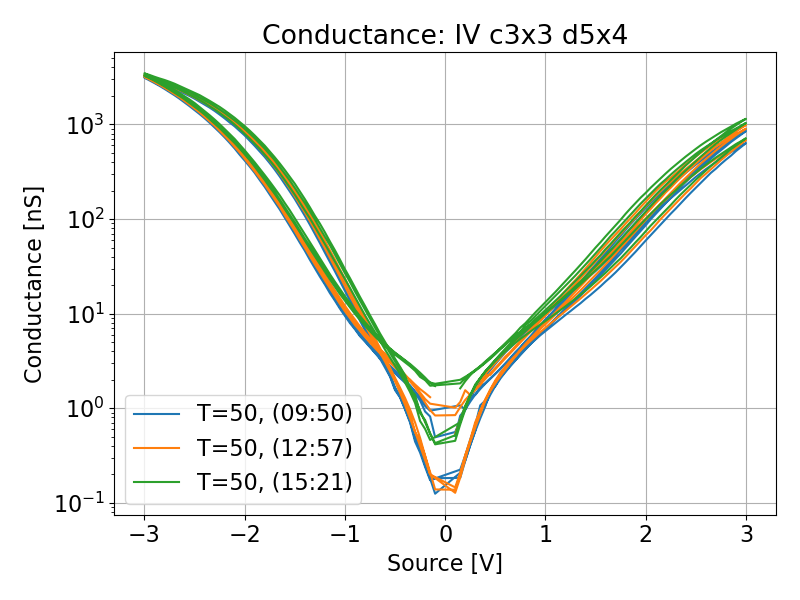

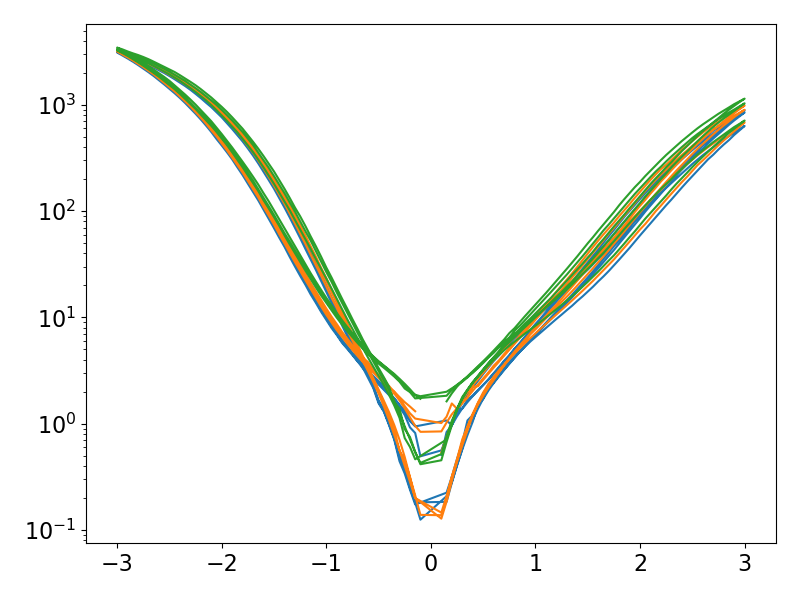

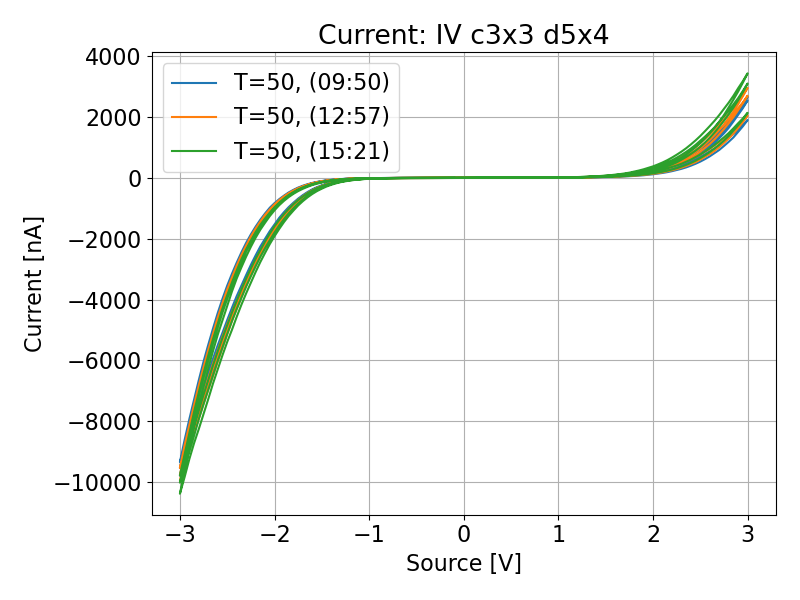

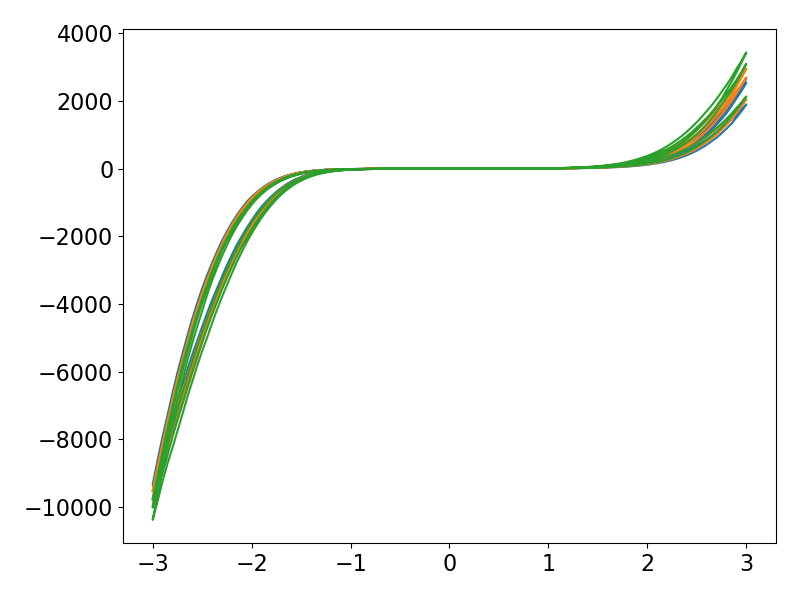

In [43]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data']      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            label = _parse_template(m, spec['legend_template'])
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label)
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);
            
        
        legend_kwargs = {}
        if legend_pos == 'outside':
            legend_kwargs['bbox_to_anchor'] = (1,1)
        else:
            legend_kwargs['loc'] = legend_pos
        
        if legend_labels:
            axs.legend(legend_labels, **legend_kwargs)
        else:
            axs.legend(**legend_kwargs)
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [90]:
save_figures(figures, figures_no_labels, figure_specs, selection, directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-06_095014_c3x3_d5x4_Conductance_IV_c3x3_d5x4_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-06_095014_c3x3_d5x4_Current_IV_c3x3_d5x4


# Plot c3x3_d5x1 T=50,75,100

## DC 

In [390]:
selection = [1, 2, 4, 7, 8, 16, 18]
selection = [29, 32, 37]

chosen_sel = None
#chosen_sel = 'split_selections'

chosen_splits = [1]

### Plot Setup 

In [391]:
plot_selection = []
if chosen_sel is not None:
    for idx in selection:
        plot_selection += [an.manipulated_selections[chosen_sel][idx][split_i] for split_i in chosen_splits]
else:
    plot_selection = selection
    
#plot_selection = ['10_split_0', '10_split_1', '10_split_2', '10_split_3', '10_split_4']
    
plot_selection

[29, 32, 37]

In [394]:
figsize = (8,6)

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i)%10)
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}

#legend_template = 'P365={P365}, V={V_end} ({timestamp:%H:%M})'
legend_template = 'T={T} ({timestamp:%H:%M})'
legend_labels = []

#legend_pos = 'outside'
legend_pos = 'best'
figsize_factor = 0.5

title_template = 'DC {cluster} {device}'
#title_template = 'DC'


figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([0, 20e-9]), # [0, 15e-9]
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    
]   

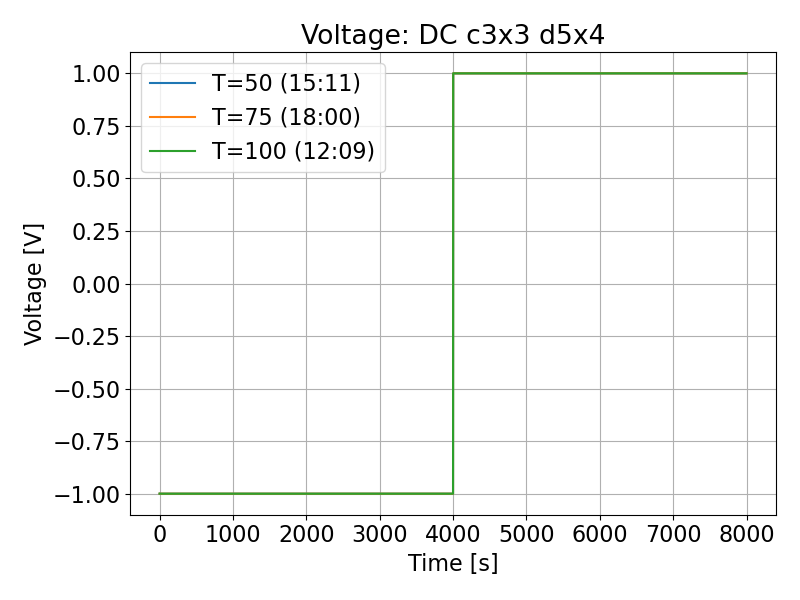

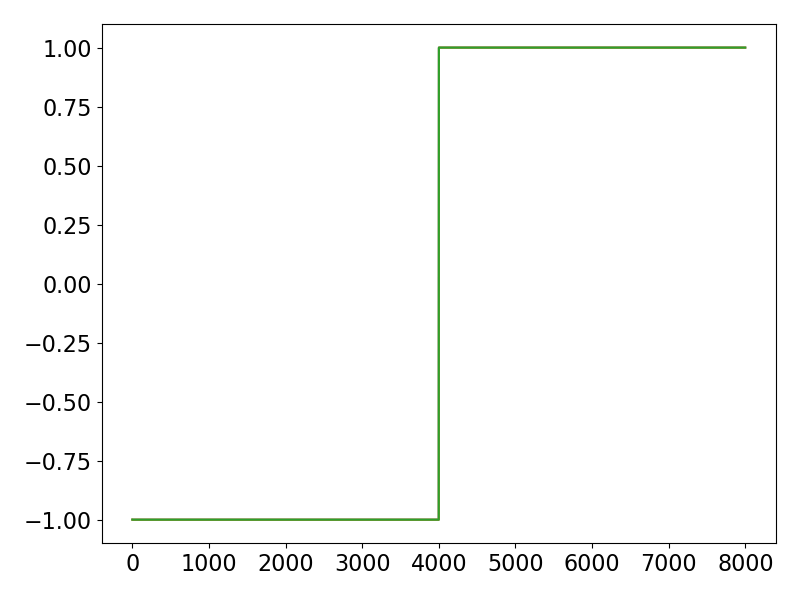

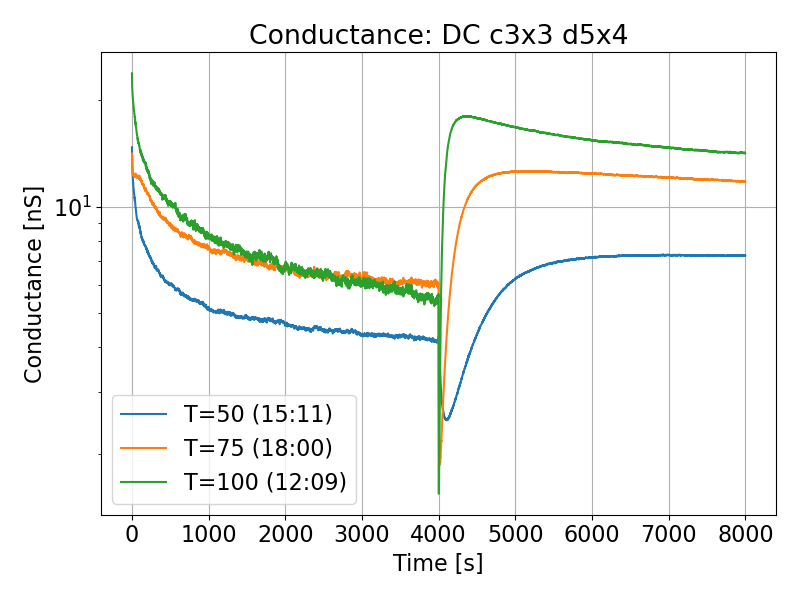

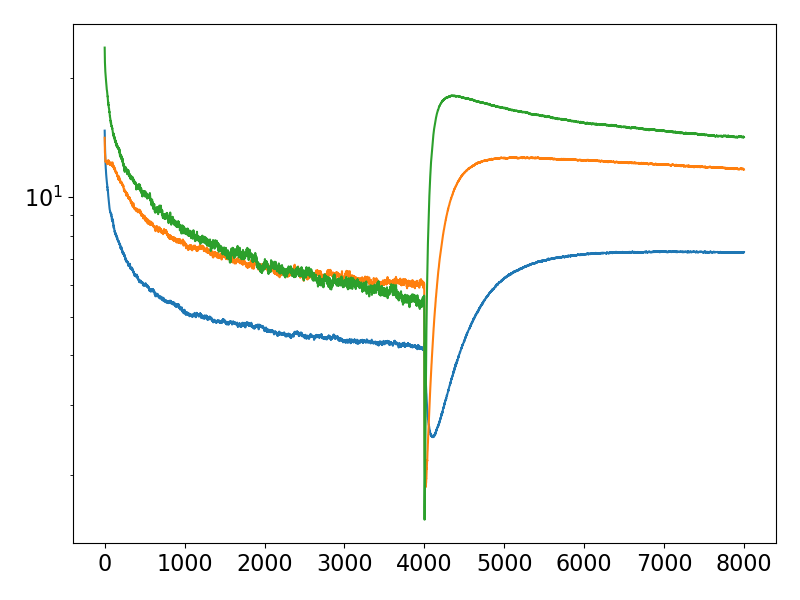

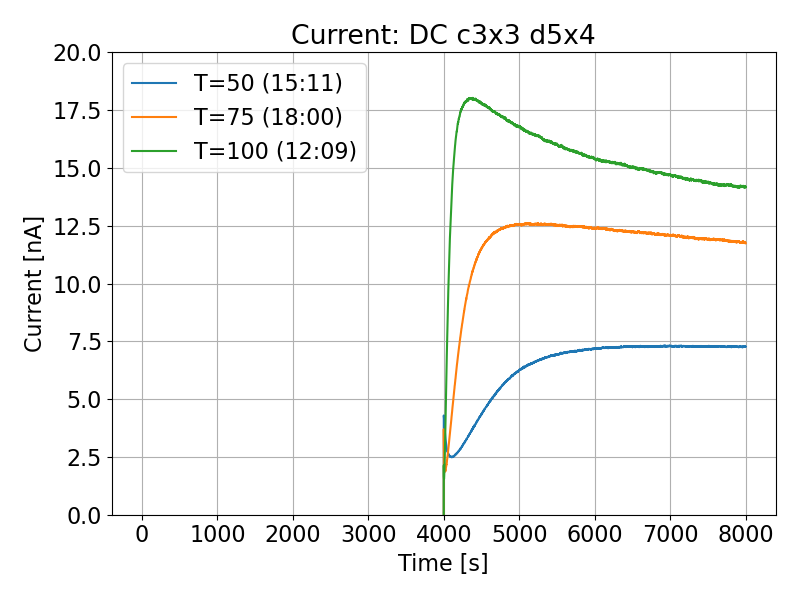

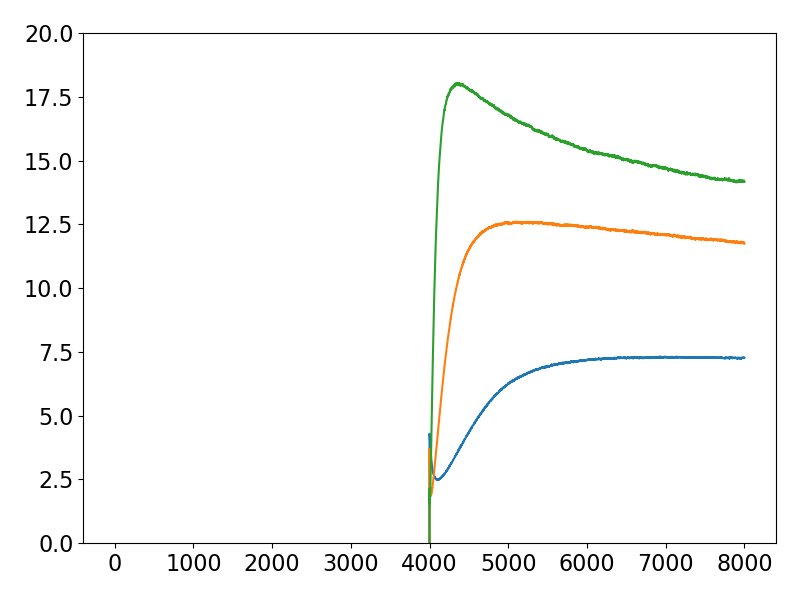

In [395]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data']      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            label = _parse_template(m, spec['legend_template'])
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label)
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);
            
        
        legend_kwargs = {}
        if legend_pos == 'outside':
            legend_kwargs['bbox_to_anchor'] = (1,1)
        else:
            legend_kwargs['loc'] = legend_pos
        
        if legend_labels:
            axs.legend(legend_labels, **legend_kwargs)
        else:
            axs.legend(**legend_kwargs)
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [396]:
save_figures(figures, figures_no_labels, figure_specs, selection, directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-06_151136_c3x3_d5x4_Voltage_DC_c3x3_d5x4
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 r
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-06_151136_c3x3_d5x4_Conductance_DC_c3x3_d5x4_ylog
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 r
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-06_151136_c3x3_d5x4_Current_DC_c3x3_d5x4_y=0E+00_to_2E-08


## Plot mobility 

In [245]:
328 - 273.15

54.85000000000002

In [343]:
gap = 50e-9 * 1e2 #cm
V_app = 1

data = pd.DataFrame({'T celsius': [100, 75, 50], 'tau': [355, 1114, 3000]}) #[355, 1190, 4800]

data_point_sel = [0,1]

In [344]:
data['T kelvin'] = data['T celsius'] + 273.15
data['1/T'] = 1/data['T kelvin']
data['mobility'] = (0.78*gap**2)/(data['tau'] * V_app)
data['mobility*T'] = data['mobility']*data['T kelvin']

In [345]:
from scipy.optimize import curve_fit

def func(x, a, b):
    y = -a*x + b
    return y

alpha = curve_fit(func, xdata = data['1/T'].iloc[data_point_sel], ydata = np.log(data['mobility*T'].iloc[data_point_sel]))[0]

x_fit = np.linspace(data['1/T'].iloc[0], data['1/T'].iloc[-1], 100)
y_fit = np.exp(func(x_fit, alpha[0], alpha[1]))

print(alpha)
mu0 = np.exp(alpha[1])
k = 8.617e-5 #eV/K
E_0 = alpha[0]*k

print(f'mu0 = {mu0}')
print(f'E0 = {E_0}')

[6303.03561918   -7.71931794]
mu0 = 0.00044416344817907124
E0 = 0.5431325793048283


/home/weilenmc/.local/lib/python3.9/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


In [340]:
y_factor = 1e9

units = {'T celsius': '[C]', 'T kelvin': '[K]', '1/T': '[$K^{-1}$]', 'mobility*T': '[$Kcm^{2}s^{-1}V^{-1}$]', 'Voltage': '[V]', 'Current': '[nA]', 'mobility': '[$cm^{2}s^{-1}V^{-1}$]'}

figure_specs = [
    {
        'title': 'Mobility',
        'x_axis': 'T celsius',
        'y_axis': 'mobility',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'plot_fit': False,
        'scatter': False,
    },
    {
        'title': 'Mobility Arhenius Plot',
        'x_axis': '1/T',
        'y_axis': 'mobility*T',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'plot_fit': True,
        'scatter': True,
    },
    
]   

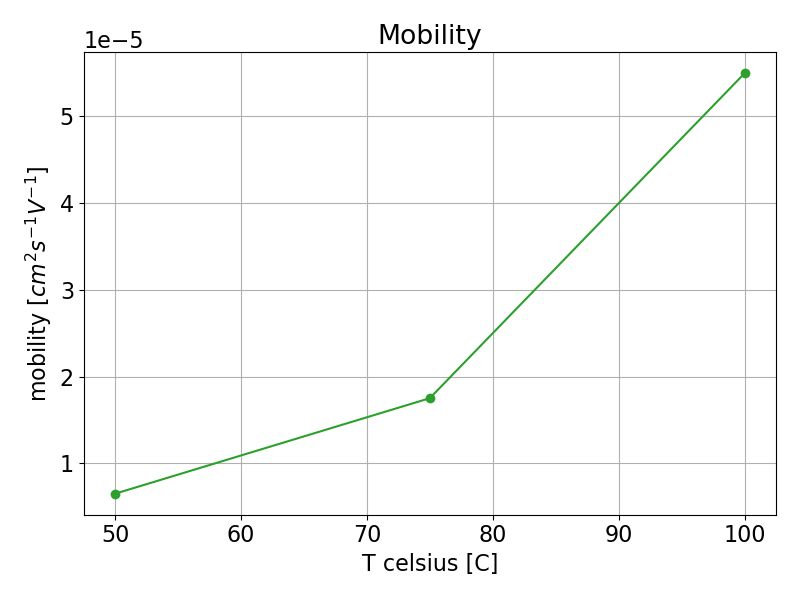

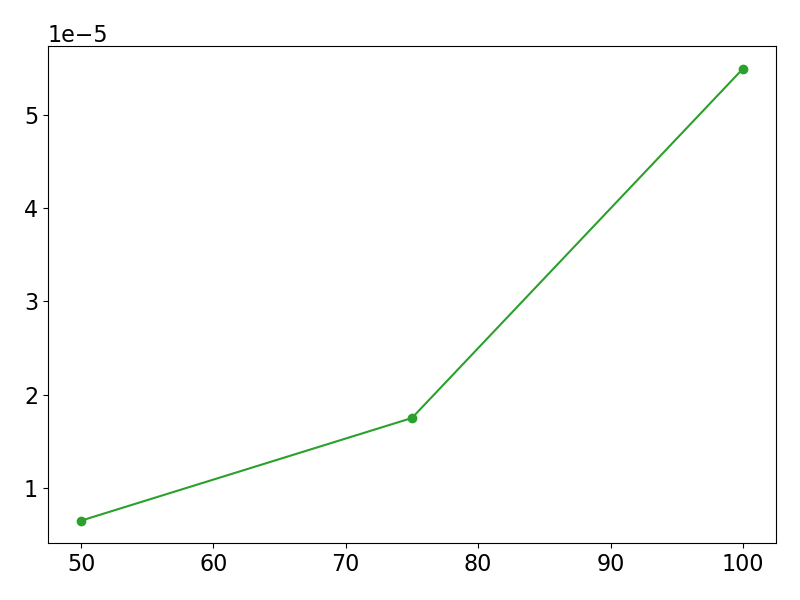

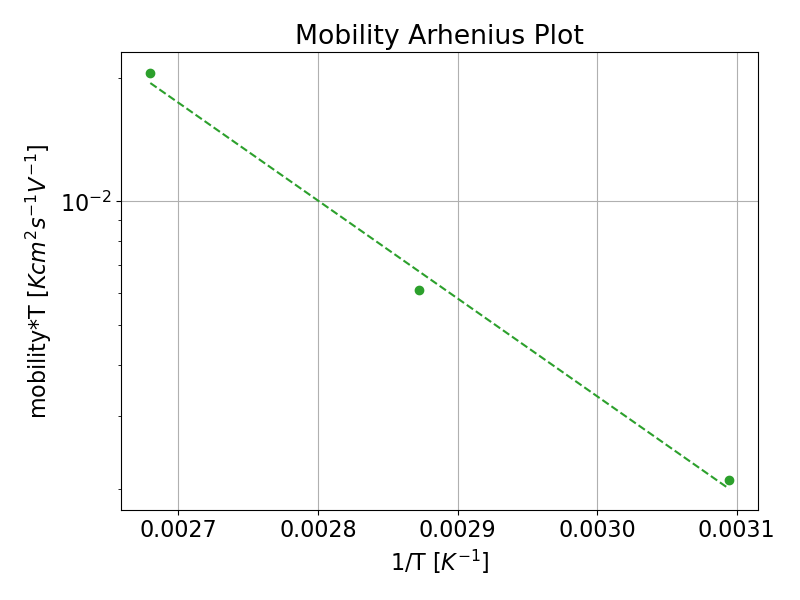

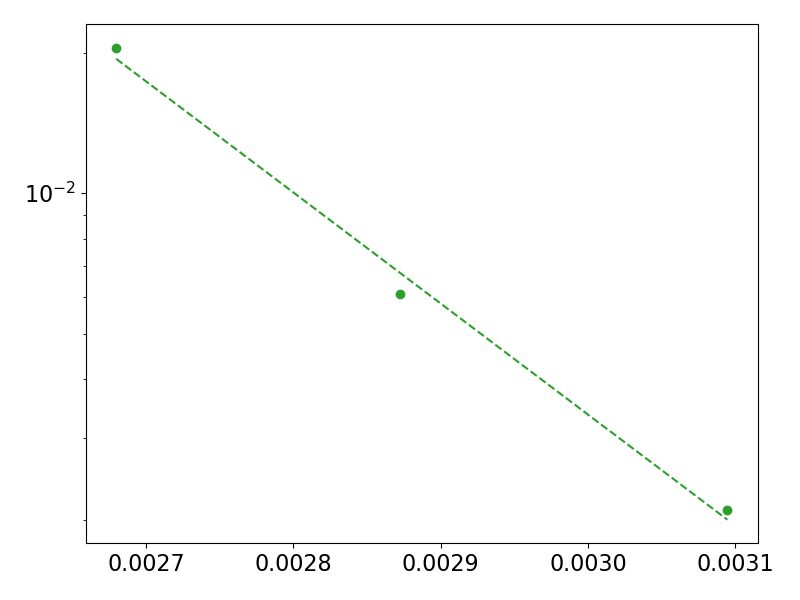

In [341]:
figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        
        x = data[spec['x_axis']]
        y = data[spec['y_axis']]
        if 'abs' in spec and spec['abs']:
            y = y.abs()
        if spec['xlim'].size:
            mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
            x = x[mask]
            y = y[mask]

        color = color_map(cmap, i)
        y_factor = spec['yfactor']
        if spec['scatter']:
            axs.scatter(x, y*y_factor, color=color, marker='o')
            axs_no_labels.scatter(x, y*y_factor, color=color, marker='o');
        else:
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], marker='o')
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], marker='o');
        
        if spec['plot_fit']:
            axs.plot(x_fit, y_fit*y_factor, color=color, linestyle='--')
            axs_no_labels.plot(x_fit, y_fit*y_factor, color=color, linestyle='--');
            
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = spec['title']
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [342]:
save_figures(figures, figures_no_labels, figure_specs, [0], directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-02-29_134841_c3x3_d5x4_Mobility
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 r
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-02-29_134841_c3x3_d5x4_Mobility_Arhenius_Plot_ylog
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 r


## IV

In [381]:
selection = [28, 30, 31, 33, 34, 35, 36, 38]
selection = [35, 38, 31, 36]

chosen_sel = None
chosen_sel = 'cleaned_selection'


In [382]:
print(selection)

[35, 38, 31, 36]


### Plot Setup 

In [383]:
plot_selection = []
if chosen_sel is not None:
    for idx in selection:
        plot_selection += an.manipulated_selections[chosen_sel][idx]
else:
    plot_selection = selection
    
#plot_selection = ['10_split_0', '10_split_1', '10_split_2', '10_split_3', '10_split_4']
    
plot_selection

['35_cleaned_cleaned_cleaned',
 '38_cleaned_cleaned_cleaned',
 '31_cleaned_cleaned_cleaned',
 '36_cleaned_cleaned_cleaned']

In [387]:
figsize = (8,6)

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i)%10)
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Source': '[V]', 'Current': '[nA]'}

#legend_template = 'P365={P365}, V={V_end} ({timestamp:%H:%M})'
legend_template = 'T={T}, ({timestamp:%H:%M})'
legend_labels = []

#legend_pos = 'outside'
legend_pos = 'best'
figsize_factor = 0.5

title_template = 'IV {cluster} {device}'
#title_template = 'DC'


figure_specs = [
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Source',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Source',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    
]   

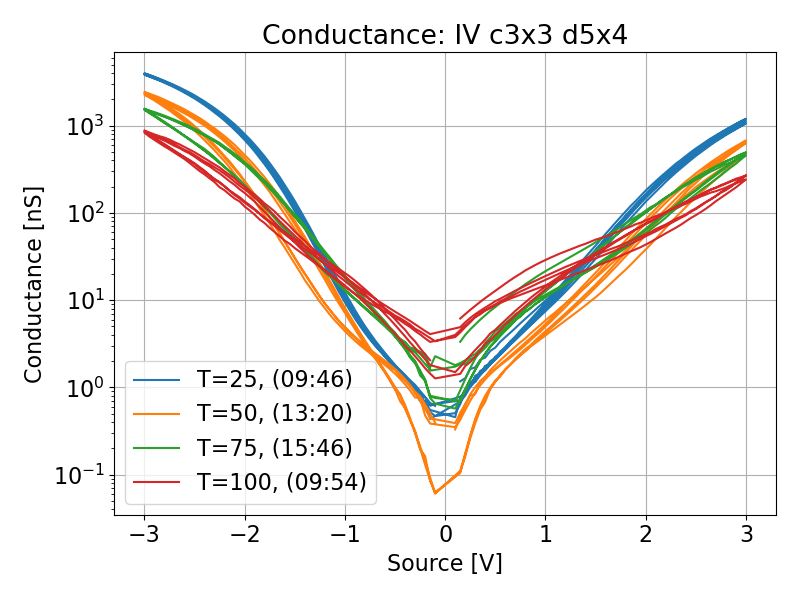

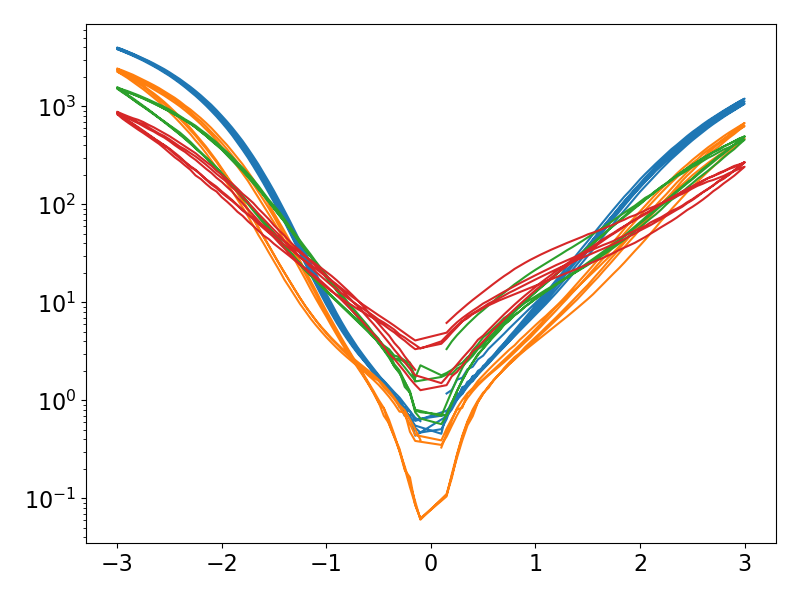

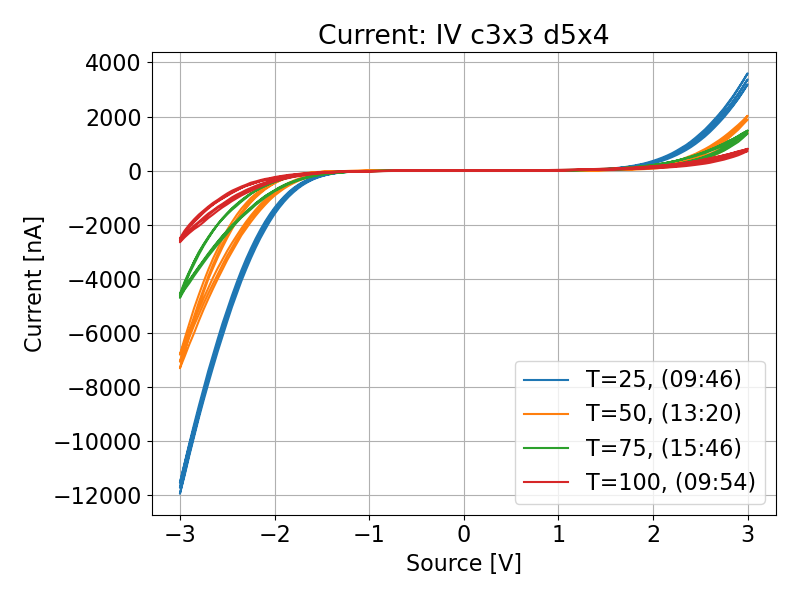

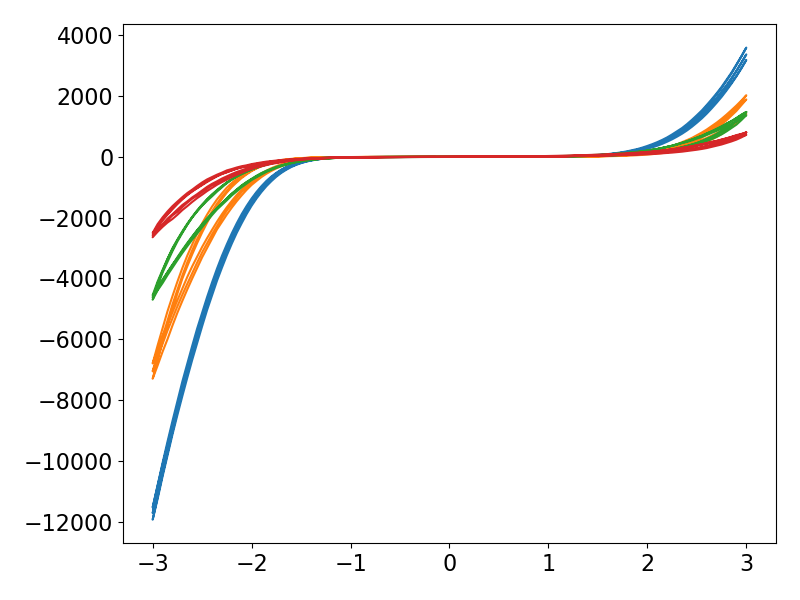

In [388]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data']      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            label = _parse_template(m, spec['legend_template'])
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label)
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);
            
        
        legend_kwargs = {}
        if legend_pos == 'outside':
            legend_kwargs['bbox_to_anchor'] = (1,1)
        else:
            legend_kwargs['loc'] = legend_pos
        
        if legend_labels:
            axs.legend(legend_labels, **legend_kwargs)
        else:
            axs.legend(**legend_kwargs)
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [389]:
save_figures(figures, figures_no_labels, figure_specs, selection, directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-07_094640_c3x3_d5x4_Conductance_IV_c3x3_d5x4_ylog
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 y
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-07_094640_c3x3_d5x4_Current_IV_c3x3_d5x4
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 y


# Plot c3x3_d5x4 T=50 UV

## DC 

In [60]:
selection = [29, 40]

chosen_sel = None
#chosen_sel = 'split_selections'

chosen_splits = [1]

### Plot Setup 

In [61]:
plot_selection = []
if chosen_sel is not None:
    for idx in selection:
        plot_selection += [an.manipulated_selections[chosen_sel][idx][split_i] for split_i in chosen_splits]
else:
    plot_selection = selection
    
#plot_selection = ['10_split_0', '10_split_1', '10_split_2', '10_split_3', '10_split_4']
    
plot_selection

[29, 40]

In [64]:
figsize = (8,6)

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i)%10)
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}

#legend_template = 'P365={P365}, V={V_end} ({timestamp:%H:%M})'
legend_template = 'T={T} ({timestamp:%H:%M})'
legend_labels = []

#legend_pos = 'outside'
legend_pos = 'best'
figsize_factor = 0.5

title_template = 'DC {cluster} {device}'
#title_template = 'DC'


figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([0, 20e-9]), # [0, 15e-9]
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    
]   

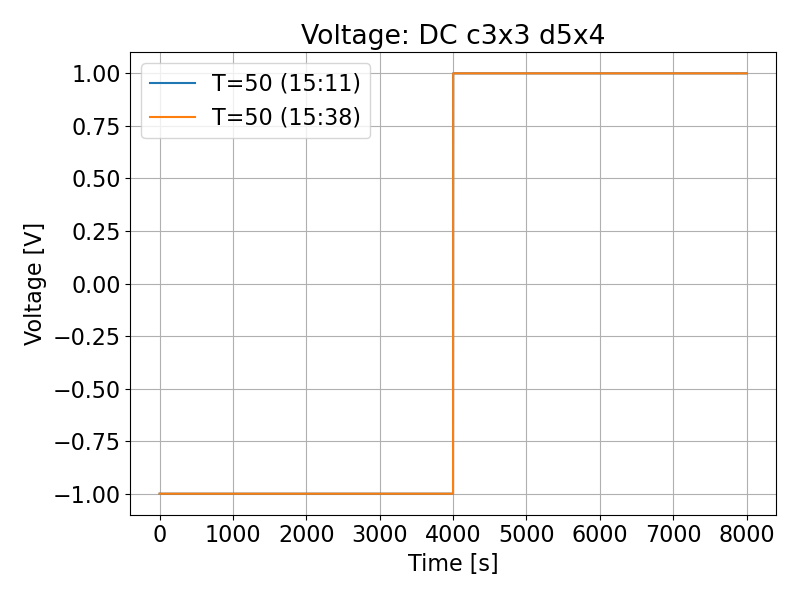

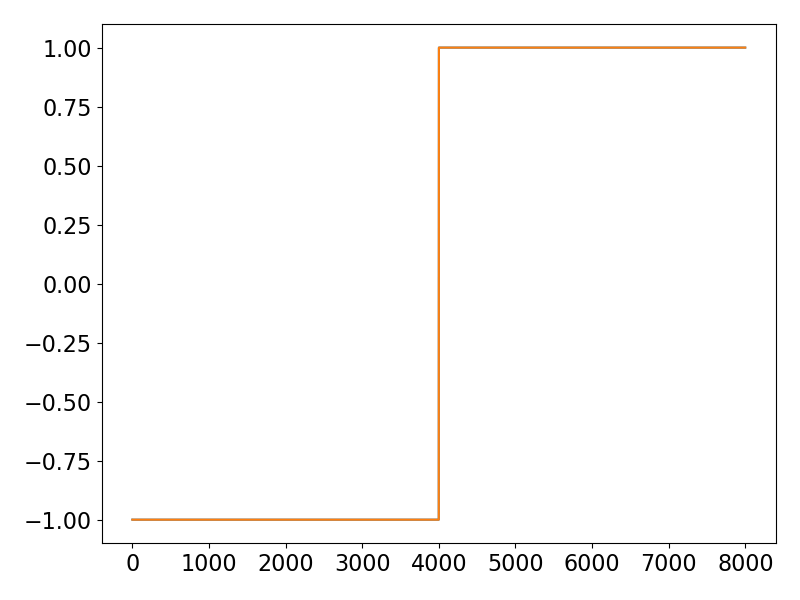

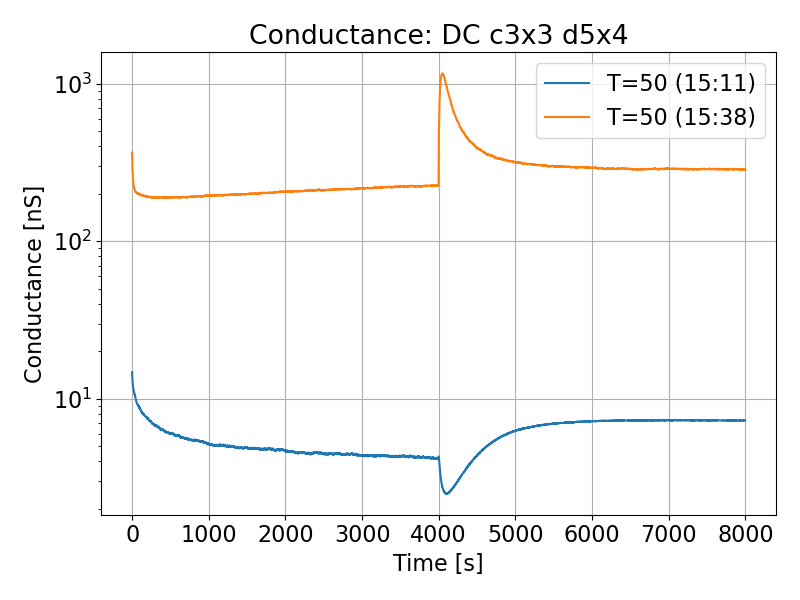

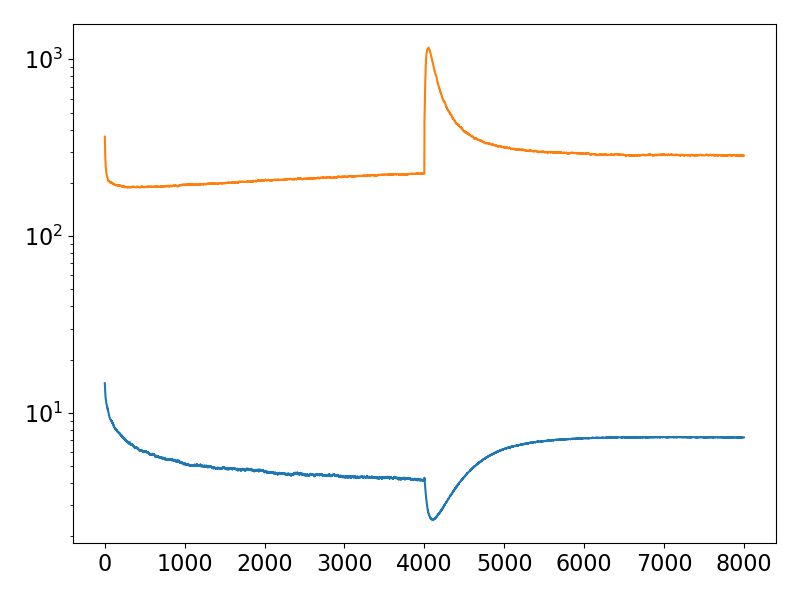

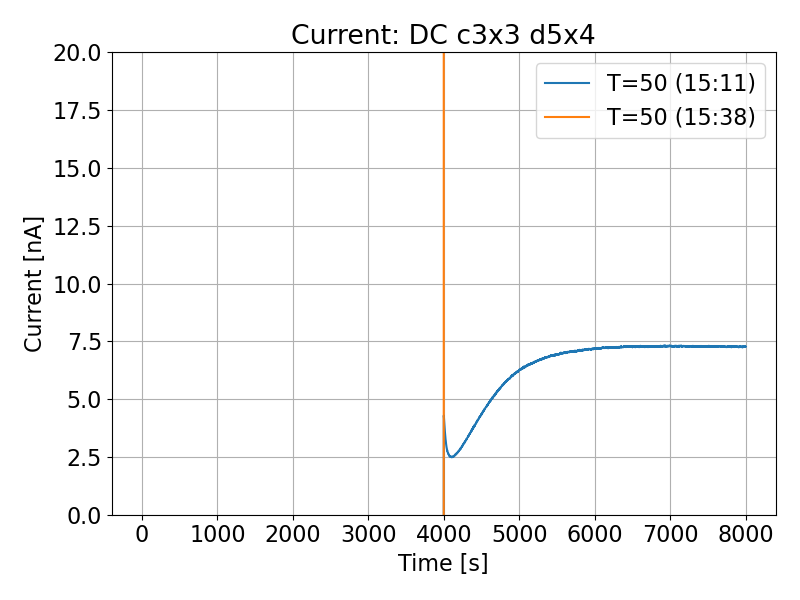

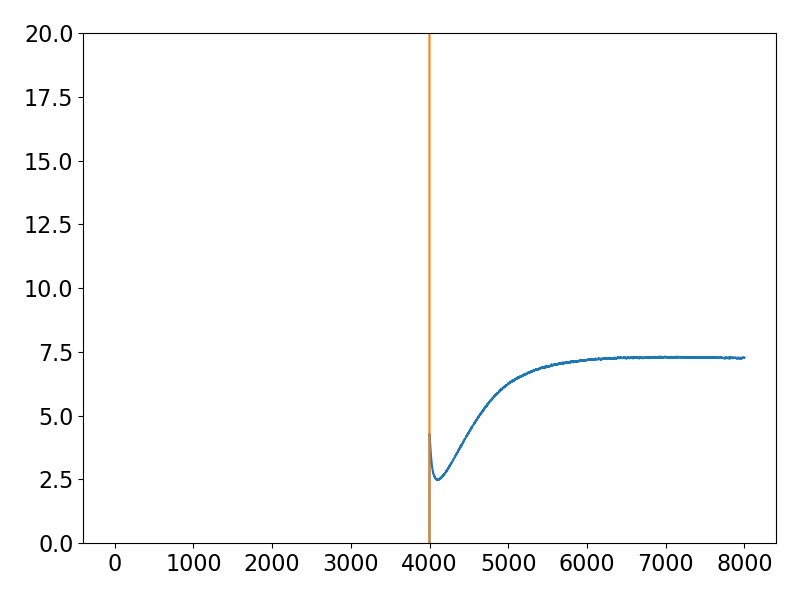

In [65]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data']      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            label = _parse_template(m, spec['legend_template'])
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label)
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);
            
        
        legend_kwargs = {}
        if legend_pos == 'outside':
            legend_kwargs['bbox_to_anchor'] = (1,1)
        else:
            legend_kwargs['loc'] = legend_pos
        
        if legend_labels:
            axs.legend(legend_labels, **legend_kwargs)
        else:
            axs.legend(**legend_kwargs)
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [41]:
save_figures(figures, figures_no_labels, figure_specs, selection, directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-06_151136_c3x3_d5x4_Voltage_DC_c3x3_d5x4
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 r
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-06_151136_c3x3_d5x4_Conductance_DC_c3x3_d5x4_xlog_ylog
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 r
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-06_151136_c3x3_d5x4_Current_DC_c3x3_d5x4_xlog_y=0E+00_to_2E-08


## IV

In [118]:
selection = [2, 16, 18]
selection = [22, 24, 33, 35]

chosen_sel = None
chosen_sel = 'cleaned_selection'


In [119]:
print(selection)

[22, 24, 26, 33, 35]


### Plot Setup 

In [120]:
plot_selection = []
if chosen_sel is not None:
    for idx in selection:
        plot_selection += an.manipulated_selections[chosen_sel][idx]
else:
    plot_selection = selection
    
#plot_selection = ['10_split_0', '10_split_1', '10_split_2', '10_split_3', '10_split_4']
    
plot_selection

KeyError: 24

In [121]:
figsize = (8,6)

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i)%10)
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Source': '[V]', 'Current': '[nA]'}

#legend_template = 'P365={P365}, V={V_end} ({timestamp:%H:%M})'
legend_template = 'T={T}, ({timestamp:%H:%M})'
legend_labels = []

#legend_pos = 'outside'
legend_pos = 'best'
figsize_factor = 0.5

title_template = 'IV {cluster} {device}'
#title_template = 'DC'


figure_specs = [
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Source',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Source',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    
]   

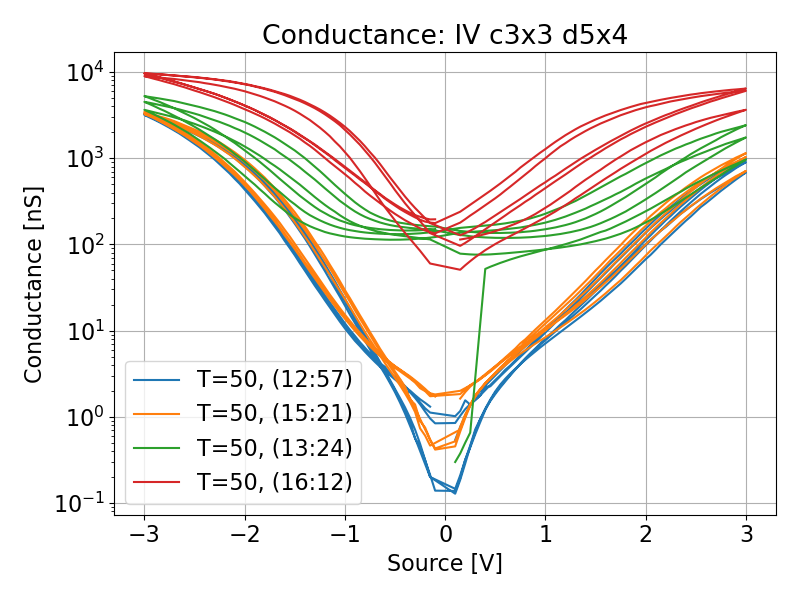

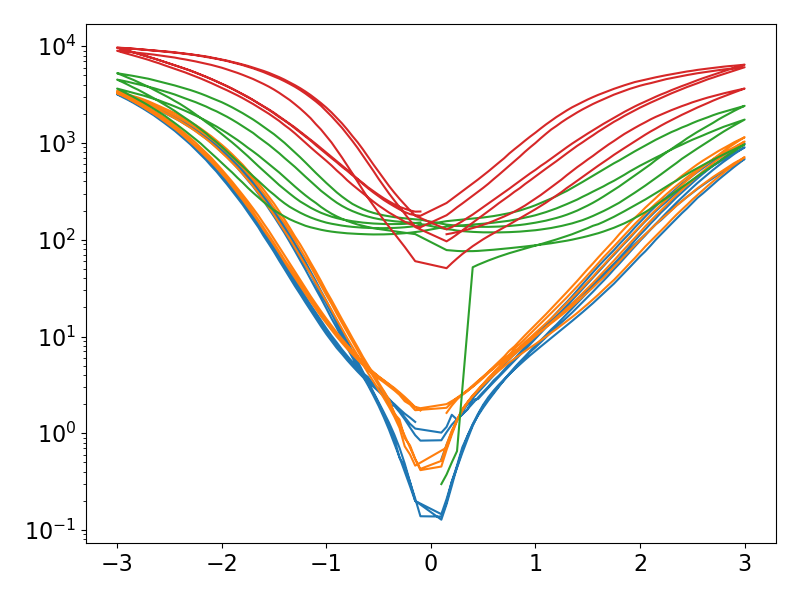

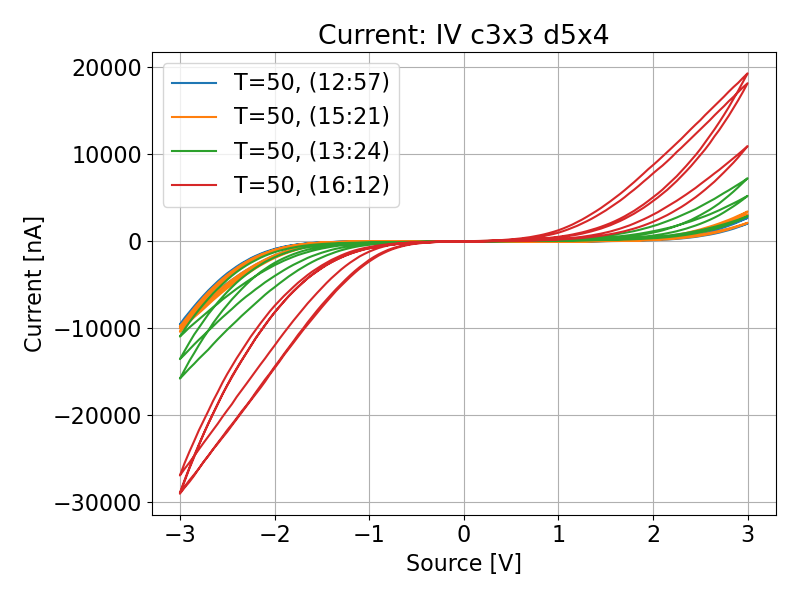

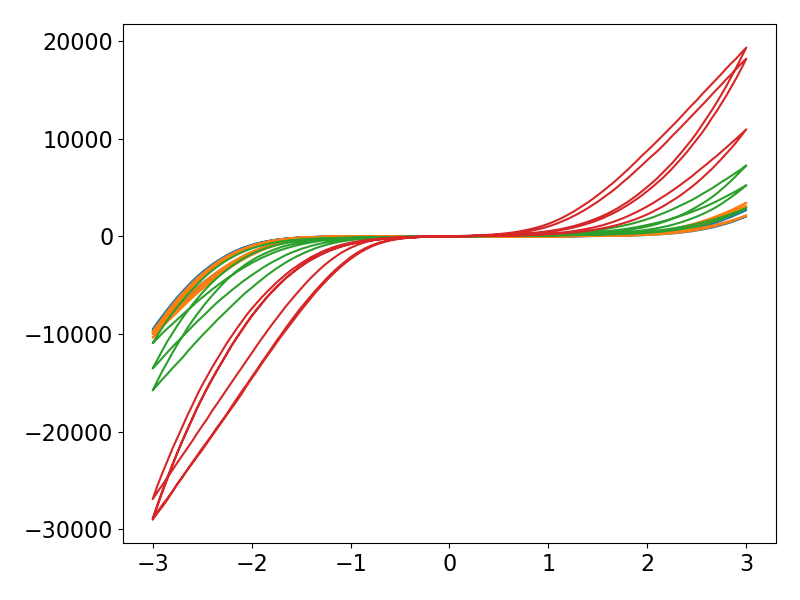

In [122]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data']      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            label = _parse_template(m, spec['legend_template'])
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label)
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);
            
        
        legend_kwargs = {}
        if legend_pos == 'outside':
            legend_kwargs['bbox_to_anchor'] = (1,1)
        else:
            legend_kwargs['loc'] = legend_pos
        
        if legend_labels:
            axs.legend(legend_labels, **legend_kwargs)
        else:
            axs.legend(**legend_kwargs)
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [47]:
save_figures(figures, figures_no_labels, figure_specs, selection, directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-06_125749_c3x3_d5x4_Conductance_IV_c3x3_d5x4_ylog
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 r
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x3_d5x4/2024-03-06_125749_c3x3_d5x4_Current_IV_c3x3_d5x4
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 r


# Plot c3x2_d5x4 T=50, 75, 100 UV

## DC 

In [48]:
selection = [16, 19, 47, 50, 63, 101, 119]

chosen_sel = None
chosen_sel = 'split_selections'

chosen_splits = [2]

### Plot Setup 

In [49]:
plot_selection = []
if chosen_sel is not None:
    for idx in selection:
        plot_selection += [an.manipulated_selections[chosen_sel][idx][split_i] for split_i in chosen_splits]
else:
    plot_selection = selection
    
#plot_selection = ['10_split_0', '10_split_1', '10_split_2', '10_split_3', '10_split_4']
    
plot_selection

['16_split_2',
 '19_split_2',
 '47_split_2',
 '50_split_2',
 '63_split_2',
 '101_split_2',
 '119_split_2']

In [55]:
figsize = (8,6)

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i)%10)
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}

#legend_template = 'P365={P365}, V={V_end} ({timestamp:%H:%M})'
legend_template = 'T={T} ({timestamp:%H:%M})'
legend_labels = []

legend_pos = 'outside'
#legend_pos = 'best'
figsize_factor = 0.5

title_template = 'DC {cluster} {device}'
#title_template = 'DC'

xlims = [0, 500]

figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlims),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'log',
        'yscale': 'log',
        'xlim': np.array(xlims),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'log',
        'yscale': 'linear',
        'xlim': np.array(xlims),
        'ylim': np.array([]), # [0, 15e-9]
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    
]   

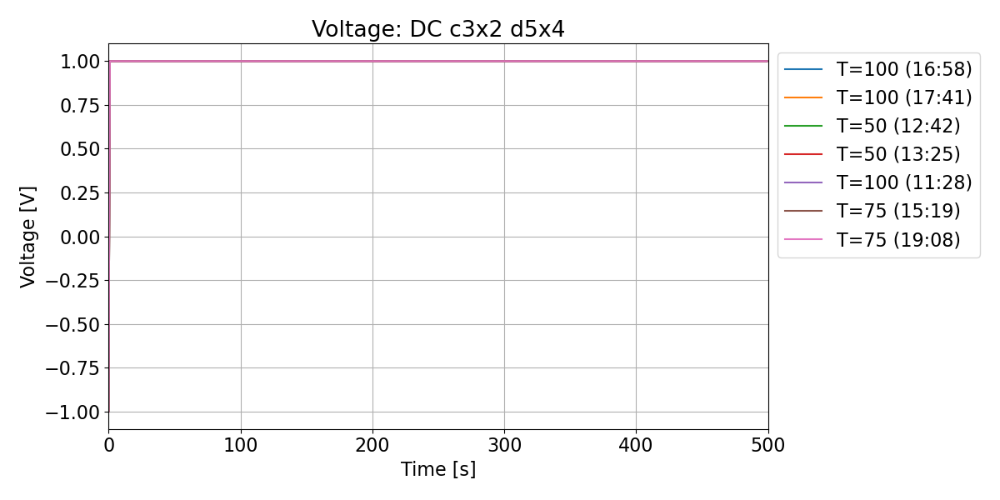

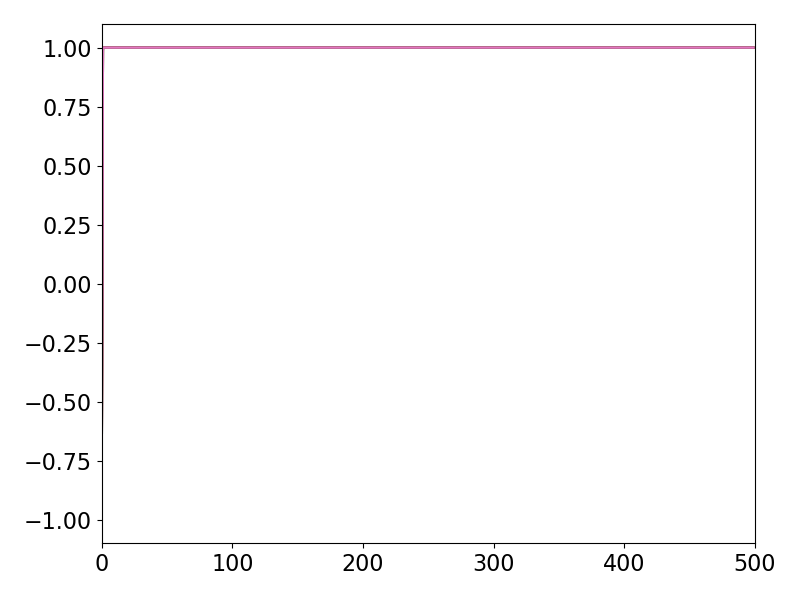

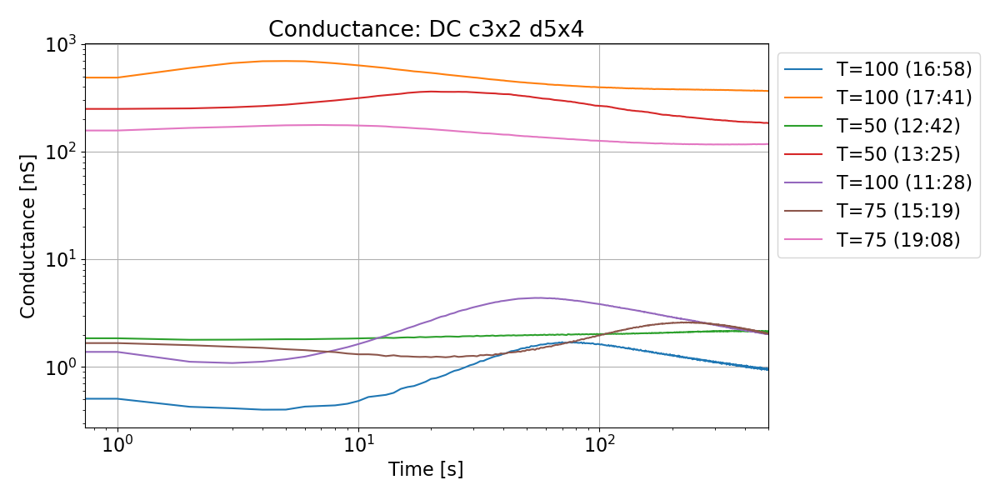

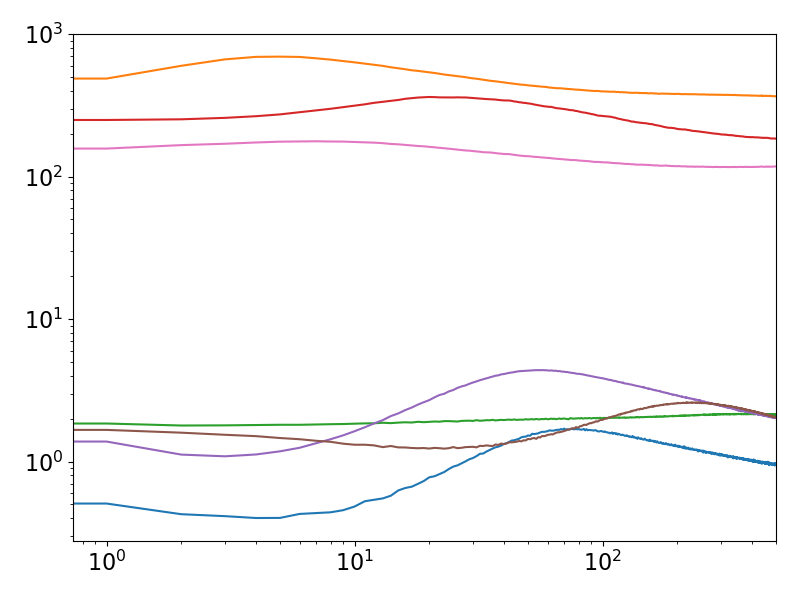

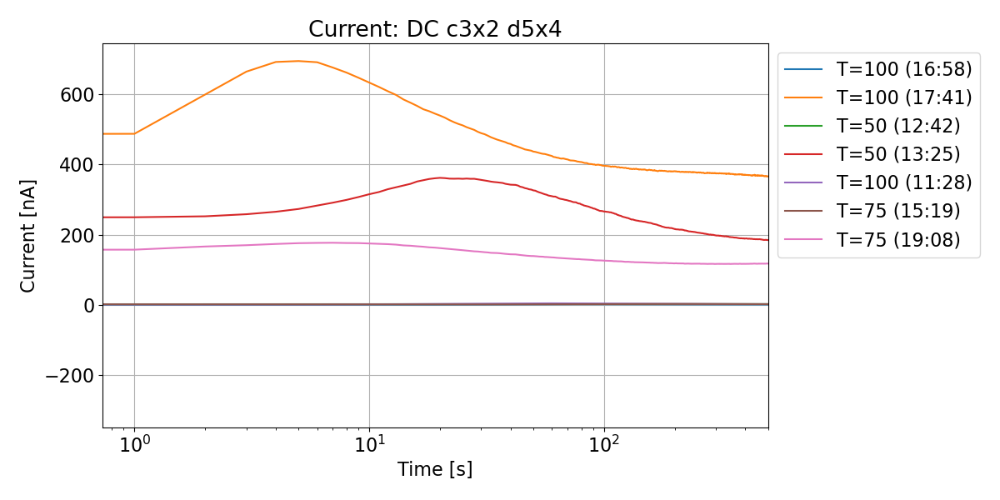

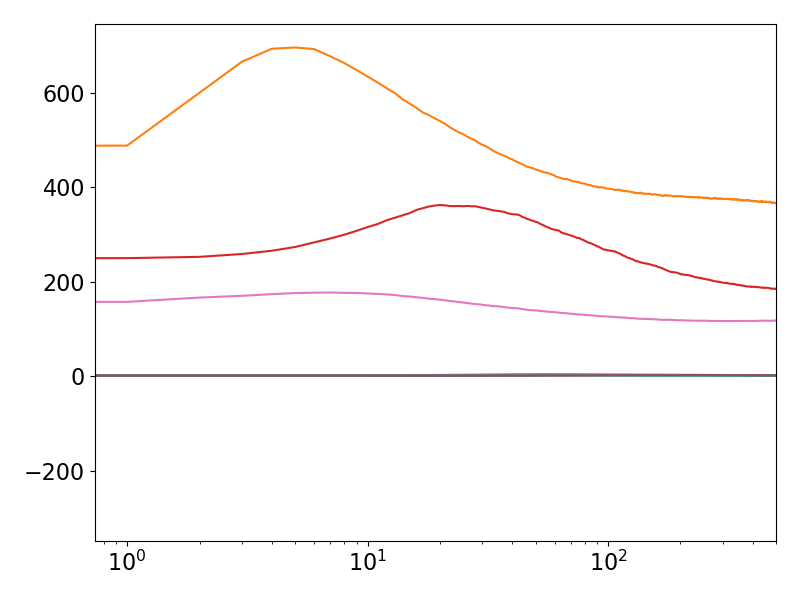

In [56]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data']      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            label = _parse_template(m, spec['legend_template'])
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label)
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);
            
        
        legend_kwargs = {}
        if legend_pos == 'outside':
            legend_kwargs['bbox_to_anchor'] = (1,1)
        else:
            legend_kwargs['loc'] = legend_pos
        
        if legend_labels:
            axs.legend(legend_labels, **legend_kwargs)
        else:
            axs.legend(**legend_kwargs)
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [57]:
save_figures(figures, figures_no_labels, figure_specs, selection, directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x2_d5x4/2024-03-01_164133_c3x2_d5x4_Voltage_DC_c3x2_d5x4_x=0E+00_to_5E+02
Should file be overwritten: yes[y] / no [n] / no to all [nn] / yes to all [yy] / rename [r]:
 r
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x2_d5x4/2024-03-01_164133_c3x2_d5x4_Conductance_DC_c3x2_d5x4_xlog_ylog_x=0E+00_to_5E+02
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x2_d5x4/2024-03-01_164133_c3x2_d5x4_Current_DC_c3x2_d5x4_xlog_x=0E+00_to_5E+02


## IV

In [109]:
selection = [15, 45, 62, 100]

chosen_sel = None
chosen_sel = 'cleaned_selection'


In [110]:
print(selection)

[15, 45, 62, 100]


### Plot Setup 

In [111]:
plot_selection = []
if chosen_sel is not None:
    for idx in selection:
        plot_selection += an.manipulated_selections[chosen_sel][idx]
else:
    plot_selection = selection
    
#plot_selection = ['10_split_0', '10_split_1', '10_split_2', '10_split_3', '10_split_4']
    
plot_selection

['15_cleaned_cleaned_cleaned',
 '45_cleaned_cleaned_cleaned',
 '62_cleaned_cleaned_cleaned',
 '100_cleaned_cleaned_cleaned']

In [112]:
figsize = (8,6)

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i)%10)
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Source': '[V]', 'Current': '[nA]'}

#legend_template = 'P365={P365}, V={V_end} ({timestamp:%H:%M})'
legend_template = 'T={T}, ({timestamp:%H:%M})'
legend_labels = []

#legend_pos = 'outside'
legend_pos = 'best'
figsize_factor = 0.5

title_template = 'IV {cluster} {device}'
#title_template = 'DC'


figure_specs = [
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Source',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Source',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    
]   

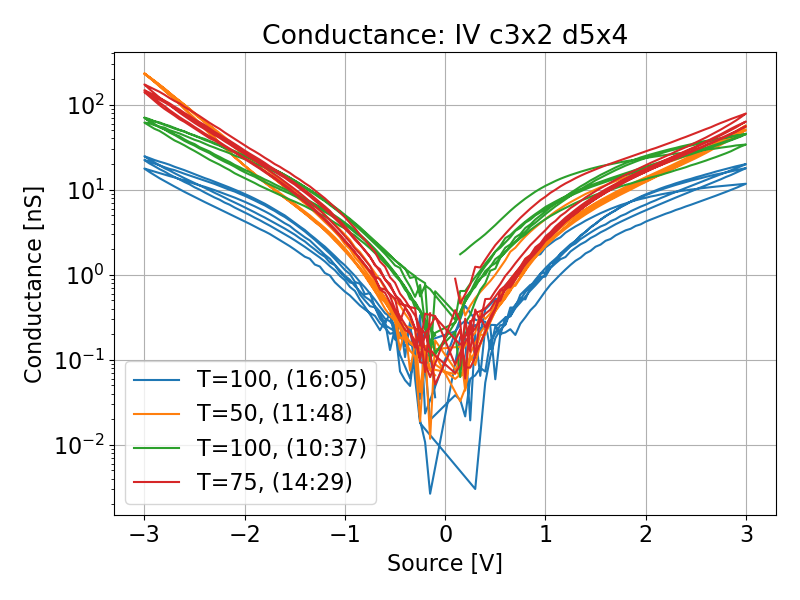

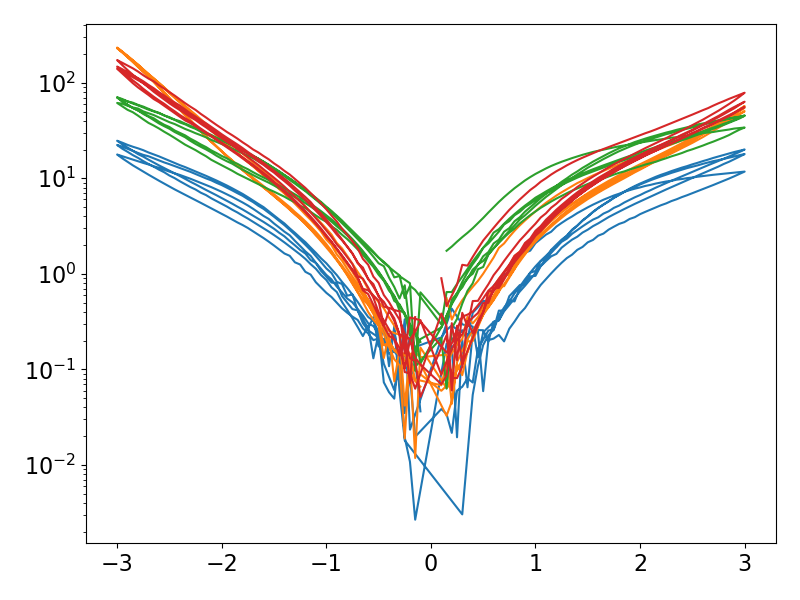

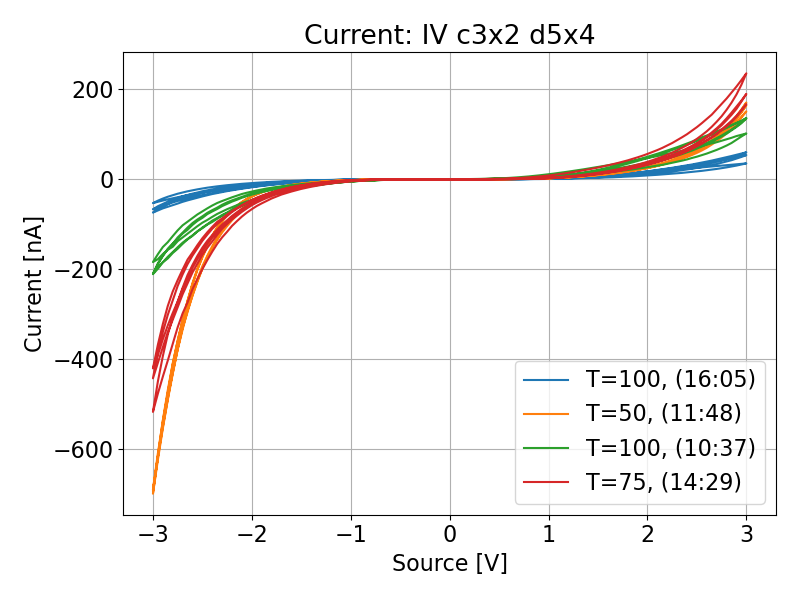

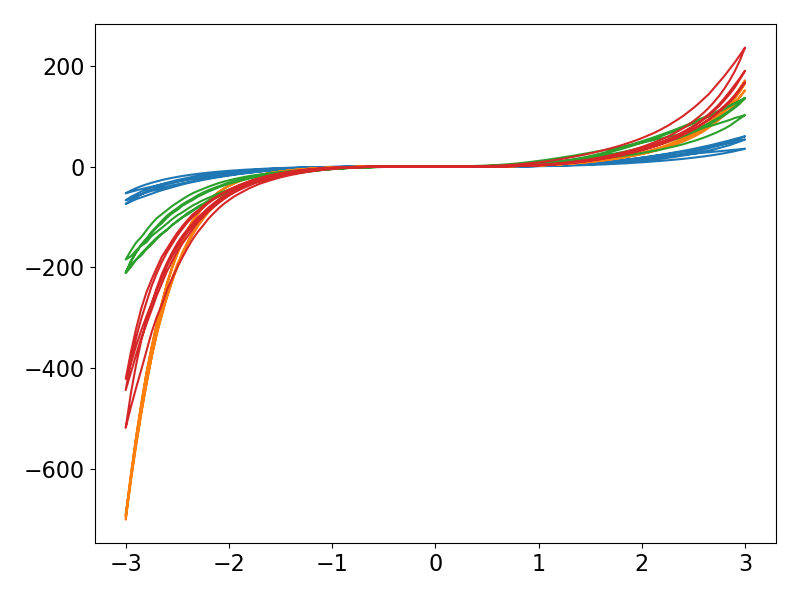

In [113]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data']      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            label = _parse_template(m, spec['legend_template'])
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label)
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);
            
        
        legend_kwargs = {}
        if legend_pos == 'outside':
            legend_kwargs['bbox_to_anchor'] = (1,1)
        else:
            legend_kwargs['loc'] = legend_pos
        
        if legend_labels:
            axs.legend(legend_labels, **legend_kwargs)
        else:
            axs.legend(**legend_kwargs)
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [114]:
save_figures(figures, figures_no_labels, figure_specs, selection, directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x2_d5x4/2024-03-01_160559_c3x2_d5x4_Conductance_IV_c3x2_d5x4_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x2_d5x4/2024-03-01_160559_c3x2_d5x4_Current_IV_c3x2_d5x4


# Plot c3x2_d5x4 T=75 UV

## DC 

In [209]:
# concat 119
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    an.set_selection(['119_split_0', '119_split_1', '119_split_2', '119_split_3']) 
    an.concat_selection_in_time(no_gap=no_gap, result_name='119_split_concat')

In [210]:
selection = ['100_cleaned_cleaned_cleaned', 101, '102_cleaned_cleaned_cleaned', '115_cleaned_cleaned_cleaned', 119, '120_cleaned_cleaned_cleaned']
selection = ['100_cleaned_cleaned_cleaned', 101, '102_cleaned_cleaned_cleaned', '115_cleaned_cleaned_cleaned', '119_split_4', '120_cleaned_cleaned_cleaned']
selection = ['100_cleaned_cleaned_cleaned', 101, '102_cleaned_cleaned_cleaned', '115_cleaned_cleaned_cleaned', '119_split_concat', '119_split_4_trig', '120_cleaned_cleaned_cleaned']

chosen_sel = None
#chosen_sel = 'split_selections'

chosen_splits = [1]

concat = True
no_gap = True

### Plot Setup 

In [211]:
plot_selection = []
if chosen_sel is not None:
    for idx in selection:
        plot_selection += [an.manipulated_selections[chosen_sel][idx][split_i] for split_i in chosen_splits]
else:
    plot_selection = selection
    
#plot_selection = ['10_split_0', '10_split_1', '10_split_2', '10_split_3', '10_split_4']
    
plot_selection

['100_cleaned_cleaned_cleaned',
 101,
 '102_cleaned_cleaned_cleaned',
 '115_cleaned_cleaned_cleaned',
 '119_split_concat',
 '119_split_4_trig',
 '120_cleaned_cleaned_cleaned']

In [212]:
if concat: 
    with warnings.catch_warnings():
        warnings.simplefilter('ignore')
        an.set_selection(plot_selection) 
        plot_selection = an.concat_selection_in_time(no_gap=no_gap)
        print(plot_selection)

['100_cleaned_cleaned_cleaned_shifted', '101_shifted', '102_cleaned_cleaned_cleaned_shifted', '115_cleaned_cleaned_cleaned_shifted', '119_split_concat_shifted', '119_split_4_trig_shifted', '120_cleaned_cleaned_cleaned_shifted']


In [213]:
figsize = (8,6)

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i)%10)
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Current': '[nA]'}

#legend_template = 'P365={P365}, V={V_end} ({timestamp:%H:%M})'
legend_template = 'T={T} P365={P365} ({timestamp:%H:%M})'
legend_labels = ['P365=0', 'P365=0', 'P365=0', 'P365=20', 'P365=20', 'P365=0', 'P365=0']

legend_pos = 'outside'
#legend_pos = 'best'
figsize_factor = 0.5

title_template = 'DC {cluster} {device} (T=75°C)'
#title_template = 'DC'

xlims = []

figure_specs = [
    {
        'title': 'Voltage: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Voltage',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlims),
        'ylim': np.array([]),
        'yfactor': 1,
        'legend_template': legend_template
    },
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array(xlims),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Time',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array(xlims),
        'ylim': np.array([]), # [0, 15e-9]
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    
]   

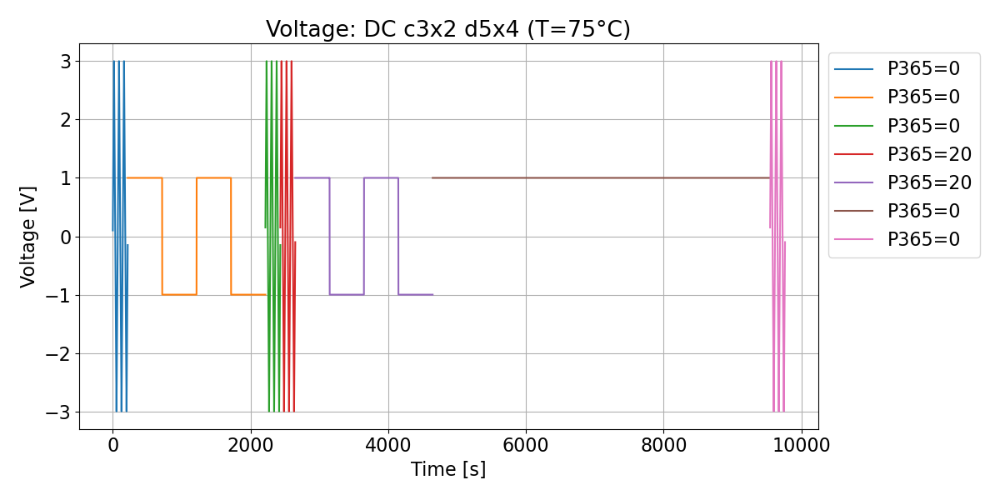

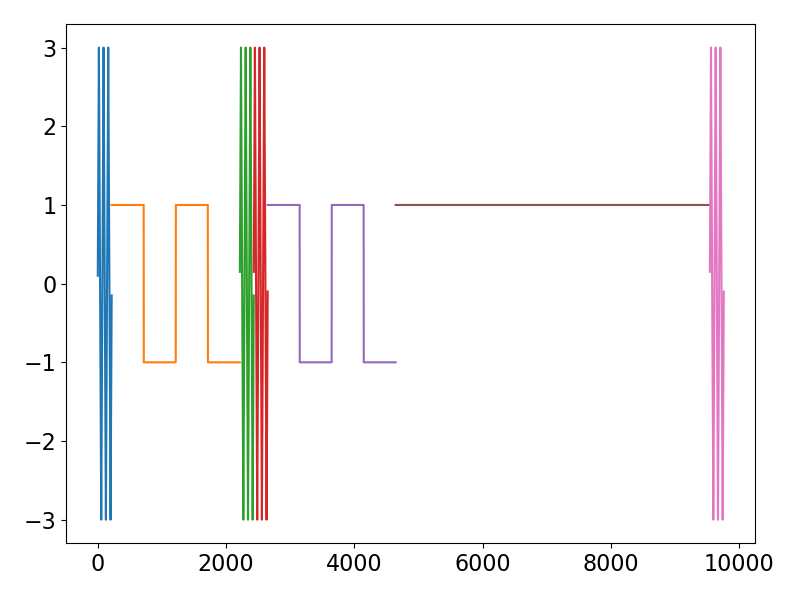

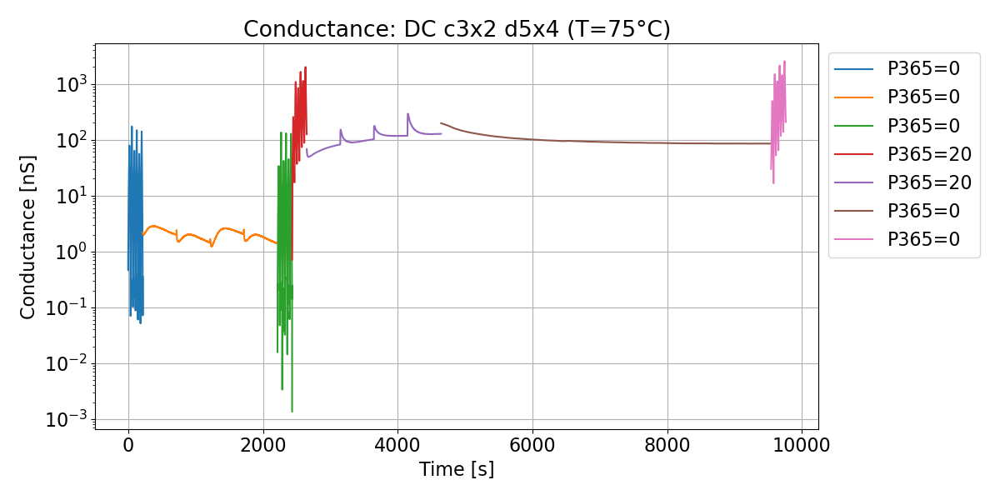

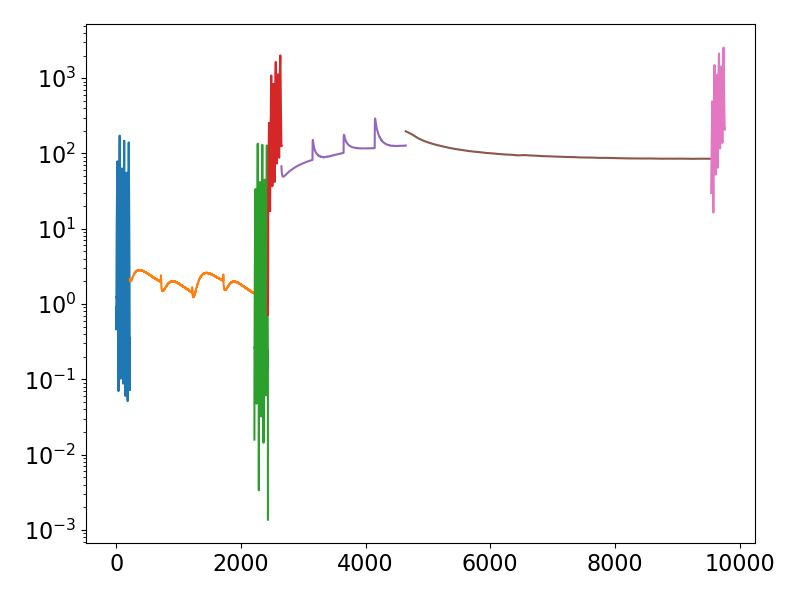

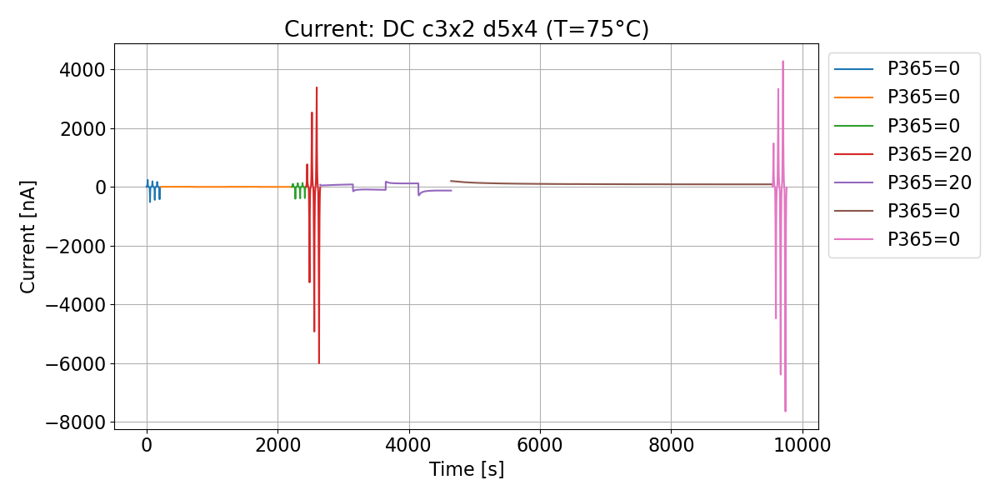

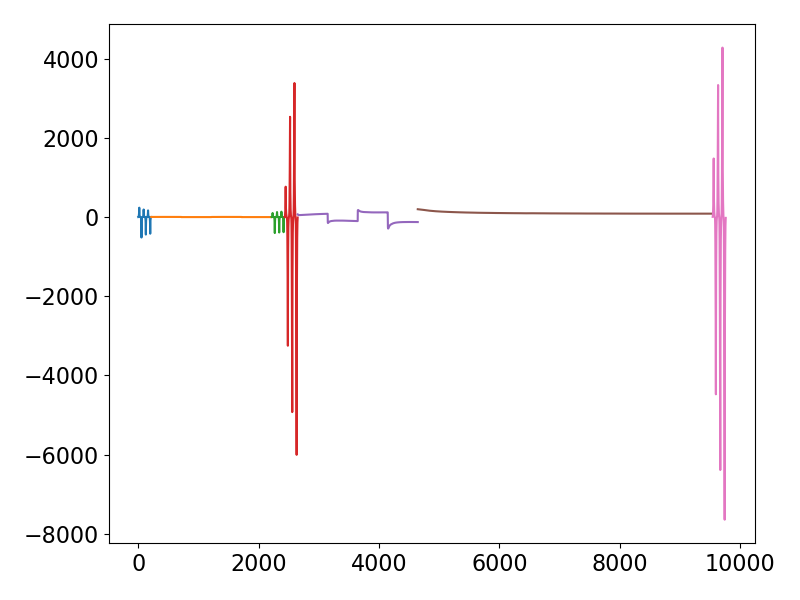

In [214]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data']      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            label = _parse_template(m, spec['legend_template'])
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label)
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);
            
        
        legend_kwargs = {}
        if legend_pos == 'outside':
            legend_kwargs['bbox_to_anchor'] = (1,1)
        else:
            legend_kwargs['loc'] = legend_pos
        
        if legend_labels:
            axs.legend(legend_labels, **legend_kwargs)
        else:
            axs.legend(**legend_kwargs)
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [215]:
save_figures(figures, figures_no_labels, figure_specs, selection, directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x2_d5x4/2024-03-11_142906_c3x2_d5x4_Voltage_DC_c3x2_d5x4_T=75°C
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x2_d5x4/2024-03-11_142906_c3x2_d5x4_Conductance_DC_c3x2_d5x4_T=75°C_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x2_d5x4/2024-03-11_142906_c3x2_d5x4_Current_DC_c3x2_d5x4_T=75°C


## IV

In [216]:
selection = [115, 120]

chosen_sel = None
chosen_sel = 'cleaned_selection'


In [217]:
print(selection)

[115, 120]


### Plot Setup 

In [218]:
plot_selection = []
if chosen_sel is not None:
    for idx in selection:
        plot_selection += an.manipulated_selections[chosen_sel][idx]
else:
    plot_selection = selection
    
#plot_selection = ['10_split_0', '10_split_1', '10_split_2', '10_split_3', '10_split_4']
    
plot_selection

['115_cleaned_cleaned_cleaned', '120_cleaned_cleaned_cleaned']

In [221]:
figsize = (8,6)

font = {'weight' : 'normal',
        'size'   : 16}
        
plt.rc('font', **font)

cmap = plt.cm.get_cmap('tab10')
colors = plt.cm.hsv(np.linspace(0,1,4))

def color_map(cmap, i):
    # mapping = list(range(10))
    # mapping = [2, 3, 2, 3]
    mapping = [0,1,2,3,0,1,2,3]
    mapping = None
    if mapping is None:
        return cmap(int(i)%10)
    else:      
        return cmap(mapping[int(i)])

# def color_map(cmap, i):
#     return colors[i]


linestyle_map = ['-']*100
#linestyle_map = ['--', '--', '-', '-', '-', '--', '-', '--', '-', '--']

y_factor = 1e9

units = {'Conductance': '[nS]', 'Time': '[s]', 'Voltage': '[V]', 'Source': '[V]', 'Current': '[nA]'}

#legend_template = 'P365={P365}, V={V_end} ({timestamp:%H:%M})'
legend_template = 'T={T}, P365={P365} ({timestamp:%H:%M})'
legend_labels = []

#legend_pos = 'outside'
legend_pos = 'best'
figsize_factor = 0.5

title_template = 'IV {cluster} {device}'
#title_template = 'DC'


figure_specs = [
    {
        'title': 'Conductance: ' + title_template,
        'x_axis': 'Source',
        'y_axis': 'Conductance',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'log',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    {
        'title': 'Current: ' + title_template,
        'x_axis': 'Source',
        'y_axis': 'Current',
        'abs': False,
        'xscale': 'linear',
        'yscale': 'linear',
        'xlim': np.array([]),
        'ylim': np.array([]),
        'yfactor': y_factor,
        'legend_template': legend_template
    },
    
]   

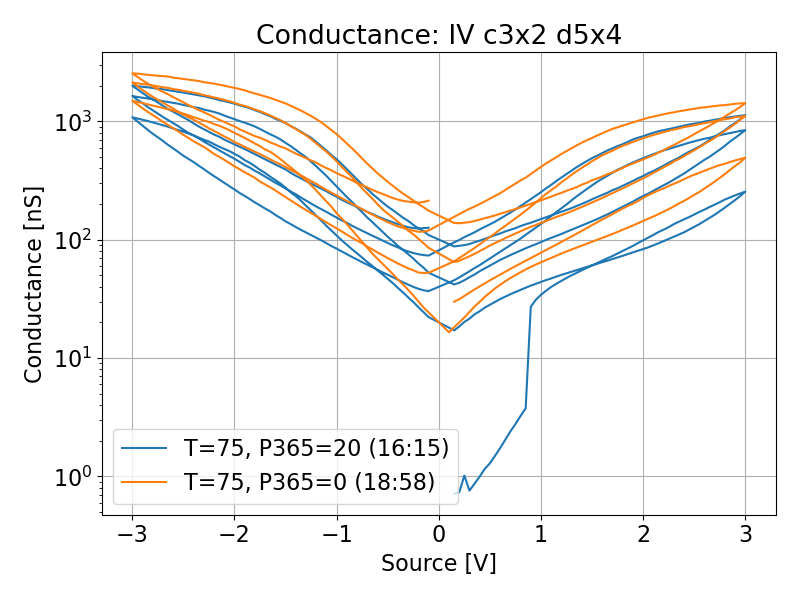

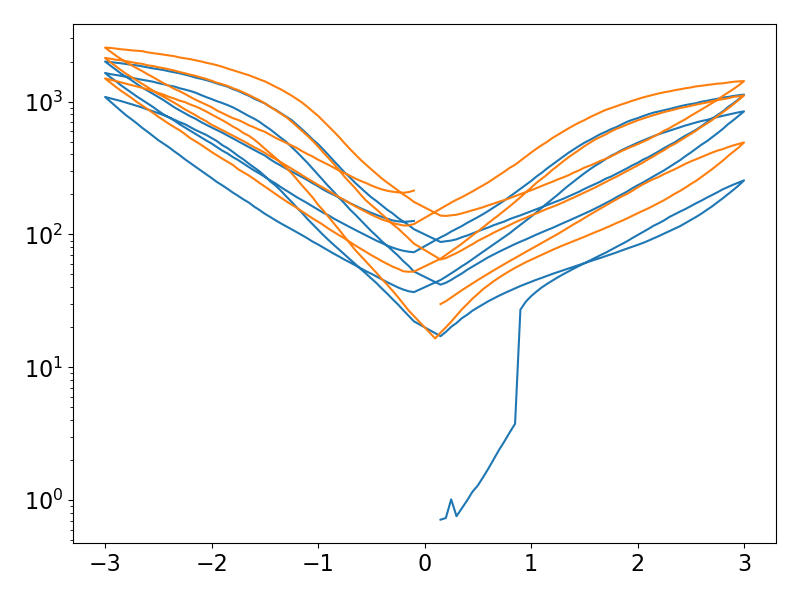

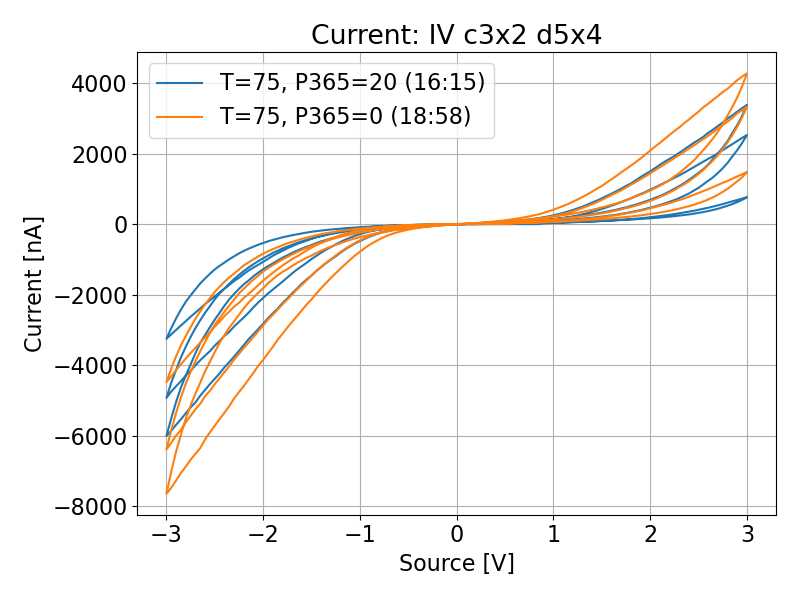

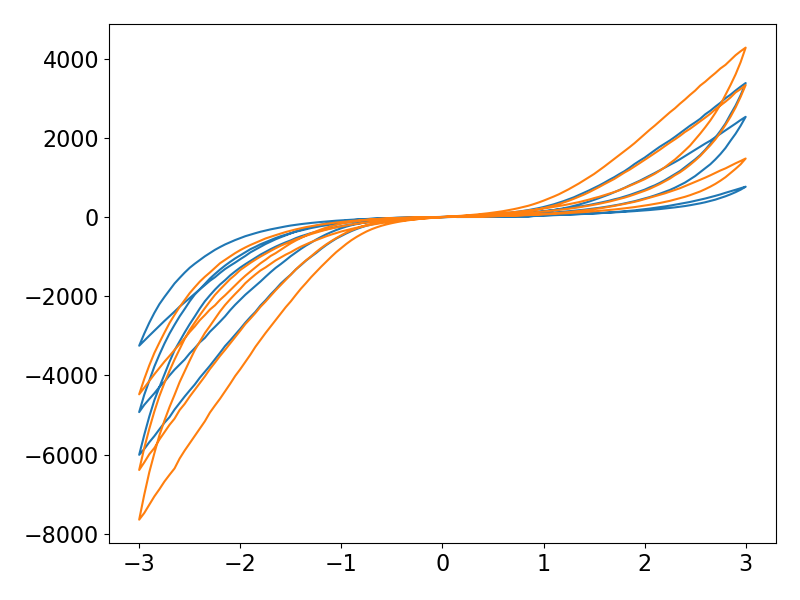

In [222]:
import warnings
from utils import _parse_template
plt.close('all')

figures = []
figures_no_labels = []
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for spec in figure_specs:
        figsize_labelled = list(figsize)
        figsize_labelled[0] = figsize[0] * (1+figsize_factor*int(legend_pos == 'outside'))
        fig, axs = plt.subplots(1,1, figsize=figsize_labelled)
        fig_no_labels, axs_no_labels = plt.subplots(1,1, figsize=figsize)
        for i, idx in enumerate(plot_selection):
            m = an.measurements[idx]
            data = m['data']      
            x = data[spec['x_axis']]
            y = data[spec['y_axis']]
            if 'abs' in spec and spec['abs']:
                y = y.abs()
            if spec['xlim'].size:
                mask = (x >= spec['xlim'][0]) & (x <= spec['xlim'][1])
                x = x[mask]
                y = y[mask]
    
            color = color_map(cmap, i)
            label = _parse_template(m, spec['legend_template'])
            y_factor = spec['yfactor']
            axs.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label)
            axs_no_labels.plot(x, y*y_factor, color=color, linestyle=linestyle_map[i], label=label);
            
        
        legend_kwargs = {}
        if legend_pos == 'outside':
            legend_kwargs['bbox_to_anchor'] = (1,1)
        else:
            legend_kwargs['loc'] = legend_pos
        
        if legend_labels:
            axs.legend(legend_labels, **legend_kwargs)
        else:
            axs.legend(**legend_kwargs)
            
        axs.set_xlabel(spec['x_axis'] + ' ' + units[spec['x_axis']])
        axs.set_ylabel(spec['y_axis'] + ' ' + units[spec['y_axis']])
        name = _parse_template(an.measurements[plot_selection[0]], spec['title'])
        axs.set_title(name)
        axs.grid()

        axs.set_xscale(spec['xscale'])
        axs.set_yscale(spec['yscale'])
        axs_no_labels.set_xscale(spec['xscale'])
        axs_no_labels.set_yscale(spec['yscale'])
        if spec['xlim'].size:
            axs.set_xlim(tuple(spec['xlim']))
            axs_no_labels.set_xlim(tuple(spec['xlim']))
        if spec['ylim'].size:
            axs.set_ylim(tuple(spec['ylim'] * y_factor))
            axs_no_labels.set_ylim(tuple(spec['ylim'] * y_factor))
        fig.tight_layout()
        fig_no_labels.tight_layout()
        figures.append(fig)
        figures_no_labels.append(fig_no_labels)

### Save figures 

In [223]:
save_figures(figures, figures_no_labels, figure_specs, selection, directory, dpi=300, filetype='png')

/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x2_d5x4/2024-03-11_161528_c3x2_d5x4_Conductance_IV_c3x2_d5x4_ylog
/baltic/users/optolabdata/Experiments/ChristophWeilenmann/2024-03-05_cleansweep_5_c3x2_d5x4_DC_different_T/clean/c3x2_d5x4/2024-03-11_161528_c3x2_d5x4_Current_IV_c3x2_d5x4
